In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt 
from scipy.ndimage import gaussian_filter1d
from numpy.polynomial import chebyshev
import time

from astropy.io import fits 

from jwst.pipeline import calwebb_detector1, calwebb_spec2
from jwst import datamodels

In [2]:
t0 = time.time()

## 1. Removing detector-level effects: JWST Pipeline Stage 1
---------------

Having gone through Part 1 and simulated the data, let's now reduce the data with the JWST pipeline, starting with Stage 1: the one that removes detector-level effects. We first open the created files by the simulations to check its contents --- note there are two files, as the data has been divided in two segments; we open just one to check the files:

In [3]:
datafolder = '/Volumes/espinoza_backup/ERS-Simulations/'
datanames = ['WASP43_NIS_SOSS-seg001_CLEAR', 'WASP43_NIS_SOSS-seg002_CLEAR']
d = fits.open(datafolder+datanames[0]+'_uncal.fits')

In [4]:
print(d.info())
d['PRIMARY'].header

Filename: /Volumes/espinoza_backup/ERS-Simulations/WASP43_NIS_SOSS-seg001_CLEAR_uncal.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     124   ()      
  1  SCI           1 ImageHDU        48   (2048, 256, 6, 213)   int16 (rescales to uint16)   
  2  ZEROFRAME     1 ImageHDU        12   (2048, 256, 213)   int16 (rescales to uint16)   
  3  GROUP         1 BinTableHDU     36   1278R x 13C   [I, I, I, J, I, 26A, I, I, I, I, 36A, D, D]   
  4  INT_TIMES     1 BinTableHDU     24   420R x 7C   [J, D, D, D, D, D, D]   
  5  ASDF          1 BinTableHDU     11   1R x 1C   [6490B]   
None


SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
DATE    = '2021-04-28T16:02:18.708' / UTC date file created                     
ORIGIN  = 'STScI   '           / Organization responsible for creating file     
FILENAME= 'V88888024002P000000000112o_NIS_SOSS-seg001_CLEAR_uncal.fits' / Name o
FILETYPE= 'raw     '           / Type of data in the file                       
DATAMODL= 'RampModel'          / Type of data model                             
TELESCOP= 'JWST    '           / Telescope used to acquire the data             
                                                                                
        Program information                                                     
                            

### 1.1 `dq_init`, `saturation` and `superbias` steps

Let's apply the `dq_init`, `saturation` and `superbias` steps from the JWST pipeline. The first step will simply retrieve the data-quality of each pixel. The second step will retrieve which pixels are saturated based on the count values and the `superbias` step will remove the superbias from each of our groups. Let's first create a folder that will save the pipeline outputs:

In [5]:
output_folder = datafolder + 'pipeline_outputs/'
if not os.path.exists(output_folder):
    os.mkdir(output_folder)

And let's run the steps for each of the data segments. Note how easy it is to "pipeline" the steps of the JWST calibration pipeline into this notebook!

In [6]:
# Define step functions that we will run in a list:
steps = [calwebb_detector1.dq_init_step.DQInitStep.call,\
         calwebb_detector1.saturation_step.SaturationStep.call,\
         calwebb_detector1.superbias_step.SuperBiasStep.call]

names = ['DQinit',\
         'Saturation',\
         'SuperBias']

# Iterate through the two segments:
for dataname in datanames:
    
    # Define input/output filenames, for easy checks on if we should run the pipeline or not:
    io_fnames = [datafolder+dataname+'_uncal.fits',\
                 output_folder+dataname+'_dqinitstep.fits',\
                 output_folder+dataname+'_saturationstep.fits',\
                 output_folder+dataname+'_superbiasstep.fits']

    for i in range(len(steps)):
        if not os.path.exists(io_fnames[i+1]):
            steps[i](io_fnames[i], output_dir=output_folder, save_results=True)
        else:
            print('\t \t \t >> '+names[i]+' outputs detected. Skipping...')

2021-05-02 09:45:17,009 - stpipe.DQInitStep - INFO - DQInitStep instance created.
2021-05-02 09:45:17,484 - stpipe.DQInitStep - INFO - Step DQInitStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/WASP43_NIS_SOSS-seg001_CLEAR_uncal.fits',).
2021-05-02 09:45:17,486 - stpipe.DQInitStep - INFO - Step DQInitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': ''}
2021-05-02 09:45:21,921 - stpipe.DQInitStep - INFO - Using MASK reference file /Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_mask_0014.fits
2021-05-02 09:45:25,888 - stpipe.DQInitStep - INFO - Extracting mask subarray to match science data
2021-05-02 09:46:57,082 - stpipe.DQInitStep - INFO - Saved model in /Volumes/espinoza_backup/ER

All right, let's check how the pipeline products compare against the original data. The output from the last step is the `_superbiastep.fits` file. Let's just check the last segment of data:

In [7]:
d_superbias = fits.open(output_folder+dataname+'_superbiasstep.fits')
print(d.info())

Filename: /Volumes/espinoza_backup/ERS-Simulations/WASP43_NIS_SOSS-seg001_CLEAR_uncal.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     124   ()      
  1  SCI           1 ImageHDU        48   (2048, 256, 6, 213)   int16 (rescales to uint16)   
  2  ZEROFRAME     1 ImageHDU        12   (2048, 256, 213)   int16 (rescales to uint16)   
  3  GROUP         1 BinTableHDU     36   1278R x 13C   [I, I, I, J, I, 26A, I, I, I, I, 36A, D, D]   
  4  INT_TIMES     1 BinTableHDU     24   420R x 7C   [J, D, D, D, D, D, D]   
  5  ASDF          1 BinTableHDU     11   1R x 1C   [6490B]   
None


Let's plot the profile in the spatial direction of the 6th group of the first integration, against the "raw", uncalibrated data. For this, let's use the 1001th column:

(207, 6, 256, 2048)


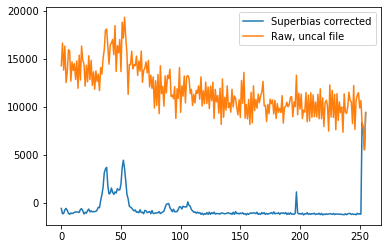

In [8]:
column, group, integration = 1000, 5, 0

print(d_superbias['SCI'].data.shape)
# Extract profile of superbias-ed data:
superbias_profile = d_superbias['SCI'].data[integration, group, :, column]
# Profile of raw, uncalibrated data:
uncal_profile = d['SCI'].data[integration, group, :, column]

# Plot them:
plt.plot(superbias_profile, label = 'Superbias corrected')
plt.plot(uncal_profile, label = 'Raw, uncal file')
plt.legend()

Let's do a little close-up:

(-2000, 1000)

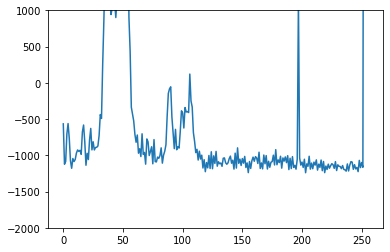

In [9]:
plt.plot(superbias_profile, label = 'Superbias corrected')
plt.ylim(-2000,1000)

OK, so there are three things to note:

1. The superbias corrected frame has a much smoother profile than the raw, `uncal` file. This is expected --- the bias has in fact a lot of structure which is not constant across the detector, but varies widely. Bias-substraction is _super_ important. 

2. We see a slight offset in flux --- flux outside the profile (say, from rows 150 and larger) are not zero, but they have a constant offset with respect to the bias. In theory, offsets will be expected in real data (e.g., background, variations at the group-to-group bias levels). 

3. The pixels in the last few rows go to very large values. This is an actual problem, and can give rise to _big_ problems.

The fix with problem 3 above has to do in this particular case **with a discrepancy between the reference files the simulations and the data reduction is using, actually**: to perform the `SuperBiasStep` correction, the `jwst` pipeline above used a file called `jwst_niriss_superbias_0120.fits` (you can see this in the messages the pipeline leaves after we ran the pipeline) --- this is the **reference file** used to correct for the bias. However, the data simulator, `mirage`, used `jwst_niriss_superbias_0017.fits`: a different reference file. This gives rise to these weird jumps in the "corrected" data.

You can pass difference reference files to the JWST pipeline directly, in fact. Let's repeat this `SuperBiasStep` with the same reference file used to generate the data, i.e., forcing it to be `jwst_niriss_superbias_0017.fits`. Let's call those outputs with a special prefix:

In [10]:
# Define special prefix for our mirage/simulation-consistent reduction:
special_prefix = 'mirage_consistent_'

for dataname in datanames:
    
    # Define name of output file, input file, and reference file to use for superbias correction:
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected.fits'
    input_filename = output_folder+dataname+'_saturationstep.fits'
    reference_superbias = '/Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_superbias_0017.fits'
    
    # Check if step already ran:
    if not os.path.exists(output_filename):
        calwebb_detector1.superbias_step.SuperBiasStep.call(input_filename, \
                                                            output_dir=output_folder, save_results=True, \
                                                            name=special_prefix+'superbiascorrected',\
                                                            override_superbias=reference_superbias)
    else:
        print('\t \t \t >> Superbias step with different reference file detected. Skipping...')

2021-05-02 11:18:14,575 - stpipe.mirage_consistent_superbiascorrected - INFO - SuperBiasStep instance created.
2021-05-02 11:18:16,246 - stpipe.mirage_consistent_superbiascorrected - INFO - Step mirage_consistent_superbiascorrected running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_saturationstep.fits',).
2021-05-02 11:18:16,248 - stpipe.mirage_consistent_superbiascorrected - INFO - Step mirage_consistent_superbiascorrected parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': ''}
2021-05-02 11:18:20,282 - stpipe.mirage_consistent_superbiascorrected - INFO - Using SUPERBIAS reference file /Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_superbias_0017.fits


Let's check the results:

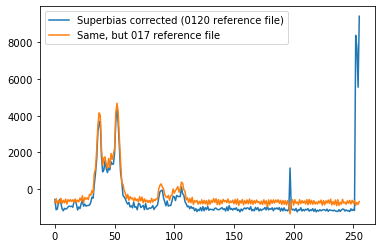

In [11]:
d_superbias2 = fits.open(output_filename)

# Extract profile of refpix-ed data:
superbias_profile2 = d_superbias2['SCI'].data[integration, group, :, column]

# Plot refpix and superbias:
plt.plot(superbias_profile, label = 'Superbias corrected (0120 reference file)')
plt.plot(superbias_profile2, label = 'Same, but 017 reference file')
plt.legend()

Aha! Much smoother, less crazy corrected profile.

The importance of correcting the columns at the very edges (which as you can see above, are significantly reduced in flux) cannot be understated: these are so-called _reference_ pixels, and are used to remove group-to-group detector effects not corrected by the bias step (including, e.g., group-to-group bias changes). Let's run that step next.

### 1.2 The `refpix` step

Let's run the reference pixel step of the pipeline:

In [12]:
for dataname in datanames:
    
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_refpixstep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected.fits'
    
    if not os.path.exists(output_filename):
        calwebb_detector1.refpix_step.RefPixStep.call(input_filename, \
                                                      output_dir=output_folder, \
                                                      save_results=True)
    else:
        print('\t \t \t >> RefPix step outputs detected. Skipping...')

2021-05-02 11:34:12,495 - stpipe.RefPixStep - INFO - RefPixStep instance created.
2021-05-02 11:34:13,759 - stpipe.RefPixStep - INFO - Step RefPixStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected.fits',).
2021-05-02 11:34:13,761 - stpipe.RefPixStep - INFO - Step RefPixStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'odd_even_columns': True, 'use_side_ref_pixels': True, 'side_smoothing_length': 11, 'side_gain': 1.0, 'odd_even_rows': True}
2021-05-02 11:34:17,353 - stpipe.RefPixStep - INFO - use_side_ref_pixels = True
2021-05-02 11:34:17,354 - stpipe.RefPixStep - INFO - odd_even_columns = True
2021-05-02 11:34:17,35

All right, the pipeline run successfully. Let's check the products --- again, checking the last segment only:

In [13]:
d_refpix = fits.open(output_filename)

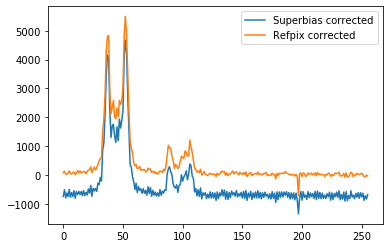

In [14]:
# Extract profile of refpix-ed data:
refpix_profile = d_refpix['SCI'].data[integration, group, :, column]

# Plot refpix and superbias:
plt.plot(superbias_profile2, label = 'Superbias corrected')
plt.plot(refpix_profile, label = 'Refpix corrected')
plt.legend()

Ah --- much better! See how the reference-pixel correction took care of this group-to-group offset of the flux? Now we see _more_ flux outside of the profile which is expected: remember we are dealing with a slitless spectrograph, so we expect _more_ flux outside of the profile indeed. Note how some high-frequency variations have also been removed (albeit not completely, as we'll see later). We'll explain what those are later.

### 1.4 The `linearity` step

Now we go to the `linearity` step --- this step takes care of the non-linearity of the detector by applying a polynomial whose coefficients have been previously obtained through ground calibration. Let's apply this step:

In [15]:
for dataname in datanames:
    
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_linearitystep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_refpixstep.fits'

    if not os.path.exists(output_filename):
        calwebb_detector1.linearity_step.LinearityStep.call(input_filename, \
                                                            output_dir=output_folder, \
                                                            save_results=True)
    else:
        print('\t \t \t >> Linearity step outputs detected. Skipping...')

2021-05-02 11:45:50,168 - stpipe.LinearityStep - INFO - LinearityStep instance created.
2021-05-02 11:45:51,511 - stpipe.LinearityStep - INFO - Step LinearityStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected_refpixstep.fits',).
2021-05-02 11:45:51,513 - stpipe.LinearityStep - INFO - Step LinearityStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': ''}
2021-05-02 11:45:55,295 - stpipe.LinearityStep - INFO - Using Linearity reference file /Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_linearity_0013.fits
2021-05-02 11:45:55,552 - stpipe.LinearityStep - WARNING - Keyword CDP_AVERAGED_COEFFICIENTS does not cor

Let's see the difference:

In [16]:
d_linearity = fits.open(output_filename)

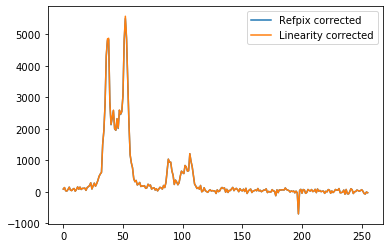

In [17]:
# Extract profile of linearize-ed data:
linearity_profile = d_linearity['SCI'].data[integration, group, :, column]

# Plot refpix and linearity-corrected profiles:
plt.plot(refpix_profile, label = 'Refpix corrected')
plt.plot(linearity_profile, label = 'Linearity corrected')
plt.legend()

Difference is not obvious --- let's substract the values:

Text(0, 0.5, 'Linearity - Refpix')

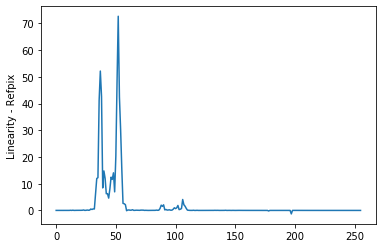

In [18]:
# Plot difference between linearity and refpix products:
plt.plot(linearity_profile - refpix_profile)
plt.ylabel('Linearity - Refpix')

Indeed, differences are small --- moreover, differences are larger where the flux is larger. This makes sense, as the flux deviates from linearity the closer one goes to higher fluences. 

## 1.5 The `darkcurrent` step

The `darkcurrent` step takes care of dark current that might be sneaking into our data. This takes care of the _average_ dark current, and any group-to-group variations (e.g., 1/f noise --- see below) will be left in the data. Let's apply it to our data:

In [19]:
for dataname in datanames:
    
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_darkcurrentstep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_linearitystep.fits'    
    
    if not os.path.exists(output_filename):
        calwebb_detector1.dark_current_step.DarkCurrentStep.call(input_filename, \
                                                                 output_dir=output_folder, \
                                                                 save_results=True)
    else:
        print('\t \t \t >> Dark Current step outputs detected. Skipping...')

2021-05-02 11:55:26,654 - stpipe.DarkCurrentStep - INFO - DarkCurrentStep instance created.
2021-05-02 11:55:27,827 - stpipe.DarkCurrentStep - INFO - Step DarkCurrentStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected_linearitystep.fits',).
2021-05-02 11:55:27,829 - stpipe.DarkCurrentStep - INFO - Step DarkCurrentStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'dark_output': None}
2021-05-02 11:55:31,978 - stpipe.DarkCurrentStep - INFO - Using DARK reference file /Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_dark_0114.fits
2021-05-02 11:55:32,170 - stpipe.DarkCurrentStep - INFO - Science data nints=

The impact is, again, very small, so let's plot the difference between our linearity and dark corrected groups:

In [20]:
d_darkcurrent = fits.open(output_filename)

Text(0, 0.5, 'DarkCurrent - Linearity')

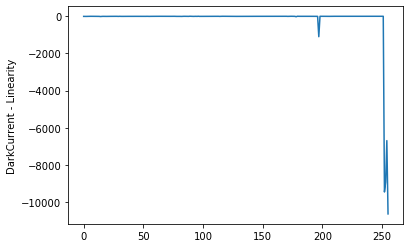

In [21]:
# Extract profile of linearize-ed data:
darkcurrent_profile = d_darkcurrent['SCI'].data[integration, group, :, column]

# Plot refpix and linearity-corrected profiles:
plt.plot(darkcurrent_profile - linearity_profile)
plt.ylabel('DarkCurrent - Linearity')

As can be seen, in general the dark current is _very_ small. There is one pixel which seems to have a particularly large dark current at about row 200 --- and then we see a huge low signal at the edge in the reference pixels. This latter most likely an artifact of the reference files being used (this is very similar to the difference we were seeing above with using the "wrong" superbias).

## 1.6 The `jump` step

[According to the pipeline steps for TSOs](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html#calwebb-detector1), the next step to try would be the `jump` step. This step takes care of outliers (e.g., cosmic rays) in the data but it is too aggressive in simulated data, as the algorithm has not been properly trained yet (we don't have on-sky data!). We apply it below, but set a large threshold of 15 to detect jumps. We note below we set `maximum_cores = 'all'` to run the step in `multiprocessing` mode. This will use _all_ your cores, but will run faster.

In [23]:
tjump0 = time.time()
for dataname in datanames:

    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_jumpstep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_darkcurrentstep.fits'    
    
    
    if not os.path.exists(output_filename):
        calwebb_detector1.jump_step.JumpStep.call(input_filename, \
                                                   output_dir=output_folder, \
                                                   save_results=True, \
                                                   rejection_threshold = 15, \
                                                   maximum_cores = 'all')
    else:
        print('\t \t \t >> Jump step outputs detected. Skipping...')
tjump1 = time.time()

2021-05-02 12:32:52,074 - stpipe.JumpStep - INFO - JumpStep instance created.
2021-05-02 12:32:53,348 - stpipe.JumpStep - INFO - Step JumpStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected_darkcurrentstep.fits',).
2021-05-02 12:32:53,350 - stpipe.JumpStep - INFO - Step JumpStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'rejection_threshold': 15, 'maximum_cores': 'all', 'flag_4_neighbors': True, 'max_jump_to_flag_neighbors': 200.0, 'min_jump_to_flag_neighbors': 10.0}
2021-05-02 12:32:56,548 - stpipe.JumpStep - INFO - CR rejection threshold = 15 sigma
2021-05-02 12:32:56,549 - stpipe.JumpStep - INFO - Maximum cores 

2021-05-02 12:33:09,090 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:33:09,097 - stpipe.JumpStep - INFO -  working on integration 34
2021-05-02 12:33:09,114 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:33:09,122 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:33:09,139 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:33:09,146 - stpipe.JumpStep - INFO -  working on integration 36
2021-05-02 12:33:09,162 - stpipe.JumpStep - INFO - From highest outlier Two point found 56 pixels with at least one CR
2021-05-02 12:33:09,169 - stpipe.JumpStep - INFO -  working on integration 37
2021-05-02 12:33:09,186 - stpipe.JumpStep - INFO - From highest outlier Two point found 55 pixels with at least one CR
2021-05-02 12:33:09,194 - stpipe.JumpStep - INFO -  working on integration 38
2021-05-02 12:3

2021-05-02 12:33:10,128 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:33:10,147 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:33:10,154 - stpipe.JumpStep - INFO -  working on integration 76
2021-05-02 12:33:10,171 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:10,178 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:33:10,196 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:33:10,204 - stpipe.JumpStep - INFO -  working on integration 78
2021-05-02 12:33:10,223 - stpipe.JumpStep - INFO - From highest outlier Two point found 66 pixels with at least one CR
2021-05-02 12:33:10,229 - stpipe.JumpStep - INFO -  working on integration 79
2021-05-02 12:33:10,248 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:11,155 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:33:11,172 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:33:11,180 - stpipe.JumpStep - INFO -  working on integration 118
2021-05-02 12:33:11,196 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:33:11,204 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:33:11,221 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:33:11,228 - stpipe.JumpStep - INFO -  working on integration 120
2021-05-02 12:33:11,247 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:33:11,254 - stpipe.JumpStep - INFO -  working on integration 121
2021-05-02 12:33:11,271 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02

2021-05-02 12:33:12,169 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:33:12,175 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-02 12:33:12,192 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:12,199 - stpipe.JumpStep - INFO -  working on integration 160
2021-05-02 12:33:12,216 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:33:12,225 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-02 12:33:12,242 - stpipe.JumpStep - INFO - From highest outlier Two point found 104 pixels with at least one CR
2021-05-02 12:33:12,251 - stpipe.JumpStep - INFO -  working on integration 162
2021-05-02 12:33:12,268 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:33:12,276 - stpipe.JumpStep - INFO -  working on integration 163
2021-05-0

2021-05-02 12:33:13,195 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:33:13,212 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:33:13,220 - stpipe.JumpStep - INFO -  working on integration 201
2021-05-02 12:33:13,237 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:33:13,245 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:33:13,263 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:33:13,271 - stpipe.JumpStep - INFO -  working on integration 203
2021-05-02 12:33:13,289 - stpipe.JumpStep - INFO - From highest outlier Two point found 63 pixels with at least one CR
2021-05-02 12:33:13,296 - stpipe.JumpStep - INFO -  working on integration 204
2021-05-02 12:33:13,314 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02

2021-05-02 12:33:20,697 - stpipe.JumpStep - INFO -  working on integration 29
2021-05-02 12:33:20,714 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:33:20,722 - stpipe.JumpStep - INFO -  working on integration 30
2021-05-02 12:33:20,738 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:33:20,747 - stpipe.JumpStep - INFO -  working on integration 31
2021-05-02 12:33:20,764 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:33:20,772 - stpipe.JumpStep - INFO -  working on integration 32
2021-05-02 12:33:20,789 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:33:20,796 - stpipe.JumpStep - INFO -  working on integration 33
2021-05-02 12:33:20,815 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:21,737 - stpipe.JumpStep - INFO -  working on integration 71
2021-05-02 12:33:21,754 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:21,763 - stpipe.JumpStep - INFO -  working on integration 72
2021-05-02 12:33:21,779 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:33:21,788 - stpipe.JumpStep - INFO -  working on integration 73
2021-05-02 12:33:21,823 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:33:21,834 - stpipe.JumpStep - INFO -  working on integration 74
2021-05-02 12:33:21,853 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:33:21,861 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:33:21,881 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:22,817 - stpipe.JumpStep - INFO -  working on integration 113
2021-05-02 12:33:22,834 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-02 12:33:22,842 - stpipe.JumpStep - INFO -  working on integration 114
2021-05-02 12:33:22,859 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:33:22,867 - stpipe.JumpStep - INFO -  working on integration 115
2021-05-02 12:33:22,885 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:33:22,893 - stpipe.JumpStep - INFO -  working on integration 116
2021-05-02 12:33:22,911 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:33:22,919 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:33:22,936 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02

2021-05-02 12:33:23,890 - stpipe.JumpStep - INFO - From highest outlier Two point found 116 pixels with at least one CR
2021-05-02 12:33:23,901 - stpipe.JumpStep - INFO -  working on integration 155
2021-05-02 12:33:23,921 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:33:23,930 - stpipe.JumpStep - INFO -  working on integration 156
2021-05-02 12:33:23,948 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:33:23,957 - stpipe.JumpStep - INFO -  working on integration 157
2021-05-02 12:33:23,974 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:33:23,983 - stpipe.JumpStep - INFO -  working on integration 158
2021-05-02 12:33:24,001 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:33:24,009 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-0

2021-05-02 12:33:24,961 - stpipe.JumpStep - INFO -  working on integration 196
2021-05-02 12:33:24,979 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:24,988 - stpipe.JumpStep - INFO -  working on integration 197
2021-05-02 12:33:25,005 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:33:25,014 - stpipe.JumpStep - INFO -  working on integration 198
2021-05-02 12:33:25,032 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:33:25,040 - stpipe.JumpStep - INFO -  working on integration 199
2021-05-02 12:33:25,057 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:33:25,065 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:33:25,083 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02

2021-05-02 12:33:30,764 - stpipe.JumpStep - INFO -  working on integration 25
2021-05-02 12:33:30,782 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:33:30,791 - stpipe.JumpStep - INFO -  working on integration 26
2021-05-02 12:33:30,809 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:33:30,818 - stpipe.JumpStep - INFO -  working on integration 27
2021-05-02 12:33:30,835 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:33:30,845 - stpipe.JumpStep - INFO -  working on integration 28
2021-05-02 12:33:30,865 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:30,874 - stpipe.JumpStep - INFO -  working on integration 29
2021-05-02 12:33:30,892 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:31,928 - stpipe.JumpStep - INFO -  working on integration 67
2021-05-02 12:33:31,946 - stpipe.JumpStep - INFO - From highest outlier Two point found 107 pixels with at least one CR
2021-05-02 12:33:31,956 - stpipe.JumpStep - INFO -  working on integration 68
2021-05-02 12:33:31,975 - stpipe.JumpStep - INFO - From highest outlier Two point found 102 pixels with at least one CR
2021-05-02 12:33:31,985 - stpipe.JumpStep - INFO -  working on integration 69
2021-05-02 12:33:32,003 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:33:32,014 - stpipe.JumpStep - INFO -  working on integration 70
2021-05-02 12:33:32,033 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:33:32,042 - stpipe.JumpStep - INFO -  working on integration 71
2021-05-02 12:33:32,060 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 1

2021-05-02 12:33:33,081 - stpipe.JumpStep - INFO -  working on integration 109
2021-05-02 12:33:33,098 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:33:33,108 - stpipe.JumpStep - INFO -  working on integration 110
2021-05-02 12:33:33,127 - stpipe.JumpStep - INFO - From highest outlier Two point found 114 pixels with at least one CR
2021-05-02 12:33:33,137 - stpipe.JumpStep - INFO -  working on integration 111
2021-05-02 12:33:33,155 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:33:33,164 - stpipe.JumpStep - INFO -  working on integration 112
2021-05-02 12:33:33,182 - stpipe.JumpStep - INFO - From highest outlier Two point found 104 pixels with at least one CR
2021-05-02 12:33:33,192 - stpipe.JumpStep - INFO -  working on integration 113
2021-05-02 12:33:33,210 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-

2021-05-02 12:33:34,232 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:34,241 - stpipe.JumpStep - INFO -  working on integration 151
2021-05-02 12:33:34,260 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:34,269 - stpipe.JumpStep - INFO -  working on integration 152
2021-05-02 12:33:34,287 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:33:34,297 - stpipe.JumpStep - INFO -  working on integration 153
2021-05-02 12:33:34,315 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:33:34,325 - stpipe.JumpStep - INFO -  working on integration 154
2021-05-02 12:33:34,343 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:33:34,352 - stpipe.JumpStep - INFO -  working on integration 155
2021-05-02

2021-05-02 12:33:35,432 - stpipe.JumpStep - INFO -  working on integration 192
2021-05-02 12:33:35,452 - stpipe.JumpStep - INFO - From highest outlier Two point found 108 pixels with at least one CR
2021-05-02 12:33:35,463 - stpipe.JumpStep - INFO -  working on integration 193
2021-05-02 12:33:35,481 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:33:35,491 - stpipe.JumpStep - INFO -  working on integration 194
2021-05-02 12:33:35,509 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:33:35,519 - stpipe.JumpStep - INFO -  working on integration 195
2021-05-02 12:33:35,538 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:33:35,548 - stpipe.JumpStep - INFO -  working on integration 196
2021-05-02 12:33:35,568 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-0

2021-05-02 12:33:42,432 - stpipe.JumpStep - INFO -  working on integration 21
2021-05-02 12:33:42,449 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:42,457 - stpipe.JumpStep - INFO -  working on integration 22
2021-05-02 12:33:42,474 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:33:42,483 - stpipe.JumpStep - INFO -  working on integration 23
2021-05-02 12:33:42,503 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:33:42,512 - stpipe.JumpStep - INFO -  working on integration 24
2021-05-02 12:33:42,529 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:33:42,538 - stpipe.JumpStep - INFO -  working on integration 25
2021-05-02 12:33:42,556 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:33:43,537 - stpipe.JumpStep - INFO -  working on integration 63
2021-05-02 12:33:43,554 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:33:43,562 - stpipe.JumpStep - INFO -  working on integration 64
2021-05-02 12:33:43,579 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:33:43,588 - stpipe.JumpStep - INFO -  working on integration 65
2021-05-02 12:33:43,606 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:43,614 - stpipe.JumpStep - INFO -  working on integration 66
2021-05-02 12:33:43,631 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:33:43,640 - stpipe.JumpStep - INFO -  working on integration 67
2021-05-02 12:33:43,658 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:44,645 - stpipe.JumpStep - INFO -  working on integration 105
2021-05-02 12:33:44,665 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:33:44,673 - stpipe.JumpStep - INFO -  working on integration 106
2021-05-02 12:33:44,690 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:33:44,700 - stpipe.JumpStep - INFO -  working on integration 107
2021-05-02 12:33:44,717 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:44,726 - stpipe.JumpStep - INFO -  working on integration 108
2021-05-02 12:33:44,744 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:33:44,769 - stpipe.JumpStep - INFO -  working on integration 109
2021-05-02 12:33:44,787 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-0

2021-05-02 12:33:45,775 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:33:45,784 - stpipe.JumpStep - INFO -  working on integration 147
2021-05-02 12:33:45,802 - stpipe.JumpStep - INFO - From highest outlier Two point found 117 pixels with at least one CR
2021-05-02 12:33:45,812 - stpipe.JumpStep - INFO -  working on integration 148
2021-05-02 12:33:45,830 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:33:45,839 - stpipe.JumpStep - INFO -  working on integration 149
2021-05-02 12:33:45,858 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:33:45,867 - stpipe.JumpStep - INFO -  working on integration 150
2021-05-02 12:33:45,885 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:33:45,894 - stpipe.JumpStep - INFO -  working on integration 151
2021-05-0

2021-05-02 12:33:46,882 - stpipe.JumpStep - INFO -  working on integration 188
2021-05-02 12:33:46,900 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:33:46,909 - stpipe.JumpStep - INFO -  working on integration 189
2021-05-02 12:33:46,928 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:33:46,938 - stpipe.JumpStep - INFO -  working on integration 190
2021-05-02 12:33:46,956 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:33:46,964 - stpipe.JumpStep - INFO -  working on integration 191
2021-05-02 12:33:46,982 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:33:46,991 - stpipe.JumpStep - INFO -  working on integration 192
2021-05-02 12:33:47,009 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02

2021-05-02 12:33:50,537 - stpipe.JumpStep - INFO -  working on integration 17
2021-05-02 12:33:50,556 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:33:50,565 - stpipe.JumpStep - INFO -  working on integration 18
2021-05-02 12:33:50,585 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:33:50,594 - stpipe.JumpStep - INFO -  working on integration 19
2021-05-02 12:33:50,614 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:33:50,625 - stpipe.JumpStep - INFO -  working on integration 20
2021-05-02 12:33:50,647 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:33:50,656 - stpipe.JumpStep - INFO -  working on integration 21
2021-05-02 12:33:50,680 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:33:51,728 - stpipe.JumpStep - INFO -  working on integration 59
2021-05-02 12:33:51,746 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:33:51,755 - stpipe.JumpStep - INFO -  working on integration 60
2021-05-02 12:33:51,772 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:33:51,781 - stpipe.JumpStep - INFO -  working on integration 61
2021-05-02 12:33:51,799 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:33:51,807 - stpipe.JumpStep - INFO -  working on integration 62
2021-05-02 12:33:51,825 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:33:51,834 - stpipe.JumpStep - INFO -  working on integration 63
2021-05-02 12:33:51,851 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:33:52,865 - stpipe.JumpStep - INFO -  working on integration 101
2021-05-02 12:33:52,883 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:52,892 - stpipe.JumpStep - INFO -  working on integration 102
2021-05-02 12:33:52,911 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:33:52,920 - stpipe.JumpStep - INFO -  working on integration 103
2021-05-02 12:33:52,938 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:33:52,947 - stpipe.JumpStep - INFO -  working on integration 104
2021-05-02 12:33:52,965 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:33:52,975 - stpipe.JumpStep - INFO -  working on integration 105
2021-05-02 12:33:52,993 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02

2021-05-02 12:33:53,994 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:33:54,005 - stpipe.JumpStep - INFO -  working on integration 143
2021-05-02 12:33:54,023 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:33:54,035 - stpipe.JumpStep - INFO -  working on integration 144
2021-05-02 12:33:54,055 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:33:54,064 - stpipe.JumpStep - INFO -  working on integration 145
2021-05-02 12:33:54,082 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:33:54,092 - stpipe.JumpStep - INFO -  working on integration 146
2021-05-02 12:33:54,113 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:33:54,123 - stpipe.JumpStep - INFO -  working on integration 147
2021-05-02

2021-05-02 12:33:55,127 - stpipe.JumpStep - INFO -  working on integration 184
2021-05-02 12:33:55,145 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:33:55,154 - stpipe.JumpStep - INFO -  working on integration 185
2021-05-02 12:33:55,173 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:33:55,182 - stpipe.JumpStep - INFO -  working on integration 186
2021-05-02 12:33:55,200 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:33:55,208 - stpipe.JumpStep - INFO -  working on integration 187
2021-05-02 12:33:55,227 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:33:55,235 - stpipe.JumpStep - INFO -  working on integration 188
2021-05-02 12:33:55,253 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02

2021-05-02 12:34:01,649 - stpipe.JumpStep - INFO -  working on integration 13
2021-05-02 12:34:01,669 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:34:01,677 - stpipe.JumpStep - INFO -  working on integration 14
2021-05-02 12:34:01,696 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:34:01,706 - stpipe.JumpStep - INFO -  working on integration 15
2021-05-02 12:34:01,724 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:01,735 - stpipe.JumpStep - INFO -  working on integration 16
2021-05-02 12:34:01,755 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:34:01,764 - stpipe.JumpStep - INFO -  working on integration 17
2021-05-02 12:34:01,790 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:02,771 - stpipe.JumpStep - INFO -  working on integration 55
2021-05-02 12:34:02,787 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:34:02,796 - stpipe.JumpStep - INFO -  working on integration 56
2021-05-02 12:34:02,813 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:34:02,821 - stpipe.JumpStep - INFO -  working on integration 57
2021-05-02 12:34:02,839 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:34:02,847 - stpipe.JumpStep - INFO -  working on integration 58
2021-05-02 12:34:02,864 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:34:02,873 - stpipe.JumpStep - INFO -  working on integration 59
2021-05-02 12:34:02,890 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:03,877 - stpipe.JumpStep - INFO -  working on integration 97
2021-05-02 12:34:03,894 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:03,902 - stpipe.JumpStep - INFO -  working on integration 98
2021-05-02 12:34:03,920 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:34:03,928 - stpipe.JumpStep - INFO -  working on integration 99
2021-05-02 12:34:03,945 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:34:03,958 - stpipe.JumpStep - INFO -  working on integration 100
2021-05-02 12:34:03,975 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:34:03,985 - stpipe.JumpStep - INFO -  working on integration 101
2021-05-02 12:34:04,002 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12

2021-05-02 12:34:05,022 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:34:05,029 - stpipe.JumpStep - INFO -  working on integration 139
2021-05-02 12:34:05,046 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:05,055 - stpipe.JumpStep - INFO -  working on integration 140
2021-05-02 12:34:05,073 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:34:05,082 - stpipe.JumpStep - INFO -  working on integration 141
2021-05-02 12:34:05,101 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:34:05,109 - stpipe.JumpStep - INFO -  working on integration 142
2021-05-02 12:34:05,128 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:34:05,136 - stpipe.JumpStep - INFO -  working on integration 143
2021-05-02

2021-05-02 12:34:06,134 - stpipe.JumpStep - INFO -  working on integration 180
2021-05-02 12:34:06,152 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:34:06,161 - stpipe.JumpStep - INFO -  working on integration 181
2021-05-02 12:34:06,178 - stpipe.JumpStep - INFO - From highest outlier Two point found 58 pixels with at least one CR
2021-05-02 12:34:06,185 - stpipe.JumpStep - INFO -  working on integration 182
2021-05-02 12:34:06,202 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:06,210 - stpipe.JumpStep - INFO -  working on integration 183
2021-05-02 12:34:06,228 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:06,236 - stpipe.JumpStep - INFO -  working on integration 184
2021-05-02 12:34:06,254 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02

2021-05-02 12:34:12,849 - stpipe.JumpStep - INFO -  working on integration 9
2021-05-02 12:34:12,867 - stpipe.JumpStep - INFO - From highest outlier Two point found 61 pixels with at least one CR
2021-05-02 12:34:12,875 - stpipe.JumpStep - INFO -  working on integration 10
2021-05-02 12:34:12,894 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:34:12,902 - stpipe.JumpStep - INFO -  working on integration 11
2021-05-02 12:34:12,920 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:34:12,929 - stpipe.JumpStep - INFO -  working on integration 12
2021-05-02 12:34:12,947 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:34:12,957 - stpipe.JumpStep - INFO -  working on integration 13
2021-05-02 12:34:12,974 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:34

2021-05-02 12:34:13,978 - stpipe.JumpStep - INFO -  working on integration 51
2021-05-02 12:34:13,996 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:14,004 - stpipe.JumpStep - INFO -  working on integration 52
2021-05-02 12:34:14,021 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:34:14,029 - stpipe.JumpStep - INFO -  working on integration 53
2021-05-02 12:34:14,047 - stpipe.JumpStep - INFO - From highest outlier Two point found 66 pixels with at least one CR
2021-05-02 12:34:14,054 - stpipe.JumpStep - INFO -  working on integration 54
2021-05-02 12:34:14,072 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:14,080 - stpipe.JumpStep - INFO -  working on integration 55
2021-05-02 12:34:14,097 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:34:15,117 - stpipe.JumpStep - INFO -  working on integration 93
2021-05-02 12:34:15,134 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:15,143 - stpipe.JumpStep - INFO -  working on integration 94
2021-05-02 12:34:15,161 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:15,169 - stpipe.JumpStep - INFO -  working on integration 95
2021-05-02 12:34:15,187 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:34:15,196 - stpipe.JumpStep - INFO -  working on integration 96
2021-05-02 12:34:15,214 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:15,222 - stpipe.JumpStep - INFO -  working on integration 97
2021-05-02 12:34:15,241 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:16,247 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:34:16,255 - stpipe.JumpStep - INFO -  working on integration 135
2021-05-02 12:34:16,273 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:34:16,282 - stpipe.JumpStep - INFO -  working on integration 136
2021-05-02 12:34:16,301 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:34:16,310 - stpipe.JumpStep - INFO -  working on integration 137
2021-05-02 12:34:16,328 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:34:16,336 - stpipe.JumpStep - INFO -  working on integration 138
2021-05-02 12:34:16,354 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:34:16,363 - stpipe.JumpStep - INFO -  working on integration 139
2021-05-02

2021-05-02 12:34:17,374 - stpipe.JumpStep - INFO -  working on integration 176
2021-05-02 12:34:17,391 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:34:17,399 - stpipe.JumpStep - INFO -  working on integration 177
2021-05-02 12:34:17,417 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:34:17,425 - stpipe.JumpStep - INFO -  working on integration 178
2021-05-02 12:34:17,444 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:34:17,452 - stpipe.JumpStep - INFO -  working on integration 179
2021-05-02 12:34:17,470 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:34:17,478 - stpipe.JumpStep - INFO -  working on integration 180
2021-05-02 12:34:17,496 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02

2021-05-02 12:34:25,429 - stpipe.JumpStep - INFO -  working on integration 5
2021-05-02 12:34:25,449 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:34:25,456 - stpipe.JumpStep - INFO -  working on integration 6
2021-05-02 12:34:25,477 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:25,484 - stpipe.JumpStep - INFO -  working on integration 7
2021-05-02 12:34:25,503 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:34:25,511 - stpipe.JumpStep - INFO -  working on integration 8
2021-05-02 12:34:25,529 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:25,537 - stpipe.JumpStep - INFO -  working on integration 9
2021-05-02 12:34:25,554 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:34:25,

2021-05-02 12:34:26,510 - stpipe.JumpStep - INFO -  working on integration 47
2021-05-02 12:34:26,528 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:34:26,537 - stpipe.JumpStep - INFO -  working on integration 48
2021-05-02 12:34:26,555 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:34:26,565 - stpipe.JumpStep - INFO -  working on integration 49
2021-05-02 12:34:26,583 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:26,592 - stpipe.JumpStep - INFO -  working on integration 50
2021-05-02 12:34:26,610 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:34:26,618 - stpipe.JumpStep - INFO -  working on integration 51
2021-05-02 12:34:26,638 - stpipe.JumpStep - INFO - From highest outlier Two point found 64 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:27,607 - stpipe.JumpStep - INFO -  working on integration 89
2021-05-02 12:34:27,626 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:34:27,633 - stpipe.JumpStep - INFO -  working on integration 90
2021-05-02 12:34:27,650 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:34:27,657 - stpipe.JumpStep - INFO -  working on integration 91
2021-05-02 12:34:27,675 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:34:27,683 - stpipe.JumpStep - INFO -  working on integration 92
2021-05-02 12:34:27,701 - stpipe.JumpStep - INFO - From highest outlier Two point found 59 pixels with at least one CR
2021-05-02 12:34:27,707 - stpipe.JumpStep - INFO -  working on integration 93
2021-05-02 12:34:27,726 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:28,685 - stpipe.JumpStep - INFO -  working on integration 131
2021-05-02 12:34:28,704 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:34:28,713 - stpipe.JumpStep - INFO -  working on integration 132
2021-05-02 12:34:28,731 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:28,738 - stpipe.JumpStep - INFO -  working on integration 133
2021-05-02 12:34:28,755 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:34:28,763 - stpipe.JumpStep - INFO -  working on integration 134
2021-05-02 12:34:28,780 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:28,788 - stpipe.JumpStep - INFO -  working on integration 135
2021-05-02 12:34:28,805 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02

2021-05-02 12:34:29,765 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:34:29,774 - stpipe.JumpStep - INFO -  working on integration 173
2021-05-02 12:34:29,793 - stpipe.JumpStep - INFO - From highest outlier Two point found 105 pixels with at least one CR
2021-05-02 12:34:29,802 - stpipe.JumpStep - INFO -  working on integration 174
2021-05-02 12:34:29,821 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:34:29,830 - stpipe.JumpStep - INFO -  working on integration 175
2021-05-02 12:34:29,848 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:34:29,857 - stpipe.JumpStep - INFO -  working on integration 176
2021-05-02 12:34:29,878 - stpipe.JumpStep - INFO - From highest outlier Two point found 62 pixels with at least one CR
2021-05-02 12:34:29,886 - stpipe.JumpStep - INFO -  working on integration 177
2021-05-0

2021-05-02 12:34:35,912 - stpipe.JumpStep - INFO -  working on integration 1
2021-05-02 12:34:35,938 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:35,947 - stpipe.JumpStep - INFO -  working on integration 2
2021-05-02 12:34:35,969 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:34:35,977 - stpipe.JumpStep - INFO -  working on integration 3
2021-05-02 12:34:35,997 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:34:36,005 - stpipe.JumpStep - INFO -  working on integration 4
2021-05-02 12:34:36,027 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:34:36,036 - stpipe.JumpStep - INFO -  working on integration 5
2021-05-02 12:34:36,057 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:36,

2021-05-02 12:34:37,039 - stpipe.JumpStep - INFO -  working on integration 43
2021-05-02 12:34:37,057 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:34:37,067 - stpipe.JumpStep - INFO -  working on integration 44
2021-05-02 12:34:37,084 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:34:37,092 - stpipe.JumpStep - INFO -  working on integration 45
2021-05-02 12:34:37,110 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:34:37,118 - stpipe.JumpStep - INFO -  working on integration 46
2021-05-02 12:34:37,135 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:34:37,143 - stpipe.JumpStep - INFO -  working on integration 47
2021-05-02 12:34:37,160 - stpipe.JumpStep - INFO - From highest outlier Two point found 102 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:34:38,139 - stpipe.JumpStep - INFO -  working on integration 85
2021-05-02 12:34:38,156 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:38,164 - stpipe.JumpStep - INFO -  working on integration 86
2021-05-02 12:34:38,181 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:34:38,189 - stpipe.JumpStep - INFO -  working on integration 87
2021-05-02 12:34:38,207 - stpipe.JumpStep - INFO - From highest outlier Two point found 103 pixels with at least one CR
2021-05-02 12:34:38,216 - stpipe.JumpStep - INFO -  working on integration 88
2021-05-02 12:34:38,233 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:34:38,242 - stpipe.JumpStep - INFO -  working on integration 89
2021-05-02 12:34:38,261 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:34:39,217 - stpipe.JumpStep - INFO -  working on integration 127
2021-05-02 12:34:39,235 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:34:39,244 - stpipe.JumpStep - INFO -  working on integration 128
2021-05-02 12:34:39,261 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:34:39,270 - stpipe.JumpStep - INFO -  working on integration 129
2021-05-02 12:34:39,287 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:34:39,295 - stpipe.JumpStep - INFO -  working on integration 130
2021-05-02 12:34:39,312 - stpipe.JumpStep - INFO - From highest outlier Two point found 55 pixels with at least one CR
2021-05-02 12:34:39,319 - stpipe.JumpStep - INFO -  working on integration 131
2021-05-02 12:34:39,336 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02

2021-05-02 12:34:40,280 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:34:40,288 - stpipe.JumpStep - INFO -  working on integration 169
2021-05-02 12:34:40,305 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:34:40,313 - stpipe.JumpStep - INFO -  working on integration 170
2021-05-02 12:34:40,333 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:34:40,341 - stpipe.JumpStep - INFO -  working on integration 171
2021-05-02 12:34:40,359 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:40,367 - stpipe.JumpStep - INFO -  working on integration 172
2021-05-02 12:34:40,385 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:34:40,394 - stpipe.JumpStep - INFO -  working on integration 173
2021-05-0

2021-05-02 12:34:41,364 - stpipe.JumpStep - INFO -  working on integration 210
2021-05-02 12:34:41,381 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:41,389 - stpipe.JumpStep - INFO -  working on integration 211
2021-05-02 12:34:41,407 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:34:41,415 - stpipe.JumpStep - INFO -  working on integration 212
2021-05-02 12:34:41,432 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:34:41,440 - stpipe.JumpStep - INFO -  working on integration 213
2021-05-02 12:34:41,458 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:34:44,897 - stpipe.JumpStep - INFO -  working on integration 1
2021-05-02 12:34:44,925 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 1

2021-05-02 12:34:45,936 - stpipe.JumpStep - INFO -  working on integration 39
2021-05-02 12:34:45,954 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:34:45,963 - stpipe.JumpStep - INFO -  working on integration 40
2021-05-02 12:34:45,980 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:34:45,989 - stpipe.JumpStep - INFO -  working on integration 41
2021-05-02 12:34:46,007 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:34:46,015 - stpipe.JumpStep - INFO -  working on integration 42
2021-05-02 12:34:46,033 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:46,041 - stpipe.JumpStep - INFO -  working on integration 43
2021-05-02 12:34:46,058 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:47,058 - stpipe.JumpStep - INFO -  working on integration 81
2021-05-02 12:34:47,075 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:34:47,083 - stpipe.JumpStep - INFO -  working on integration 82
2021-05-02 12:34:47,100 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:34:47,109 - stpipe.JumpStep - INFO -  working on integration 83
2021-05-02 12:34:47,126 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:34:47,134 - stpipe.JumpStep - INFO -  working on integration 84
2021-05-02 12:34:47,151 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:34:47,160 - stpipe.JumpStep - INFO -  working on integration 85
2021-05-02 12:34:47,180 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:34:48,147 - stpipe.JumpStep - INFO -  working on integration 123
2021-05-02 12:34:48,164 - stpipe.JumpStep - INFO - From highest outlier Two point found 125 pixels with at least one CR
2021-05-02 12:34:48,173 - stpipe.JumpStep - INFO -  working on integration 124
2021-05-02 12:34:48,191 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:34:48,199 - stpipe.JumpStep - INFO -  working on integration 125
2021-05-02 12:34:48,216 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:34:48,225 - stpipe.JumpStep - INFO -  working on integration 126
2021-05-02 12:34:48,243 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:48,251 - stpipe.JumpStep - INFO -  working on integration 127
2021-05-02 12:34:48,269 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-

2021-05-02 12:34:49,265 - stpipe.JumpStep - INFO - From highest outlier Two point found 66 pixels with at least one CR
2021-05-02 12:34:49,272 - stpipe.JumpStep - INFO -  working on integration 165
2021-05-02 12:34:49,289 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:34:49,297 - stpipe.JumpStep - INFO -  working on integration 166
2021-05-02 12:34:49,316 - stpipe.JumpStep - INFO - From highest outlier Two point found 106 pixels with at least one CR
2021-05-02 12:34:49,325 - stpipe.JumpStep - INFO -  working on integration 167
2021-05-02 12:34:49,343 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:34:49,352 - stpipe.JumpStep - INFO -  working on integration 168
2021-05-02 12:34:49,369 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:34:49,378 - stpipe.JumpStep - INFO -  working on integration 169
2021-05-

2021-05-02 12:34:50,358 - stpipe.JumpStep - INFO -  working on integration 206
2021-05-02 12:34:50,376 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:34:50,385 - stpipe.JumpStep - INFO -  working on integration 207
2021-05-02 12:34:50,402 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:34:50,410 - stpipe.JumpStep - INFO -  working on integration 208
2021-05-02 12:34:50,428 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:34:50,436 - stpipe.JumpStep - INFO -  working on integration 209
2021-05-02 12:34:50,453 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:34:50,461 - stpipe.JumpStep - INFO -  working on integration 210
2021-05-02 12:34:50,480 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02

2021-05-02 12:34:55,993 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:34:56,012 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:34:56,021 - stpipe.JumpStep - INFO -  working on integration 36
2021-05-02 12:34:56,039 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:34:56,048 - stpipe.JumpStep - INFO -  working on integration 37
2021-05-02 12:34:56,070 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:34:56,080 - stpipe.JumpStep - INFO -  working on integration 38
2021-05-02 12:34:56,103 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:34:56,113 - stpipe.JumpStep - INFO -  working on integration 39
2021-05-02 12:34:56,135 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:57,207 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:34:57,226 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:34:57,236 - stpipe.JumpStep - INFO -  working on integration 78
2021-05-02 12:34:57,255 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:34:57,264 - stpipe.JumpStep - INFO -  working on integration 79
2021-05-02 12:34:57,284 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:34:57,293 - stpipe.JumpStep - INFO -  working on integration 80
2021-05-02 12:34:57,312 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:34:57,322 - stpipe.JumpStep - INFO -  working on integration 81
2021-05-02 12:34:57,341 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:3

2021-05-02 12:34:58,378 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:34:58,396 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:58,405 - stpipe.JumpStep - INFO -  working on integration 120
2021-05-02 12:34:58,423 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:58,432 - stpipe.JumpStep - INFO -  working on integration 121
2021-05-02 12:34:58,451 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:34:58,460 - stpipe.JumpStep - INFO -  working on integration 122
2021-05-02 12:34:58,479 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:34:58,488 - stpipe.JumpStep - INFO -  working on integration 123
2021-05-02 12:34:58,507 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02

2021-05-02 12:34:59,535 - stpipe.JumpStep - INFO - From highest outlier Two point found 107 pixels with at least one CR
2021-05-02 12:34:59,553 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-02 12:34:59,573 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:34:59,582 - stpipe.JumpStep - INFO -  working on integration 162
2021-05-02 12:34:59,599 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:34:59,608 - stpipe.JumpStep - INFO -  working on integration 163
2021-05-02 12:34:59,626 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:34:59,635 - stpipe.JumpStep - INFO -  working on integration 164
2021-05-02 12:34:59,653 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:34:59,662 - stpipe.JumpStep - INFO -  working on integration 165
2021-05-0

2021-05-02 12:35:00,701 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:35:00,719 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:35:00,727 - stpipe.JumpStep - INFO -  working on integration 203
2021-05-02 12:35:00,747 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:35:00,756 - stpipe.JumpStep - INFO -  working on integration 204
2021-05-02 12:35:00,775 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:35:00,784 - stpipe.JumpStep - INFO -  working on integration 205
2021-05-02 12:35:00,803 - stpipe.JumpStep - INFO - From highest outlier Two point found 106 pixels with at least one CR
2021-05-02 12:35:00,813 - stpipe.JumpStep - INFO -  working on integration 206
2021-05-02 12:35:00,831 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-0

2021-05-02 12:35:25,610 - stpipe.JumpStep - INFO -  working on integration 31
2021-05-02 12:35:25,628 - stpipe.JumpStep - INFO - From highest outlier Two point found 106 pixels with at least one CR
2021-05-02 12:35:25,636 - stpipe.JumpStep - INFO -  working on integration 32
2021-05-02 12:35:25,654 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:35:25,662 - stpipe.JumpStep - INFO -  working on integration 33
2021-05-02 12:35:25,680 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:35:25,688 - stpipe.JumpStep - INFO -  working on integration 34
2021-05-02 12:35:25,707 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:35:25,715 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:35:25,734 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:35:26,723 - stpipe.JumpStep - INFO -  working on integration 73
2021-05-02 12:35:26,742 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:35:26,749 - stpipe.JumpStep - INFO -  working on integration 74
2021-05-02 12:35:26,768 - stpipe.JumpStep - INFO - From highest outlier Two point found 108 pixels with at least one CR
2021-05-02 12:35:26,777 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:35:26,799 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:35:26,807 - stpipe.JumpStep - INFO -  working on integration 76
2021-05-02 12:35:26,825 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:35:26,833 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:35:26,851 - stpipe.JumpStep - INFO - From highest outlier Two point found 117 pixels with at least one CR
2021-05-02 12

2021-05-02 12:35:27,848 - stpipe.JumpStep - INFO -  working on integration 115
2021-05-02 12:35:27,866 - stpipe.JumpStep - INFO - From highest outlier Two point found 111 pixels with at least one CR
2021-05-02 12:35:27,875 - stpipe.JumpStep - INFO -  working on integration 116
2021-05-02 12:35:27,895 - stpipe.JumpStep - INFO - From highest outlier Two point found 120 pixels with at least one CR
2021-05-02 12:35:27,904 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:35:27,922 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:35:27,931 - stpipe.JumpStep - INFO -  working on integration 118
2021-05-02 12:35:27,950 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:35:27,959 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:35:27,977 - stpipe.JumpStep - INFO - From highest outlier Two point found 118 pixels with at least one CR
2021-0

2021-05-02 12:35:28,968 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:35:28,975 - stpipe.JumpStep - INFO -  working on integration 157
2021-05-02 12:35:28,995 - stpipe.JumpStep - INFO - From highest outlier Two point found 102 pixels with at least one CR
2021-05-02 12:35:29,003 - stpipe.JumpStep - INFO -  working on integration 158
2021-05-02 12:35:29,025 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:35:29,037 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-02 12:35:29,064 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:35:29,074 - stpipe.JumpStep - INFO -  working on integration 160
2021-05-02 12:35:29,093 - stpipe.JumpStep - INFO - From highest outlier Two point found 114 pixels with at least one CR
2021-05-02 12:35:29,101 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-

2021-05-02 12:35:30,084 - stpipe.JumpStep - INFO -  working on integration 198
2021-05-02 12:35:30,103 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:35:30,111 - stpipe.JumpStep - INFO -  working on integration 199
2021-05-02 12:35:30,130 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:35:30,138 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:35:30,156 - stpipe.JumpStep - INFO - From highest outlier Two point found 111 pixels with at least one CR
2021-05-02 12:35:30,165 - stpipe.JumpStep - INFO -  working on integration 201
2021-05-02 12:35:30,183 - stpipe.JumpStep - INFO - From highest outlier Two point found 113 pixels with at least one CR
2021-05-02 12:35:30,191 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:35:30,212 - stpipe.JumpStep - INFO - From highest outlier Two point found 109 pixels with at least one CR
2021-05

2021-05-02 12:46:03,694 - stpipe.JumpStep - INFO -  working on integration 15
2021-05-02 12:46:03,711 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:03,720 - stpipe.JumpStep - INFO -  working on integration 16
2021-05-02 12:46:03,738 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:46:03,744 - stpipe.JumpStep - INFO -  working on integration 17
2021-05-02 12:46:03,768 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:46:03,775 - stpipe.JumpStep - INFO -  working on integration 18
2021-05-02 12:46:03,792 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:46:03,799 - stpipe.JumpStep - INFO -  working on integration 19
2021-05-02 12:46:03,817 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:04,873 - stpipe.JumpStep - INFO -  working on integration 57
2021-05-02 12:46:04,889 - stpipe.JumpStep - INFO - From highest outlier Two point found 102 pixels with at least one CR
2021-05-02 12:46:04,898 - stpipe.JumpStep - INFO -  working on integration 58
2021-05-02 12:46:04,916 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:46:04,924 - stpipe.JumpStep - INFO -  working on integration 59
2021-05-02 12:46:04,942 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:46:04,949 - stpipe.JumpStep - INFO -  working on integration 60
2021-05-02 12:46:04,967 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:04,975 - stpipe.JumpStep - INFO -  working on integration 61
2021-05-02 12:46:04,993 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:05,956 - stpipe.JumpStep - INFO -  working on integration 99
2021-05-02 12:46:05,975 - stpipe.JumpStep - INFO - From highest outlier Two point found 64 pixels with at least one CR
2021-05-02 12:46:05,982 - stpipe.JumpStep - INFO -  working on integration 100
2021-05-02 12:46:06,001 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:46:06,008 - stpipe.JumpStep - INFO -  working on integration 101
2021-05-02 12:46:06,027 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:46:06,035 - stpipe.JumpStep - INFO -  working on integration 102
2021-05-02 12:46:06,053 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:46:06,060 - stpipe.JumpStep - INFO -  working on integration 103
2021-05-02 12:46:06,078 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 

2021-05-02 12:46:07,015 - stpipe.JumpStep - INFO - From highest outlier Two point found 63 pixels with at least one CR
2021-05-02 12:46:07,022 - stpipe.JumpStep - INFO -  working on integration 141
2021-05-02 12:46:07,039 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:46:07,046 - stpipe.JumpStep - INFO -  working on integration 142
2021-05-02 12:46:07,062 - stpipe.JumpStep - INFO - From highest outlier Two point found 66 pixels with at least one CR
2021-05-02 12:46:07,069 - stpipe.JumpStep - INFO -  working on integration 143
2021-05-02 12:46:07,086 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:46:07,093 - stpipe.JumpStep - INFO -  working on integration 144
2021-05-02 12:46:07,109 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:46:07,117 - stpipe.JumpStep - INFO -  working on integration 145
2021-05-02

2021-05-02 12:46:08,029 - stpipe.JumpStep - INFO -  working on integration 182
2021-05-02 12:46:08,046 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:46:08,053 - stpipe.JumpStep - INFO -  working on integration 183
2021-05-02 12:46:08,071 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:46:08,079 - stpipe.JumpStep - INFO -  working on integration 184
2021-05-02 12:46:08,096 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:08,104 - stpipe.JumpStep - INFO -  working on integration 185
2021-05-02 12:46:08,121 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:46:08,128 - stpipe.JumpStep - INFO -  working on integration 186
2021-05-02 12:46:08,145 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02

2021-05-02 12:46:12,268 - stpipe.JumpStep - INFO -  working on integration 17
2021-05-02 12:46:12,286 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:12,294 - stpipe.JumpStep - INFO -  working on integration 18
2021-05-02 12:46:12,313 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:46:12,321 - stpipe.JumpStep - INFO -  working on integration 19
2021-05-02 12:46:12,340 - stpipe.JumpStep - INFO - From highest outlier Two point found 56 pixels with at least one CR
2021-05-02 12:46:12,347 - stpipe.JumpStep - INFO -  working on integration 20
2021-05-02 12:46:12,367 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:46:12,375 - stpipe.JumpStep - INFO -  working on integration 21
2021-05-02 12:46:12,395 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:13,348 - stpipe.JumpStep - INFO -  working on integration 59
2021-05-02 12:46:13,366 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:46:13,375 - stpipe.JumpStep - INFO -  working on integration 60
2021-05-02 12:46:13,392 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:46:13,400 - stpipe.JumpStep - INFO -  working on integration 61
2021-05-02 12:46:13,417 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:46:13,425 - stpipe.JumpStep - INFO -  working on integration 62
2021-05-02 12:46:13,443 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:46:13,451 - stpipe.JumpStep - INFO -  working on integration 63
2021-05-02 12:46:13,470 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:14,493 - stpipe.JumpStep - INFO -  working on integration 101
2021-05-02 12:46:14,511 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:46:14,519 - stpipe.JumpStep - INFO -  working on integration 102
2021-05-02 12:46:14,537 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:46:14,545 - stpipe.JumpStep - INFO -  working on integration 103
2021-05-02 12:46:14,564 - stpipe.JumpStep - INFO - From highest outlier Two point found 62 pixels with at least one CR
2021-05-02 12:46:14,571 - stpipe.JumpStep - INFO -  working on integration 104
2021-05-02 12:46:14,588 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:46:14,595 - stpipe.JumpStep - INFO -  working on integration 105
2021-05-02 12:46:14,613 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02

2021-05-02 12:46:15,564 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:46:15,571 - stpipe.JumpStep - INFO -  working on integration 143
2021-05-02 12:46:15,587 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:46:15,595 - stpipe.JumpStep - INFO -  working on integration 144
2021-05-02 12:46:15,614 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:15,621 - stpipe.JumpStep - INFO -  working on integration 145
2021-05-02 12:46:15,639 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:46:15,646 - stpipe.JumpStep - INFO -  working on integration 146
2021-05-02 12:46:15,664 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:46:15,672 - stpipe.JumpStep - INFO -  working on integration 147
2021-05-02

2021-05-02 12:46:16,623 - stpipe.JumpStep - INFO -  working on integration 184
2021-05-02 12:46:16,641 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:46:16,648 - stpipe.JumpStep - INFO -  working on integration 185
2021-05-02 12:46:16,666 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:16,674 - stpipe.JumpStep - INFO -  working on integration 186
2021-05-02 12:46:16,692 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:46:16,700 - stpipe.JumpStep - INFO -  working on integration 187
2021-05-02 12:46:16,718 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:16,726 - stpipe.JumpStep - INFO -  working on integration 188
2021-05-02 12:46:16,745 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02

2021-05-02 12:46:22,835 - stpipe.JumpStep - INFO -  working on integration 19
2021-05-02 12:46:22,853 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:22,862 - stpipe.JumpStep - INFO -  working on integration 20
2021-05-02 12:46:22,879 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:46:22,888 - stpipe.JumpStep - INFO -  working on integration 21
2021-05-02 12:46:22,906 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:46:22,914 - stpipe.JumpStep - INFO -  working on integration 22
2021-05-02 12:46:22,934 - stpipe.JumpStep - INFO - From highest outlier Two point found 107 pixels with at least one CR
2021-05-02 12:46:22,943 - stpipe.JumpStep - INFO -  working on integration 23
2021-05-02 12:46:22,960 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:23,942 - stpipe.JumpStep - INFO -  working on integration 61
2021-05-02 12:46:23,961 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:46:23,970 - stpipe.JumpStep - INFO -  working on integration 62
2021-05-02 12:46:23,987 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:46:23,996 - stpipe.JumpStep - INFO -  working on integration 63
2021-05-02 12:46:24,015 - stpipe.JumpStep - INFO - From highest outlier Two point found 116 pixels with at least one CR
2021-05-02 12:46:24,025 - stpipe.JumpStep - INFO -  working on integration 64
2021-05-02 12:46:24,042 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:46:24,051 - stpipe.JumpStep - INFO -  working on integration 65
2021-05-02 12:46:24,069 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:25,202 - stpipe.JumpStep - INFO -  working on integration 103
2021-05-02 12:46:25,223 - stpipe.JumpStep - INFO - From highest outlier Two point found 105 pixels with at least one CR
2021-05-02 12:46:25,235 - stpipe.JumpStep - INFO -  working on integration 104
2021-05-02 12:46:25,253 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:46:25,265 - stpipe.JumpStep - INFO -  working on integration 105
2021-05-02 12:46:25,284 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:46:25,294 - stpipe.JumpStep - INFO -  working on integration 106
2021-05-02 12:46:25,312 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:46:25,322 - stpipe.JumpStep - INFO -  working on integration 107
2021-05-02 12:46:25,343 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05

2021-05-02 12:46:26,360 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:46:26,369 - stpipe.JumpStep - INFO -  working on integration 145
2021-05-02 12:46:26,388 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:46:26,398 - stpipe.JumpStep - INFO -  working on integration 146
2021-05-02 12:46:26,416 - stpipe.JumpStep - INFO - From highest outlier Two point found 104 pixels with at least one CR
2021-05-02 12:46:26,425 - stpipe.JumpStep - INFO -  working on integration 147
2021-05-02 12:46:26,443 - stpipe.JumpStep - INFO - From highest outlier Two point found 109 pixels with at least one CR
2021-05-02 12:46:26,452 - stpipe.JumpStep - INFO -  working on integration 148
2021-05-02 12:46:26,470 - stpipe.JumpStep - INFO - From highest outlier Two point found 108 pixels with at least one CR
2021-05-02 12:46:26,479 - stpipe.JumpStep - INFO -  working on integration 149
2021-

2021-05-02 12:46:27,460 - stpipe.JumpStep - INFO -  working on integration 186
2021-05-02 12:46:27,477 - stpipe.JumpStep - INFO - From highest outlier Two point found 110 pixels with at least one CR
2021-05-02 12:46:27,486 - stpipe.JumpStep - INFO -  working on integration 187
2021-05-02 12:46:27,503 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:46:27,512 - stpipe.JumpStep - INFO -  working on integration 188
2021-05-02 12:46:27,531 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:46:27,539 - stpipe.JumpStep - INFO -  working on integration 189
2021-05-02 12:46:27,556 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:46:27,564 - stpipe.JumpStep - INFO -  working on integration 190
2021-05-02 12:46:27,581 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-

2021-05-02 12:46:30,350 - stpipe.JumpStep - INFO -  working on integration 21
2021-05-02 12:46:30,368 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:46:30,376 - stpipe.JumpStep - INFO -  working on integration 22
2021-05-02 12:46:30,393 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:46:30,402 - stpipe.JumpStep - INFO -  working on integration 23
2021-05-02 12:46:30,421 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:46:30,429 - stpipe.JumpStep - INFO -  working on integration 24
2021-05-02 12:46:30,448 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:46:30,456 - stpipe.JumpStep - INFO -  working on integration 25
2021-05-02 12:46:30,473 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:31,485 - stpipe.JumpStep - INFO -  working on integration 63
2021-05-02 12:46:31,503 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:46:31,513 - stpipe.JumpStep - INFO -  working on integration 64
2021-05-02 12:46:31,532 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:46:31,541 - stpipe.JumpStep - INFO -  working on integration 65
2021-05-02 12:46:31,559 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:31,568 - stpipe.JumpStep - INFO -  working on integration 66
2021-05-02 12:46:31,586 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:46:31,594 - stpipe.JumpStep - INFO -  working on integration 67
2021-05-02 12:46:31,613 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:32,667 - stpipe.JumpStep - INFO -  working on integration 105
2021-05-02 12:46:32,684 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:46:32,694 - stpipe.JumpStep - INFO -  working on integration 106
2021-05-02 12:46:32,712 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-02 12:46:32,720 - stpipe.JumpStep - INFO -  working on integration 107
2021-05-02 12:46:32,739 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:32,749 - stpipe.JumpStep - INFO -  working on integration 108
2021-05-02 12:46:32,768 - stpipe.JumpStep - INFO - From highest outlier Two point found 94 pixels with at least one CR
2021-05-02 12:46:32,777 - stpipe.JumpStep - INFO -  working on integration 109
2021-05-02 12:46:32,795 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02

2021-05-02 12:46:33,815 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:46:33,824 - stpipe.JumpStep - INFO -  working on integration 147
2021-05-02 12:46:33,843 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:46:33,852 - stpipe.JumpStep - INFO -  working on integration 148
2021-05-02 12:46:33,870 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:33,880 - stpipe.JumpStep - INFO -  working on integration 149
2021-05-02 12:46:33,897 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:46:33,906 - stpipe.JumpStep - INFO -  working on integration 150
2021-05-02 12:46:33,924 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:46:33,934 - stpipe.JumpStep - INFO -  working on integration 151
2021-05-02

2021-05-02 12:46:34,957 - stpipe.JumpStep - INFO -  working on integration 188
2021-05-02 12:46:34,977 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:46:34,985 - stpipe.JumpStep - INFO -  working on integration 189
2021-05-02 12:46:35,005 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:46:35,014 - stpipe.JumpStep - INFO -  working on integration 190
2021-05-02 12:46:35,032 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:46:35,041 - stpipe.JumpStep - INFO -  working on integration 191
2021-05-02 12:46:35,059 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:46:35,068 - stpipe.JumpStep - INFO -  working on integration 192
2021-05-02 12:46:35,088 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02

2021-05-02 12:46:40,324 - stpipe.JumpStep - INFO -  working on integration 23
2021-05-02 12:46:40,343 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:46:40,352 - stpipe.JumpStep - INFO -  working on integration 24
2021-05-02 12:46:40,370 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:46:40,378 - stpipe.JumpStep - INFO -  working on integration 25
2021-05-02 12:46:40,395 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:46:40,403 - stpipe.JumpStep - INFO -  working on integration 26
2021-05-02 12:46:40,421 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:46:40,430 - stpipe.JumpStep - INFO -  working on integration 27
2021-05-02 12:46:40,448 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:41,477 - stpipe.JumpStep - INFO -  working on integration 65
2021-05-02 12:46:41,494 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:46:41,503 - stpipe.JumpStep - INFO -  working on integration 66
2021-05-02 12:46:41,521 - stpipe.JumpStep - INFO - From highest outlier Two point found 109 pixels with at least one CR
2021-05-02 12:46:41,531 - stpipe.JumpStep - INFO -  working on integration 67
2021-05-02 12:46:41,548 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:46:41,557 - stpipe.JumpStep - INFO -  working on integration 68
2021-05-02 12:46:41,575 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:41,584 - stpipe.JumpStep - INFO -  working on integration 69
2021-05-02 12:46:41,602 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:46:42,619 - stpipe.JumpStep - INFO -  working on integration 107
2021-05-02 12:46:42,638 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:42,648 - stpipe.JumpStep - INFO -  working on integration 108
2021-05-02 12:46:42,668 - stpipe.JumpStep - INFO - From highest outlier Two point found 61 pixels with at least one CR
2021-05-02 12:46:42,675 - stpipe.JumpStep - INFO -  working on integration 109
2021-05-02 12:46:42,694 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:46:42,703 - stpipe.JumpStep - INFO -  working on integration 110
2021-05-02 12:46:42,722 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:46:42,730 - stpipe.JumpStep - INFO -  working on integration 111
2021-05-02 12:46:42,748 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02

2021-05-02 12:46:43,760 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:46:43,770 - stpipe.JumpStep - INFO -  working on integration 149
2021-05-02 12:46:43,788 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:46:43,798 - stpipe.JumpStep - INFO -  working on integration 150
2021-05-02 12:46:43,816 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:46:43,826 - stpipe.JumpStep - INFO -  working on integration 151
2021-05-02 12:46:43,845 - stpipe.JumpStep - INFO - From highest outlier Two point found 66 pixels with at least one CR
2021-05-02 12:46:43,853 - stpipe.JumpStep - INFO -  working on integration 152
2021-05-02 12:46:43,872 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:43,881 - stpipe.JumpStep - INFO -  working on integration 153
2021-05-02

2021-05-02 12:46:44,921 - stpipe.JumpStep - INFO -  working on integration 190
2021-05-02 12:46:44,940 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:46:44,949 - stpipe.JumpStep - INFO -  working on integration 191
2021-05-02 12:46:44,968 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:44,977 - stpipe.JumpStep - INFO -  working on integration 192
2021-05-02 12:46:44,997 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:46:45,005 - stpipe.JumpStep - INFO -  working on integration 193
2021-05-02 12:46:45,024 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:46:45,033 - stpipe.JumpStep - INFO -  working on integration 194
2021-05-02 12:46:45,051 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02

2021-05-02 12:46:52,493 - stpipe.JumpStep - INFO -  working on integration 25
2021-05-02 12:46:52,511 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:46:52,519 - stpipe.JumpStep - INFO -  working on integration 26
2021-05-02 12:46:52,537 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:46:52,546 - stpipe.JumpStep - INFO -  working on integration 27
2021-05-02 12:46:52,563 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:46:52,572 - stpipe.JumpStep - INFO -  working on integration 28
2021-05-02 12:46:52,589 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:52,598 - stpipe.JumpStep - INFO -  working on integration 29
2021-05-02 12:46:52,617 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:53,612 - stpipe.JumpStep - INFO -  working on integration 67
2021-05-02 12:46:53,631 - stpipe.JumpStep - INFO - From highest outlier Two point found 62 pixels with at least one CR
2021-05-02 12:46:53,638 - stpipe.JumpStep - INFO -  working on integration 68
2021-05-02 12:46:53,658 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:46:53,666 - stpipe.JumpStep - INFO -  working on integration 69
2021-05-02 12:46:53,683 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:46:53,691 - stpipe.JumpStep - INFO -  working on integration 70
2021-05-02 12:46:53,709 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:46:53,718 - stpipe.JumpStep - INFO -  working on integration 71
2021-05-02 12:46:53,736 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:46:54,743 - stpipe.JumpStep - INFO -  working on integration 109
2021-05-02 12:46:54,761 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:46:54,770 - stpipe.JumpStep - INFO -  working on integration 110
2021-05-02 12:46:54,788 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:54,796 - stpipe.JumpStep - INFO -  working on integration 111
2021-05-02 12:46:54,813 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:46:54,822 - stpipe.JumpStep - INFO -  working on integration 112
2021-05-02 12:46:54,842 - stpipe.JumpStep - INFO - From highest outlier Two point found 120 pixels with at least one CR
2021-05-02 12:46:54,852 - stpipe.JumpStep - INFO -  working on integration 113
2021-05-02 12:46:54,871 - stpipe.JumpStep - INFO - From highest outlier Two point found 106 pixels with at least one CR
2021-05-

2021-05-02 12:46:55,877 - stpipe.JumpStep - INFO - From highest outlier Two point found 109 pixels with at least one CR
2021-05-02 12:46:55,887 - stpipe.JumpStep - INFO -  working on integration 151
2021-05-02 12:46:55,905 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:46:55,914 - stpipe.JumpStep - INFO -  working on integration 152
2021-05-02 12:46:55,932 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:46:55,941 - stpipe.JumpStep - INFO -  working on integration 153
2021-05-02 12:46:55,958 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:46:55,968 - stpipe.JumpStep - INFO -  working on integration 154
2021-05-02 12:46:55,986 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:46:55,995 - stpipe.JumpStep - INFO -  working on integration 155
2021-05-0

2021-05-02 12:46:56,999 - stpipe.JumpStep - INFO -  working on integration 192
2021-05-02 12:46:57,018 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:46:57,026 - stpipe.JumpStep - INFO -  working on integration 193
2021-05-02 12:46:57,044 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:46:57,052 - stpipe.JumpStep - INFO -  working on integration 194
2021-05-02 12:46:57,070 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:46:57,078 - stpipe.JumpStep - INFO -  working on integration 195
2021-05-02 12:46:57,096 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:46:57,105 - stpipe.JumpStep - INFO -  working on integration 196
2021-05-02 12:46:57,122 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02

2021-05-02 12:46:59,554 - stpipe.JumpStep - INFO -  working on integration 27
2021-05-02 12:46:59,575 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:46:59,584 - stpipe.JumpStep - INFO -  working on integration 28
2021-05-02 12:46:59,603 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:46:59,612 - stpipe.JumpStep - INFO -  working on integration 29
2021-05-02 12:46:59,631 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:46:59,640 - stpipe.JumpStep - INFO -  working on integration 30
2021-05-02 12:46:59,660 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-02 12:46:59,668 - stpipe.JumpStep - INFO -  working on integration 31
2021-05-02 12:46:59,687 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:47:00,744 - stpipe.JumpStep - INFO -  working on integration 69
2021-05-02 12:47:00,766 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:00,775 - stpipe.JumpStep - INFO -  working on integration 70
2021-05-02 12:47:00,793 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:47:00,801 - stpipe.JumpStep - INFO -  working on integration 71
2021-05-02 12:47:00,820 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:00,829 - stpipe.JumpStep - INFO -  working on integration 72
2021-05-02 12:47:00,848 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:47:00,857 - stpipe.JumpStep - INFO -  working on integration 73
2021-05-02 12:47:00,876 - stpipe.JumpStep - INFO - From highest outlier Two point found 111 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:47:01,902 - stpipe.JumpStep - INFO -  working on integration 111
2021-05-02 12:47:01,921 - stpipe.JumpStep - INFO - From highest outlier Two point found 104 pixels with at least one CR
2021-05-02 12:47:01,931 - stpipe.JumpStep - INFO -  working on integration 112
2021-05-02 12:47:01,950 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:47:01,958 - stpipe.JumpStep - INFO -  working on integration 113
2021-05-02 12:47:01,976 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:47:01,986 - stpipe.JumpStep - INFO -  working on integration 114
2021-05-02 12:47:02,005 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:47:02,015 - stpipe.JumpStep - INFO -  working on integration 115
2021-05-02 12:47:02,034 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-0

2021-05-02 12:47:03,063 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:03,072 - stpipe.JumpStep - INFO -  working on integration 153
2021-05-02 12:47:03,090 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:47:03,099 - stpipe.JumpStep - INFO -  working on integration 154
2021-05-02 12:47:03,119 - stpipe.JumpStep - INFO - From highest outlier Two point found 98 pixels with at least one CR
2021-05-02 12:47:03,129 - stpipe.JumpStep - INFO -  working on integration 155
2021-05-02 12:47:03,147 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:47:03,155 - stpipe.JumpStep - INFO -  working on integration 156
2021-05-02 12:47:03,174 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:03,182 - stpipe.JumpStep - INFO -  working on integration 157
2021-05-02

2021-05-02 12:47:04,201 - stpipe.JumpStep - INFO -  working on integration 194
2021-05-02 12:47:04,219 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:47:04,228 - stpipe.JumpStep - INFO -  working on integration 195
2021-05-02 12:47:04,247 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:04,255 - stpipe.JumpStep - INFO -  working on integration 196
2021-05-02 12:47:04,273 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:47:04,282 - stpipe.JumpStep - INFO -  working on integration 197
2021-05-02 12:47:04,300 - stpipe.JumpStep - INFO - From highest outlier Two point found 103 pixels with at least one CR
2021-05-02 12:47:04,309 - stpipe.JumpStep - INFO -  working on integration 198
2021-05-02 12:47:04,328 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-0

2021-05-02 12:47:10,161 - stpipe.JumpStep - INFO -  working on integration 29
2021-05-02 12:47:10,178 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:47:10,187 - stpipe.JumpStep - INFO -  working on integration 30
2021-05-02 12:47:10,205 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:10,213 - stpipe.JumpStep - INFO -  working on integration 31
2021-05-02 12:47:10,230 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:10,239 - stpipe.JumpStep - INFO -  working on integration 32
2021-05-02 12:47:10,256 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:47:10,263 - stpipe.JumpStep - INFO -  working on integration 33
2021-05-02 12:47:10,281 - stpipe.JumpStep - INFO - From highest outlier Two point found 70 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:47:11,254 - stpipe.JumpStep - INFO -  working on integration 71
2021-05-02 12:47:11,273 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:47:11,281 - stpipe.JumpStep - INFO -  working on integration 72
2021-05-02 12:47:11,300 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:47:11,309 - stpipe.JumpStep - INFO -  working on integration 73
2021-05-02 12:47:11,329 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:47:11,338 - stpipe.JumpStep - INFO -  working on integration 74
2021-05-02 12:47:11,356 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:47:11,365 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:47:11,384 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:47:12,384 - stpipe.JumpStep - INFO -  working on integration 113
2021-05-02 12:47:12,403 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:12,412 - stpipe.JumpStep - INFO -  working on integration 114
2021-05-02 12:47:12,430 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:12,440 - stpipe.JumpStep - INFO -  working on integration 115
2021-05-02 12:47:12,457 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-02 12:47:12,465 - stpipe.JumpStep - INFO -  working on integration 116
2021-05-02 12:47:12,485 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:47:12,492 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:47:12,511 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02

2021-05-02 12:47:13,512 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:13,520 - stpipe.JumpStep - INFO -  working on integration 155
2021-05-02 12:47:13,538 - stpipe.JumpStep - INFO - From highest outlier Two point found 110 pixels with at least one CR
2021-05-02 12:47:13,548 - stpipe.JumpStep - INFO -  working on integration 156
2021-05-02 12:47:13,567 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:13,576 - stpipe.JumpStep - INFO -  working on integration 157
2021-05-02 12:47:13,594 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:47:13,604 - stpipe.JumpStep - INFO -  working on integration 158
2021-05-02 12:47:13,623 - stpipe.JumpStep - INFO - From highest outlier Two point found 62 pixels with at least one CR
2021-05-02 12:47:13,631 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-0

2021-05-02 12:47:14,627 - stpipe.JumpStep - INFO -  working on integration 196
2021-05-02 12:47:14,646 - stpipe.JumpStep - INFO - From highest outlier Two point found 97 pixels with at least one CR
2021-05-02 12:47:14,655 - stpipe.JumpStep - INFO -  working on integration 197
2021-05-02 12:47:14,673 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:14,682 - stpipe.JumpStep - INFO -  working on integration 198
2021-05-02 12:47:14,701 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:47:14,710 - stpipe.JumpStep - INFO -  working on integration 199
2021-05-02 12:47:14,727 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:14,736 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:47:14,754 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02

2021-05-02 12:47:17,923 - stpipe.JumpStep - INFO -  working on integration 31
2021-05-02 12:47:17,941 - stpipe.JumpStep - INFO - From highest outlier Two point found 73 pixels with at least one CR
2021-05-02 12:47:17,949 - stpipe.JumpStep - INFO -  working on integration 32
2021-05-02 12:47:17,967 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:47:17,975 - stpipe.JumpStep - INFO -  working on integration 33
2021-05-02 12:47:17,992 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:47:18,005 - stpipe.JumpStep - INFO -  working on integration 34
2021-05-02 12:47:18,023 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:18,031 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:47:18,048 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:47:19,077 - stpipe.JumpStep - INFO -  working on integration 73
2021-05-02 12:47:19,095 - stpipe.JumpStep - INFO - From highest outlier Two point found 59 pixels with at least one CR
2021-05-02 12:47:19,102 - stpipe.JumpStep - INFO -  working on integration 74
2021-05-02 12:47:19,121 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:47:19,130 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:47:19,148 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:47:19,156 - stpipe.JumpStep - INFO -  working on integration 76
2021-05-02 12:47:19,174 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:19,183 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:47:19,200 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:47:20,191 - stpipe.JumpStep - INFO -  working on integration 115
2021-05-02 12:47:20,210 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:47:20,218 - stpipe.JumpStep - INFO -  working on integration 116
2021-05-02 12:47:20,236 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:20,245 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:47:20,263 - stpipe.JumpStep - INFO - From highest outlier Two point found 56 pixels with at least one CR
2021-05-02 12:47:20,270 - stpipe.JumpStep - INFO -  working on integration 118
2021-05-02 12:47:20,290 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:47:20,299 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:47:20,317 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02

2021-05-02 12:47:21,312 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:21,321 - stpipe.JumpStep - INFO -  working on integration 157
2021-05-02 12:47:21,339 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:47:21,349 - stpipe.JumpStep - INFO -  working on integration 158
2021-05-02 12:47:21,369 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:21,376 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-02 12:47:21,393 - stpipe.JumpStep - INFO - From highest outlier Two point found 61 pixels with at least one CR
2021-05-02 12:47:21,400 - stpipe.JumpStep - INFO -  working on integration 160
2021-05-02 12:47:21,418 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:47:21,427 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-02

2021-05-02 12:47:22,425 - stpipe.JumpStep - INFO -  working on integration 198
2021-05-02 12:47:22,444 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:22,453 - stpipe.JumpStep - INFO -  working on integration 199
2021-05-02 12:47:22,471 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:47:22,480 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:47:22,499 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:22,508 - stpipe.JumpStep - INFO -  working on integration 201
2021-05-02 12:47:22,526 - stpipe.JumpStep - INFO - From highest outlier Two point found 83 pixels with at least one CR
2021-05-02 12:47:22,535 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:47:22,554 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02

2021-05-02 12:47:26,467 - stpipe.JumpStep - INFO -  working on integration 33
2021-05-02 12:47:26,486 - stpipe.JumpStep - INFO - From highest outlier Two point found 62 pixels with at least one CR
2021-05-02 12:47:26,494 - stpipe.JumpStep - INFO -  working on integration 34
2021-05-02 12:47:26,511 - stpipe.JumpStep - INFO - From highest outlier Two point found 78 pixels with at least one CR
2021-05-02 12:47:26,520 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:47:26,538 - stpipe.JumpStep - INFO - From highest outlier Two point found 85 pixels with at least one CR
2021-05-02 12:47:26,547 - stpipe.JumpStep - INFO -  working on integration 36
2021-05-02 12:47:26,565 - stpipe.JumpStep - INFO - From highest outlier Two point found 100 pixels with at least one CR
2021-05-02 12:47:26,575 - stpipe.JumpStep - INFO -  working on integration 37
2021-05-02 12:47:26,594 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:47:27,613 - stpipe.JumpStep - INFO -  working on integration 75
2021-05-02 12:47:27,630 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:27,638 - stpipe.JumpStep - INFO -  working on integration 76
2021-05-02 12:47:27,656 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:27,665 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:47:27,683 - stpipe.JumpStep - INFO - From highest outlier Two point found 71 pixels with at least one CR
2021-05-02 12:47:27,691 - stpipe.JumpStep - INFO -  working on integration 78
2021-05-02 12:47:27,709 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:47:27,719 - stpipe.JumpStep - INFO -  working on integration 79
2021-05-02 12:47:27,738 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:4

2021-05-02 12:47:28,780 - stpipe.JumpStep - INFO -  working on integration 117
2021-05-02 12:47:28,797 - stpipe.JumpStep - INFO - From highest outlier Two point found 93 pixels with at least one CR
2021-05-02 12:47:28,806 - stpipe.JumpStep - INFO -  working on integration 118
2021-05-02 12:47:28,825 - stpipe.JumpStep - INFO - From highest outlier Two point found 103 pixels with at least one CR
2021-05-02 12:47:28,835 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:47:28,853 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:47:28,861 - stpipe.JumpStep - INFO -  working on integration 120
2021-05-02 12:47:28,879 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12:47:28,889 - stpipe.JumpStep - INFO -  working on integration 121
2021-05-02 12:47:28,907 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-0

2021-05-02 12:47:29,917 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:47:29,925 - stpipe.JumpStep - INFO -  working on integration 159
2021-05-02 12:47:29,943 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:29,951 - stpipe.JumpStep - INFO -  working on integration 160
2021-05-02 12:47:29,969 - stpipe.JumpStep - INFO - From highest outlier Two point found 80 pixels with at least one CR
2021-05-02 12:47:29,978 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-02 12:47:29,997 - stpipe.JumpStep - INFO - From highest outlier Two point found 75 pixels with at least one CR
2021-05-02 12:47:30,006 - stpipe.JumpStep - INFO -  working on integration 162
2021-05-02 12:47:30,024 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:30,033 - stpipe.JumpStep - INFO -  working on integration 163
2021-05-02

2021-05-02 12:47:31,027 - stpipe.JumpStep - INFO -  working on integration 200
2021-05-02 12:47:31,046 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:31,054 - stpipe.JumpStep - INFO -  working on integration 201
2021-05-02 12:47:31,073 - stpipe.JumpStep - INFO - From highest outlier Two point found 65 pixels with at least one CR
2021-05-02 12:47:31,082 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:47:31,100 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:31,109 - stpipe.JumpStep - INFO -  working on integration 203
2021-05-02 12:47:31,127 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02 12:47:31,136 - stpipe.JumpStep - INFO -  working on integration 204
2021-05-02 12:47:31,154 - stpipe.JumpStep - INFO - From highest outlier Two point found 77 pixels with at least one CR
2021-05-02

2021-05-02 12:47:34,512 - stpipe.JumpStep - INFO -  working on integration 35
2021-05-02 12:47:34,531 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:47:34,540 - stpipe.JumpStep - INFO -  working on integration 36
2021-05-02 12:47:34,561 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:47:34,571 - stpipe.JumpStep - INFO -  working on integration 37
2021-05-02 12:47:34,591 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:47:34,600 - stpipe.JumpStep - INFO -  working on integration 38
2021-05-02 12:47:34,618 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:47:34,627 - stpipe.JumpStep - INFO -  working on integration 39
2021-05-02 12:47:34,646 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:47:35,676 - stpipe.JumpStep - INFO -  working on integration 77
2021-05-02 12:47:35,696 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-02 12:47:35,705 - stpipe.JumpStep - INFO -  working on integration 78
2021-05-02 12:47:35,724 - stpipe.JumpStep - INFO - From highest outlier Two point found 76 pixels with at least one CR
2021-05-02 12:47:35,732 - stpipe.JumpStep - INFO -  working on integration 79
2021-05-02 12:47:35,752 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:47:35,762 - stpipe.JumpStep - INFO -  working on integration 80
2021-05-02 12:47:35,782 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:47:35,790 - stpipe.JumpStep - INFO -  working on integration 81
2021-05-02 12:47:35,809 - stpipe.JumpStep - INFO - From highest outlier Two point found 101 pixels with at least one CR
2021-05-02 12:

2021-05-02 12:47:36,862 - stpipe.JumpStep - INFO -  working on integration 119
2021-05-02 12:47:36,881 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:47:36,890 - stpipe.JumpStep - INFO -  working on integration 120
2021-05-02 12:47:36,909 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12:47:36,919 - stpipe.JumpStep - INFO -  working on integration 121
2021-05-02 12:47:36,939 - stpipe.JumpStep - INFO - From highest outlier Two point found 114 pixels with at least one CR
2021-05-02 12:47:36,949 - stpipe.JumpStep - INFO -  working on integration 122
2021-05-02 12:47:36,968 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:36,977 - stpipe.JumpStep - INFO -  working on integration 123
2021-05-02 12:47:36,997 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-0

2021-05-02 12:47:38,098 - stpipe.JumpStep - INFO - From highest outlier Two point found 89 pixels with at least one CR
2021-05-02 12:47:38,110 - stpipe.JumpStep - INFO -  working on integration 161
2021-05-02 12:47:38,129 - stpipe.JumpStep - INFO - From highest outlier Two point found 104 pixels with at least one CR
2021-05-02 12:47:38,140 - stpipe.JumpStep - INFO -  working on integration 162
2021-05-02 12:47:38,160 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:47:38,170 - stpipe.JumpStep - INFO -  working on integration 163
2021-05-02 12:47:38,189 - stpipe.JumpStep - INFO - From highest outlier Two point found 81 pixels with at least one CR
2021-05-02 12:47:38,198 - stpipe.JumpStep - INFO -  working on integration 164
2021-05-02 12:47:38,217 - stpipe.JumpStep - INFO - From highest outlier Two point found 72 pixels with at least one CR
2021-05-02 12:47:38,225 - stpipe.JumpStep - INFO -  working on integration 165
2021-05-0

2021-05-02 12:47:39,238 - stpipe.JumpStep - INFO -  working on integration 202
2021-05-02 12:47:39,257 - stpipe.JumpStep - INFO - From highest outlier Two point found 68 pixels with at least one CR
2021-05-02 12:47:39,266 - stpipe.JumpStep - INFO -  working on integration 203
2021-05-02 12:47:39,285 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:47:39,295 - stpipe.JumpStep - INFO -  working on integration 204
2021-05-02 12:47:39,315 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:47:39,324 - stpipe.JumpStep - INFO -  working on integration 205
2021-05-02 12:47:39,344 - stpipe.JumpStep - INFO - From highest outlier Two point found 63 pixels with at least one CR
2021-05-02 12:47:39,352 - stpipe.JumpStep - INFO -  working on integration 206
2021-05-02 12:47:39,370 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02

2021-05-02 12:47:49,685 - stpipe.JumpStep - INFO -  working on integration 37
2021-05-02 12:47:49,704 - stpipe.JumpStep - INFO - From highest outlier Two point found 87 pixels with at least one CR
2021-05-02 12:47:49,713 - stpipe.JumpStep - INFO -  working on integration 38
2021-05-02 12:47:49,733 - stpipe.JumpStep - INFO - From highest outlier Two point found 114 pixels with at least one CR
2021-05-02 12:47:49,742 - stpipe.JumpStep - INFO -  working on integration 39
2021-05-02 12:47:49,762 - stpipe.JumpStep - INFO - From highest outlier Two point found 92 pixels with at least one CR
2021-05-02 12:47:49,770 - stpipe.JumpStep - INFO -  working on integration 40
2021-05-02 12:47:49,790 - stpipe.JumpStep - INFO - From highest outlier Two point found 109 pixels with at least one CR
2021-05-02 12:47:49,798 - stpipe.JumpStep - INFO -  working on integration 41
2021-05-02 12:47:49,817 - stpipe.JumpStep - INFO - From highest outlier Two point found 99 pixels with at least one CR
2021-05-02 12

2021-05-02 12:47:50,857 - stpipe.JumpStep - INFO -  working on integration 79
2021-05-02 12:47:50,876 - stpipe.JumpStep - INFO - From highest outlier Two point found 88 pixels with at least one CR
2021-05-02 12:47:50,884 - stpipe.JumpStep - INFO -  working on integration 80
2021-05-02 12:47:50,904 - stpipe.JumpStep - INFO - From highest outlier Two point found 113 pixels with at least one CR
2021-05-02 12:47:50,913 - stpipe.JumpStep - INFO -  working on integration 81
2021-05-02 12:47:50,933 - stpipe.JumpStep - INFO - From highest outlier Two point found 108 pixels with at least one CR
2021-05-02 12:47:50,942 - stpipe.JumpStep - INFO -  working on integration 82
2021-05-02 12:47:50,961 - stpipe.JumpStep - INFO - From highest outlier Two point found 86 pixels with at least one CR
2021-05-02 12:47:50,970 - stpipe.JumpStep - INFO -  working on integration 83
2021-05-02 12:47:50,988 - stpipe.JumpStep - INFO - From highest outlier Two point found 95 pixels with at least one CR
2021-05-02 12

2021-05-02 12:47:52,041 - stpipe.JumpStep - INFO -  working on integration 121
2021-05-02 12:47:52,059 - stpipe.JumpStep - INFO - From highest outlier Two point found 102 pixels with at least one CR
2021-05-02 12:47:52,068 - stpipe.JumpStep - INFO -  working on integration 122
2021-05-02 12:47:52,089 - stpipe.JumpStep - INFO - From highest outlier Two point found 84 pixels with at least one CR
2021-05-02 12:47:52,097 - stpipe.JumpStep - INFO -  working on integration 123
2021-05-02 12:47:52,117 - stpipe.JumpStep - INFO - From highest outlier Two point found 96 pixels with at least one CR
2021-05-02 12:47:52,126 - stpipe.JumpStep - INFO -  working on integration 124
2021-05-02 12:47:52,146 - stpipe.JumpStep - INFO - From highest outlier Two point found 117 pixels with at least one CR
2021-05-02 12:47:52,156 - stpipe.JumpStep - INFO -  working on integration 125
2021-05-02 12:47:52,175 - stpipe.JumpStep - INFO - From highest outlier Two point found 90 pixels with at least one CR
2021-05-

2021-05-02 12:47:53,215 - stpipe.JumpStep - INFO - From highest outlier Two point found 74 pixels with at least one CR
2021-05-02 12:47:53,223 - stpipe.JumpStep - INFO -  working on integration 163
2021-05-02 12:47:53,242 - stpipe.JumpStep - INFO - From highest outlier Two point found 79 pixels with at least one CR
2021-05-02 12:47:53,250 - stpipe.JumpStep - INFO -  working on integration 164
2021-05-02 12:47:53,270 - stpipe.JumpStep - INFO - From highest outlier Two point found 67 pixels with at least one CR
2021-05-02 12:47:53,278 - stpipe.JumpStep - INFO -  working on integration 165
2021-05-02 12:47:53,297 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:47:53,306 - stpipe.JumpStep - INFO -  working on integration 166
2021-05-02 12:47:53,326 - stpipe.JumpStep - INFO - From highest outlier Two point found 91 pixels with at least one CR
2021-05-02 12:47:53,335 - stpipe.JumpStep - INFO -  working on integration 167
2021-05-02

2021-05-02 12:47:54,394 - stpipe.JumpStep - INFO -  working on integration 204
2021-05-02 12:47:54,413 - stpipe.JumpStep - INFO - From highest outlier Two point found 113 pixels with at least one CR
2021-05-02 12:47:54,423 - stpipe.JumpStep - INFO -  working on integration 205
2021-05-02 12:47:54,442 - stpipe.JumpStep - INFO - From highest outlier Two point found 107 pixels with at least one CR
2021-05-02 12:47:54,451 - stpipe.JumpStep - INFO -  working on integration 206
2021-05-02 12:47:54,471 - stpipe.JumpStep - INFO - From highest outlier Two point found 82 pixels with at least one CR
2021-05-02 12:47:54,485 - stpipe.JumpStep - INFO -  working on integration 207
2021-05-02 12:47:54,504 - stpipe.JumpStep - INFO - From highest outlier Two point found 69 pixels with at least one CR
2021-05-02 12:47:56,410 - stpipe.JumpStep - INFO - Total elapsed time = 120.814 sec
2021-05-02 12:47:56,468 - stpipe.JumpStep - INFO - The execution time in seconds: 125.147345
2021-05-02 12:56:36,261 - stp

All right. So, the jumps get stored in the `GROUPDQ` data-quality flags in the data. Let's take the difference between the `GROUPDQ` values of the `darkcurrent`-applied data and compare that to the one with the jump-step applied, to see how many jumps were detected:

In [24]:
hdul_jump = fits.open(output_filename)
hdul_darkcurrent = fits.open(input_filename)

In [25]:
diff_dark_jump = hdul_darkcurrent['GROUPDQ'].data[integration, group,:,:] - \
                 hdul_jump['GROUPDQ'].data[integration, group,:,:]

idx_dark_jump = np.where(diff_dark_jump!=0)
print(len(idx_dark_jump[0]),'detected jumps out of {0:} pixels (i.e., {1:.1f} percent of pixels in group {2:})!'.format(2048*256, 100*len(idx_dark_jump[0])/(2048*256), group))

588 detected jumps out of 524288 pixels (i.e., 0.1 percent of pixels in group 5)!


That seems reasonable! Let's chech where in the 2D image we have these jumps:

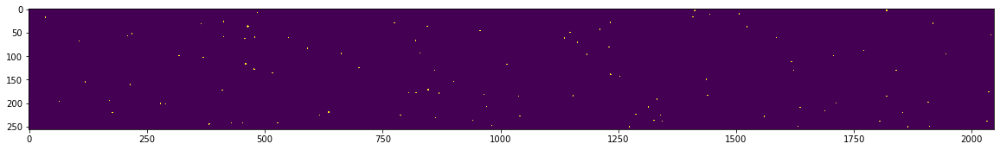

In [26]:
plt.figure(figsize=(20,3))
mock_image = np.zeros([256,2048])
mock_image[idx_dark_jump] = 1
im = plt.imshow(mock_image)

That's pretty random --- which seems about right.

## 1.6 The `ramp_fitting` step

[The last step for NIRISS/SOSS in Stage 1 is the `ramp_fitting` step](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html#calwebb-detector1). What this step does is to fit all the groups with a line. This might seem straightforward, but there is actually a handful of optimizations that are done on the algorithm to fit this line, as in general it is not as simple as a simple least-squares fit. The fit takes into account the special setting of up-the-ramp samples, [as well as the fact that Poisson noise is the model to use for high SNR, while read-noise is the dominating noise-source at low SNR in a pixel](https://jwst-pipeline.readthedocs.io/en/latest/jwst/ramp_fitting/description.html).

Let's apply the step to our data. Beware, this takes a while (about 30 mins, but you can run it using multi-processing to make it faster!):

In [27]:
tramp0 = time.time()
for dataname in datanames:

    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_rampfitstep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_jumpstep.fits' 
    
    if not os.path.exists(output_filename):
        calwebb_detector1.ramp_fit_step.RampFitStep.call(input_filename, \
                                                         output_dir=output_folder, \
                                                         save_results=True, \
                                                         maximum_cores = 'all')
    else:
        print('\t \t \t >> Ramp-fitting step outputs detected. Skipping...')
        
tramp1 = time.time()

2021-05-02 12:59:13,437 - stpipe.RampFitStep - INFO - RampFitStep instance created.
2021-05-02 12:59:14,763 - stpipe.RampFitStep - INFO - Step RampFitStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected_jumpstep.fits',).
2021-05-02 12:59:14,765 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'maximum_cores': 'all'}
2021-05-02 12:59:18,473 - stpipe.RampFitStep - INFO - Using READNOISE reference file: /Users/nespinoza/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0004.fits
2021-05-02 12:59:18,500 - stpipe.RampFitStep 

2021-05-02 12:59:38,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:38,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:38,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:38,483 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:38,872 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:38,931 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:39,358 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:39,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:39,809 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:39,852 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:40,255 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:40,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:40,754 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:40,764 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:41,253 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:41,278 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:41,672 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:41,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:42,159 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:42,186 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:42,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:42,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:43,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:43,039 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:43,454 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:43,494 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:43,932 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:43,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:44,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:44,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:44,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:44,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:45,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:45,236 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:45,708 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:45,720 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:46,267 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:46,294 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:46,691 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:46,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:47,188 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:47,198 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:47,644 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:47,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:48,073 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:48,132 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:48,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:48,643 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:49,113 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:49,171 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:49,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:49,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:50,091 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:50,130 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:50,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:50,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:51,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:51,032 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:51,470 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:51,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:51,940 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:51,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:52,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:52,449 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:52,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:52,940 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:53,331 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:53,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:53,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:53,836 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:54,348 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:54,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:54,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:54,850 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:55,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:55,276 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:55,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:55,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:56,186 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:56,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:56,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:56,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:57,057 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:57,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:57,491 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:57,501 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:57,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:57,959 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:58,341 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:58,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:58,843 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:58,868 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:59,237 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:59,295 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 12:59:59,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 12:59:59,733 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:00,136 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:00,176 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:00,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:00,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:01,019 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:01,044 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:01,543 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:01,586 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:02,013 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:02,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:02,514 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:02,538 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:03,010 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:03,051 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:03,430 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:03,489 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:03,937 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:03,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:04,494 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:04,506 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:05,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:05,185 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:05,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:05,678 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:05,898 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:05,910 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:06,109 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:06,114 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:06,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:06,380 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:06,571 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:06,576 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:06,765 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:06,770 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:06,962 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:06,971 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:07,191 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:07,204 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:07,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:07,397 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:07,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:07,592 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:07,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:07,820 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:07,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:07,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:08,163 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:08,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:08,376 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:08,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:08,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:08,564 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:08,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:08,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:08,952 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:08,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:09,161 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:09,170 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:09,386 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:09,402 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:09,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:09,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:09,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:09,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:09,984 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:10,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:10,190 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:10,191 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:10,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:10,410 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:10,640 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:10,654 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:10,839 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:10,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:11,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:11,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:11,249 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:11,259 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:11,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:11,519 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:11,733 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:11,746 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:11,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:12,009 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:12,231 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:12,258 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:12,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:12,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:12,715 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:12,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:12,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:12,992 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:13,241 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:13,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:13,469 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:13,489 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:13,731 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:13,744 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:14,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:14,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:14,279 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:14,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:14,530 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:14,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:15,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:15,168 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:15,586 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:15,605 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:15,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:16,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:16,376 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:16,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:16,819 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:16,837 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:17,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:17,207 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:17,576 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:17,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:17,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:18,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:18,406 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:18,421 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:18,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:18,799 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:19,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:19,185 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:19,584 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:19,595 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:19,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:19,986 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:20,406 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:20,418 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:20,783 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:20,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:21,176 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:21,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:21,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:21,589 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:21,953 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:21,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:22,344 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:22,355 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:22,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:22,857 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:23,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:23,228 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:23,596 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:23,640 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:23,990 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:24,058 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:24,400 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:24,468 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:24,786 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:24,849 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:25,178 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:25,219 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:25,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:25,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:25,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:26,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:26,420 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:26,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:26,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:26,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:27,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:27,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:27,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:27,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:28,024 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:28,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:28,397 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:28,411 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:28,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:28,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:29,159 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:29,178 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:29,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:29,604 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:30,008 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:30,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:30,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:30,422 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:30,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:30,802 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:31,200 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:31,228 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:31,609 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:31,622 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:31,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:32,006 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:32,400 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:32,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:32,815 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:32,868 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:33,273 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:33,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:33,686 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:33,712 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:34,065 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:34,108 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:34,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:34,539 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:34,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:34,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:35,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:35,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:35,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:35,753 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:36,136 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:36,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:36,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:36,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:36,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:36,953 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:37,338 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:37,350 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:37,730 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:37,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:38,208 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:38,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:38,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:38,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:39,041 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:39,055 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:39,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:39,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:39,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:39,868 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:40,275 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:40,287 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:40,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:40,694 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:41,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:41,095 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:41,486 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:41,497 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:41,906 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:41,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:42,467 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:42,478 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:43,066 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:43,095 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:43,534 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:43,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:44,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:44,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:44,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:44,680 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:45,185 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:45,232 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:45,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:45,692 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:47,052 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:47,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:00:48,669 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:48,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:49,140 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:49,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:49,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:49,612 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:50,057 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:50,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:50,518 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:50,518 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:50,952 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:50,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:51,409 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:51,421 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:51,846 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:51,895 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:52,305 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:52,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:52,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:52,771 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:53,202 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:53,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:53,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:53,659 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:54,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:54,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:54,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:54,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:55,063 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:55,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:55,566 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:55,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:56,044 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:56,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:56,444 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:00:56,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:00:56,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:56,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:57,282 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:57,294 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:57,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:57,714 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:58,102 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:58,113 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:58,493 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:58,563 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:00:58,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:58,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:59,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:59,349 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:00:59,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:00:59,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:00,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:00,161 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:00,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:00,566 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:00,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:00,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:01,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:01,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:01,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:01,762 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:02,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:02,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:02,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:02,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:02,936 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:02,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:03,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:03,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:03,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:03,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:04,189 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:04,235 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:04,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:04,629 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:05,013 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:05,013 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:05,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:05,425 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:05,815 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:05,859 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:06,242 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:06,287 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:06,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:06,712 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:07,086 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:07,115 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:07,468 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:07,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:07,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:07,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:08,329 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:08,345 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:08,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:08,754 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:09,128 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:09,155 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:09,546 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:09,573 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:10,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:10,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:10,392 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:10,434 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:10,822 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:10,851 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:11,232 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:11,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:11,643 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:11,664 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:12,056 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:12,060 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:12,443 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:12,470 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:12,876 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:12,889 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:13,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:13,304 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:13,811 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:13,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:14,263 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:14,276 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:14,670 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:14,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:15,339 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:15,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:15,894 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:15,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:16,545 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:16,600 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:17,066 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:17,140 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:17,661 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:17,672 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:18,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:18,283 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:18,770 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:18,785 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:19,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:19,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:19,855 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:19,867 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:20,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:20,484 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:20,961 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:20,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:21,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:21,608 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:22,114 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:22,127 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:22,743 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:22,772 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:23,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:23,314 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:23,831 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:23,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:24,341 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:24,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:24,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:24,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:25,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:25,573 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:26,131 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:26,143 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:26,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:26,759 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:27,235 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:27,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:27,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:27,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:28,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:28,365 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:28,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:28,885 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:29,389 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:29,400 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:29,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:30,022 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:30,506 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:30,517 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:30,889 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:30,890 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:31,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:31,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:31,430 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:31,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:31,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:31,715 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:32,036 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:32,043 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:32,292 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:32,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:32,527 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:32,538 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:32,780 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:32,823 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:33,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:33,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:33,315 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:33,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:33,581 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:33,614 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:33,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:33,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:34,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:34,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:35,165 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:35,194 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:35,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:35,628 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:36,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:36,017 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:36,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:36,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:36,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:36,846 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:37,224 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:37,252 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:37,609 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:37,639 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:38,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:38,166 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:38,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:38,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:38,975 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:38,990 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:39,420 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:39,431 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:39,841 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:39,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:40,233 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:40,238 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:40,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:40,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:41,063 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:41,076 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:41,449 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:41,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:41,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:41,891 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:42,281 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:42,292 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:42,691 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:42,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:43,108 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:43,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:43,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:43,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:43,916 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:43,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:44,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:44,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:44,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:44,734 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:45,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:45,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:45,631 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:45,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:46,032 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:46,042 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:46,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:46,492 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:46,868 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:46,916 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:47,313 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:47,347 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:47,714 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:47,725 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:48,116 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:48,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:48,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:48,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:48,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:48,963 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:49,370 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:49,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:49,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:49,800 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:50,201 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:50,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:50,620 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:50,692 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:51,088 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:51,105 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:51,494 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:51,514 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:51,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:51,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:52,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:52,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:52,766 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:52,807 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:53,174 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:53,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:53,574 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:53,587 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:53,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:53,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:54,364 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:54,395 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:54,739 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:54,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:55,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:55,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:55,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:55,652 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:56,055 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:56,072 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:56,452 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:56,492 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:56,873 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:56,918 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:57,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:57,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:57,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:57,748 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:58,150 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:01:58,154 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:01:58,589 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:58,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:58,986 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:58,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:01:59,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:59,443 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:01:59,845 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:01:59,890 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:00,264 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:00,310 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:00,693 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:00,724 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:01,211 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:01,220 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:01,634 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:01,679 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:02,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:02,140 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:02,562 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:02,576 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:03,158 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:03,190 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:03,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:03,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:04,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:04,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:04,895 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:04,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:05,507 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:05,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:05,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:06,002 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:06,451 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:06,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:06,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:06,945 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:07,380 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:07,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:07,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:07,912 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:08,296 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:08,307 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:08,769 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:08,792 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:09,253 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:09,299 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:09,762 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:09,773 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:10,310 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:10,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:10,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:10,799 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:11,332 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:11,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:11,789 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:11,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:12,341 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:12,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:12,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:12,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:13,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:13,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:13,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:13,898 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:14,320 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:14,332 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:16,766 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:16,895 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:02:18,654 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:18,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:02:20,531 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:20,651 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:02:22,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:22,399 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:02:23,684 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:23,734 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:24,080 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:24,145 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:24,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:24,580 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:02:24,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:24,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:25,366 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:25,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:25,756 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:25,758 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:02:26,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:26,144 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:26,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:26,572 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:26,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:26,999 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:27,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:27,432 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:27,790 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:27,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:28,181 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:28,209 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:28,600 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:28,632 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:28,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:29,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:29,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:29,419 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:29,816 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:29,884 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:30,269 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:30,298 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:30,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:30,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:31,119 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:31,131 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:31,502 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:31,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:31,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:31,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:32,296 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:32,364 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:32,701 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:32,769 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:33,136 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:33,180 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:33,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:33,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:33,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:33,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:34,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:34,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:34,765 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:34,793 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:35,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:35,180 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:35,577 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:35,589 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:35,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:35,981 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:36,423 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:36,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:36,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:36,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:37,263 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:37,275 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:37,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:37,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:38,109 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:38,121 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:38,493 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:38,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:38,875 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:38,946 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:39,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:02:39,344 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:02:39,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:39,759 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:40,128 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:40,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:40,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:40,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:40,985 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:40,999 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:41,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:41,404 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:41,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:41,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:42,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:42,319 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:42,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:42,725 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:43,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:43,131 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:43,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:43,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:44,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:44,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:44,849 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:44,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:45,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:45,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:45,986 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:46,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:46,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:46,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:47,011 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:47,061 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:47,547 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:47,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:48,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:48,163 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:48,632 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:48,705 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:49,255 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:49,268 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:49,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:49,886 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:50,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:50,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:51,017 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:51,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:51,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:51,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:52,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:52,179 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:52,744 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:52,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:53,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:53,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:53,958 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:54,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:54,573 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:54,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:55,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:55,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:55,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:55,992 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:56,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:56,610 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:57,209 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:57,244 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:57,733 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:57,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:58,435 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:58,472 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:59,084 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:59,143 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:02:59,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:02:59,815 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:00,434 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:00,470 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:01,203 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:01,296 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:01,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:01,928 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:02,629 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:02,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:03,545 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:03,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:04,218 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:04,307 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:04,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:04,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:05,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:05,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:06,320 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:06,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:06,786 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:06,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:07,170 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:07,181 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:07,503 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:07,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:07,849 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:07,850 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:08,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:08,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:08,581 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:08,606 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:08,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:08,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:09,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:09,391 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:09,708 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:09,717 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:10,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:10,503 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:11,176 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:11,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:11,694 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:11,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:12,223 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:12,237 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:12,823 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:12,887 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:13,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:13,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:13,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:14,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:14,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:14,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:15,078 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:15,112 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:15,613 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:15,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:16,236 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:16,295 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:16,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:16,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:17,366 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:17,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:17,931 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:18,022 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:18,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:18,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:19,101 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:19,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:19,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:19,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:20,129 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:20,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:20,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:20,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:21,260 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:21,275 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:21,789 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:21,828 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:22,404 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:22,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:22,964 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:23,001 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:23,496 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:23,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:24,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:24,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:24,514 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:24,518 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:25,035 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:25,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:25,608 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:25,665 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:26,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:26,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:26,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:26,693 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:27,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:27,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:27,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:27,719 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:28,179 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:28,234 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:28,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:28,706 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:29,157 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:29,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:29,612 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:29,642 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:30,112 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:30,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:30,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:30,723 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:31,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:31,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:31,591 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:31,606 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:32,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:32,058 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:32,482 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:32,513 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:32,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:32,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:33,443 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:33,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:33,934 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:33,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:34,417 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:34,424 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:34,887 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:34,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:35,413 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:35,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:35,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:35,915 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:36,350 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:36,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:36,792 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:36,803 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:37,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:37,309 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:37,784 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:37,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:38,370 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:38,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:38,850 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:38,864 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:39,282 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:39,339 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:39,789 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:39,800 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:40,243 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:40,296 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:40,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:40,730 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:41,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:41,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:41,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:41,634 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:42,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:42,103 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:42,545 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:42,573 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:03:43,009 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:03:43,022 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:03:43,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:43,531 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:43,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:43,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:44,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:44,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:44,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:45,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:45,700 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:45,783 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:46,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:46,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:46,955 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:46,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:47,605 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:47,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:48,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:48,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:48,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:48,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:48,705 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:48,738 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:49,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:49,068 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:49,434 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:49,467 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:49,708 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:49,721 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:50,070 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:50,098 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:50,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:50,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:50,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:50,698 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:50,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:51,050 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:51,366 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:51,379 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:51,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:51,684 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:52,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:52,033 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:52,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:52,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:52,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:52,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:53,060 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:53,074 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:53,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:53,397 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:53,686 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:53,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:54,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:54,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:54,352 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:54,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:54,676 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:54,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:54,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:54,982 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:55,298 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:55,305 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:55,632 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:55,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:55,936 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:55,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:56,269 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:56,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:56,577 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:56,608 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:56,868 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:56,895 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:57,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:57,334 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:58,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:58,081 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:58,624 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:58,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:59,137 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:59,150 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:03:59,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:03:59,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:00,168 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:00,249 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:00,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:00,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:01,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:01,197 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:01,674 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:01,693 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:02,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:02,190 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:02,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:02,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:03,245 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:03,259 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:03,802 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:03,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:04,331 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:04,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:04,897 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:04,915 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:05,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:05,470 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:05,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:06,026 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:06,540 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:06,574 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:07,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:07,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:07,663 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:07,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:08,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:08,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:08,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:08,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:09,516 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:09,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:10,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:10,154 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:10,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:10,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:11,206 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:11,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:11,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:11,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:12,249 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:12,260 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:12,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:12,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:13,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:13,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:13,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:13,895 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:14,395 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:14,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:14,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:14,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:15,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:15,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:16,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:16,029 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:16,559 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:16,574 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:17,075 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:17,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:17,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:17,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:18,123 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:18,138 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:18,633 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:18,649 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:19,150 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:19,165 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:19,664 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:19,679 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:20,170 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:20,208 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:20,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:20,753 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:21,228 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:21,244 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:21,781 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:21,797 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:22,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:22,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:22,869 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:22,884 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:23,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:23,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:23,928 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:23,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:24,479 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:24,492 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:24,928 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:24,936 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:25,206 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:25,210 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:25,483 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:25,491 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:25,778 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:25,827 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:26,076 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:26,130 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:26,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:26,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:26,668 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:26,678 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:26,976 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:26,984 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:27,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:27,299 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:27,577 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:27,592 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:27,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:27,875 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:28,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:28,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:28,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:28,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:28,736 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:28,758 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:29,028 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:29,064 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:29,347 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:29,362 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:29,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:29,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:29,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:29,975 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:30,262 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:30,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:30,548 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:30,584 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:30,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:30,875 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:31,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:31,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:31,564 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:31,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:31,861 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:31,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:32,275 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:32,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:32,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:32,596 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:32,898 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:32,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:33,188 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:33,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:33,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:33,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:33,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:33,850 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:34,132 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:34,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:34,409 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:34,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:34,781 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:34,800 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:35,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:35,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:35,666 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:35,706 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:36,015 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:36,032 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:36,411 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:36,418 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:36,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:36,736 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:37,070 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:37,095 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:37,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:37,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:37,687 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:37,701 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:38,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:38,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:38,563 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:38,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:38,867 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:38,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:39,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:39,302 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:39,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:39,631 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:39,900 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:39,937 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:40,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:40,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:40,572 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:40,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:40,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:40,953 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:41,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:41,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:41,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:41,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:41,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:42,011 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:42,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:42,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:42,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:42,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:43,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:43,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:43,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:43,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:43,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:43,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:44,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:44,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:44,549 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:44,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:44,891 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:44,904 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:45,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:45,231 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:46,039 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:46,088 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:46,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:46,644 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:47,164 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:47,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:47,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:47,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:48,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:48,214 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:48,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:48,764 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:49,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:49,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:49,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:49,849 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:50,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:50,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:51,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:51,103 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:51,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:51,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:52,053 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:52,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:52,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:52,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:53,074 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:53,171 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:53,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:53,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:54,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:54,213 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:54,665 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:54,687 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:55,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:55,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:55,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:55,836 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:56,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:56,279 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:56,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:56,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:57,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:57,410 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:57,925 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:57,926 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:04:58,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:58,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:04:58,995 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:04:59,001 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:04:59,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:04:59,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:00,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:00,054 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:00,562 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:00,578 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:01,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:01,105 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:01,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:01,691 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:02,190 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:02,208 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:02,663 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:02,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:03,227 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:03,290 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:03,793 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:03,799 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:04,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:04,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:04,821 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:04,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:05,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:05,399 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:05,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:05,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:06,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:06,419 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:06,872 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:06,887 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:07,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:07,397 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:07,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:07,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:08,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:08,396 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:08,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:08,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:09,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:09,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:09,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:09,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:10,474 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:10,498 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:10,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:10,985 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:11,418 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:11,464 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:11,880 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:11,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:12,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:12,420 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:12,920 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:12,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:13,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:13,462 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:13,927 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:13,934 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:14,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:14,443 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:14,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:14,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:15,312 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:15,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:15,793 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:15,816 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:16,249 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:16,285 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:16,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:16,754 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:17,321 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:17,394 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:17,937 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:17,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:18,554 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:18,608 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:19,109 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:19,186 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:20,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:20,410 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:21,003 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:21,017 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:21,498 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:21,512 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:21,959 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:21,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:22,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:22,499 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:22,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:23,011 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:23,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:23,472 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:23,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:23,976 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:24,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:24,462 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:24,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:24,965 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:25,410 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:25,423 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:25,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:25,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:26,318 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:26,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:26,790 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:26,831 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:27,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:27,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:27,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:27,890 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:28,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:28,391 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:28,828 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:28,852 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:29,323 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:29,345 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:29,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:29,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:30,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:30,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:30,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:30,822 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:31,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:31,299 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:31,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:31,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:32,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:32,313 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:32,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:32,857 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:33,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:33,447 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:33,875 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:33,912 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:34,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:34,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:34,801 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:34,861 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:35,353 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:35,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:35,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:35,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:36,367 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:36,377 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:36,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:36,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:37,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:37,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:38,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:38,063 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:38,690 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:38,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:39,453 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:39,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:40,008 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:40,024 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:40,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:40,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:41,003 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:41,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:41,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:41,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:41,976 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:41,981 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:42,538 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:42,554 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:43,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:43,091 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:43,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:43,576 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:44,096 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:44,175 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:44,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:44,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:45,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:45,245 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:45,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:45,701 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:46,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:46,189 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:46,641 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:46,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:47,057 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:47,109 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:47,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:47,560 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:47,964 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:48,015 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:48,431 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:48,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:48,859 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:48,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:49,312 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:49,336 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:49,800 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:49,816 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:50,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:50,290 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:50,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:50,748 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:51,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:51,232 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:51,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:05:51,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:05:52,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:52,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:52,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:52,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:53,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:53,074 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:53,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:53,615 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:54,057 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:54,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:05:54,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:54,550 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:54,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:55,036 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:55,641 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:55,654 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:56,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:56,302 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:56,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:57,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:57,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:57,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:58,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:58,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:58,739 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:58,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:59,355 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:05:59,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:05:59,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:00,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:00,505 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:00,590 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:01,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:01,166 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:01,769 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:01,804 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:02,332 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:02,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:02,945 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:02,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:03,587 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:03,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:04,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:04,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:05,068 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:05,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:05,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:05,675 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:06,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:06,256 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:06,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:06,835 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:07,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:07,229 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:07,620 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:07,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:07,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:08,027 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:08,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:08,320 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:08,604 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:08,619 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:08,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:09,005 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:09,350 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:09,366 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:09,709 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:09,725 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:10,006 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:10,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:10,418 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:10,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:10,730 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:10,745 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:11,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:11,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:11,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:11,492 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:11,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:11,846 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:12,483 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:12,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:13,187 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:13,191 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:13,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:13,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:14,271 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:14,287 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:15,011 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:15,028 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:15,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:15,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:16,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:16,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:16,792 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:16,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:17,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:17,365 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:17,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:17,910 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:18,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:18,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:19,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:19,208 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:19,701 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:19,769 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:20,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:20,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:20,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:21,041 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:21,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:21,689 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:22,217 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:22,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:22,913 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:22,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:23,573 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:23,598 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:24,128 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:24,168 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:24,701 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:24,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:25,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:25,285 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:25,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:26,074 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:26,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:26,867 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:27,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:27,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:27,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:27,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:28,444 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:28,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:29,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:29,166 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:29,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:29,688 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:30,189 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:30,242 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:30,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:30,781 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:31,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:31,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:31,898 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:31,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:32,439 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:32,455 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:32,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:33,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:33,534 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:33,550 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:34,111 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:34,111 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:34,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:34,677 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:35,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:35,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:35,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:35,901 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:36,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:36,433 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:36,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:36,996 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:37,519 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:37,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:38,106 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:38,116 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:38,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:38,820 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:39,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:39,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:40,042 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:40,127 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:40,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:40,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:41,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:41,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:41,843 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:41,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:42,540 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:42,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:43,125 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:43,186 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:43,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:43,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:44,308 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:44,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:44,872 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:44,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:45,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:06:45,457 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:06:46,036 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:46,078 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:46,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:46,771 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:47,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:47,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:47,876 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:47,919 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:48,498 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:48,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:49,115 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:49,132 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:49,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:49,744 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:50,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:50,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:06:51,091 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:51,108 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:51,610 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:51,632 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:51,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:51,976 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:52,334 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:52,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:52,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:52,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:53,053 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:53,070 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:53,413 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:53,453 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:53,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:53,891 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:54,229 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:54,304 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:54,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:54,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:55,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:55,111 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:55,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:55,559 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:55,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:55,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:56,369 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:56,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:56,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:56,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:57,139 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:57,159 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:57,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:57,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:58,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:58,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:58,538 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:58,547 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:58,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:59,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:59,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:59,518 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:06:59,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:06:59,933 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:00,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:00,345 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:00,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:00,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:01,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:01,137 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:01,463 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:01,467 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:01,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:01,899 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:02,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:02,296 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:02,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:02,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:03,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:03,231 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:03,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:03,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:04,224 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:04,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:04,642 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:04,665 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:05,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:05,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:05,603 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:05,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:06,002 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:06,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:06,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:06,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:07,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:07,102 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:07,506 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:07,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:07,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:07,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:08,423 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:08,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:08,920 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:08,939 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:09,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:09,360 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:09,801 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:09,841 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:10,244 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:10,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:10,629 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:10,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:10,977 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:10,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:11,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:11,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:11,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:11,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:12,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:12,669 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:13,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:13,364 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:13,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:13,990 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:14,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:14,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:15,175 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:15,196 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:15,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:15,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:16,332 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:16,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:16,926 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:16,939 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:17,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:17,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:17,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:17,999 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:18,534 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:18,550 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:19,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:19,078 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:19,652 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:19,664 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:20,267 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:20,319 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:20,829 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:20,894 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:21,402 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:21,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:21,912 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:21,978 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:22,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:22,476 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:22,982 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:23,046 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:23,527 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:23,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:24,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:24,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:24,648 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:24,663 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:25,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:25,186 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:25,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:25,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:26,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:26,238 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:26,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:26,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:27,213 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:27,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:27,717 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:27,725 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:28,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:28,243 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:28,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:28,690 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:29,145 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:29,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:29,664 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:29,679 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:30,180 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:30,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:30,667 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:30,705 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:31,173 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:31,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:31,652 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:31,709 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:32,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:32,197 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:32,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:32,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:33,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:33,271 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:33,692 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:33,780 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:34,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:34,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:34,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:34,775 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:35,285 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:35,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:35,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:35,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:36,268 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:36,298 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:36,742 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:36,778 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:37,242 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:37,278 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:37,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:37,764 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:38,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:38,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:39,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:39,828 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:40,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:40,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:40,925 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:40,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:41,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:41,475 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:41,978 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:41,984 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:42,469 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:42,507 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:42,948 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:42,988 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:43,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:43,482 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:43,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:43,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:44,409 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:44,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:44,866 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:44,896 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:45,430 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:45,490 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:46,150 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:46,164 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:46,793 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:46,851 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:47,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:47,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:47,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:47,543 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:47,904 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:47,932 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:48,219 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:48,223 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:48,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:48,561 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:48,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:48,896 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:49,209 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:49,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:49,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:49,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:49,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:49,910 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:50,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:50,246 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:50,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:50,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:50,842 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:50,855 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:51,173 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:51,215 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:51,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:51,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:51,791 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:51,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:52,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:52,201 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:52,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:52,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:52,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:52,829 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:53,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:53,140 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:53,449 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:53,462 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:53,815 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:53,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:54,157 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:54,175 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:54,437 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:54,447 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:54,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:54,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:55,540 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:55,543 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:56,096 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:56,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:56,619 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:56,673 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:57,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:57,188 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:57,669 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:57,733 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:07:58,192 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:58,219 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:58,772 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:58,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:07:59,253 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:07:59,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:07:59,809 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:07:59,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:00,364 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:00,380 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:00,935 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:00,934 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:01,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:01,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:01,990 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:02,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:02,572 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:02,587 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:03,084 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:03,123 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:03,634 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:03,675 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:04,161 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:04,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:04,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:04,812 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:05,323 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:05,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:05,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:05,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:06,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:06,512 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:06,971 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:07,065 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:07,561 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:07,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:08,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:08,105 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:08,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:08,686 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:09,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:09,265 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:09,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:09,846 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:10,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:10,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:10,958 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:10,999 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:11,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:11,551 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:12,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:12,075 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:12,605 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:12,667 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:13,144 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:13,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:13,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:13,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:14,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:14,258 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:14,836 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:14,889 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:15,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:15,430 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:16,008 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:16,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:16,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:16,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:17,132 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:17,171 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:17,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:17,739 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:18,224 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:18,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:18,859 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:18,869 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:19,373 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:19,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:19,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:19,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:20,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:20,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:21,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:21,122 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:21,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:21,663 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:22,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:22,213 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:22,737 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:22,738 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:23,236 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:23,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:23,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:23,803 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:24,260 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:24,339 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:08:24,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:24,871 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:25,347 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:25,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:25,869 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:25,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:26,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:26,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:26,939 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:26,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:27,462 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:27,476 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:27,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:28,041 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:28,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:28,561 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:08:29,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:29,223 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:29,918 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:29,937 - stpipe.RampFitStep - INFO - Number of groups per integration: 6
2021-05-02 13:08:29,942 - stpipe.RampFitStep - INFO - Number of integrations: 213
2021-05-02 13:08:29,982 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bo

2021-05-02 13:08:30,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:30,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:31,338 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:31,409 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:32,072 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:32,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:32,831 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:32,892 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:33,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:33,537 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:34,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:34,336 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:34,938 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:35,028 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:35,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:35,724 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:36,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:36,465 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:37,047 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:37,061 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:37,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:37,807 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:38,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:38,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:39,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:39,143 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:39,677 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:39,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:40,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:40,419 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:40,961 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:41,047 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:41,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:41,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:42,202 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:42,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:42,948 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:42,961 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:43,649 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:43,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:44,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:44,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:44,971 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:45,029 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:45,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:45,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:46,327 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:08:46,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:08:49,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:49,308 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:08:51,704 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:51,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:08:54,236 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:54,408 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:08:56,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:56,921 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:08:59,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:08:59,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:01,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:01,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:03,981 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:04,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:06,220 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:06,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:08,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:08,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:10,501 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:10,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:12,464 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:12,592 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:14,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:14,483 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:16,264 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:16,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:09:18,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:09:18,281 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:16:01,450 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:01,460 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:01,935 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:01,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:02,395 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:02,437 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:02,854 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:02,913 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:03,339 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:03,362 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:03,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:03,773 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:04,268 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:04,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:04,758 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:04,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:05,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:05,224 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:05,661 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:05,672 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:06,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:06,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:06,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:06,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:06,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:07,010 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:07,481 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:07,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:07,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:07,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:08,399 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:08,425 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:08,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:08,866 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:09,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:09,355 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:09,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:09,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:10,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:10,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:10,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:10,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:11,088 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:11,145 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:11,604 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:11,614 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:12,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:12,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:12,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:12,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:13,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:13,058 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:13,501 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:13,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:13,969 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:13,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:14,432 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:14,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:14,851 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:14,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:15,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:15,360 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:15,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:15,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:16,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:16,264 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:16,721 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:16,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:17,137 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:17,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:17,648 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:17,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:18,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:18,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:18,561 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:18,625 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:19,078 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:19,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:19,562 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:19,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:19,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:20,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:20,485 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:20,525 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:20,981 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:21,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:21,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:21,471 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:21,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:21,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:22,431 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:22,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:22,897 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:22,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:23,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:23,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:23,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:23,541 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:23,767 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:23,784 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:23,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:24,006 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:24,245 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:24,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:24,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:24,520 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:24,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:24,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:25,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:25,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:25,253 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:25,263 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:25,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:25,506 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:25,731 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:25,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:25,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:25,978 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:26,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:26,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:26,438 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:26,453 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:26,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:26,666 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:26,861 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:26,903 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:27,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:27,138 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:27,348 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:27,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:27,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:27,623 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:27,848 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:27,848 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:28,066 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:28,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:28,272 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:28,327 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:28,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:28,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:28,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:28,798 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:29,013 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:29,035 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:29,305 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:29,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:29,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:29,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:29,749 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:29,765 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:29,999 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:30,031 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:30,233 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:30,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:30,474 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:30,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:30,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:30,712 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:30,972 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:30,986 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:31,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:31,246 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:31,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:31,487 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:31,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:31,745 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:31,965 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:31,977 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:32,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:32,194 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:32,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:32,444 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:32,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:32,698 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:32,920 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:32,955 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:33,189 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:33,210 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:33,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:33,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:33,713 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:33,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:33,964 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:33,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:34,164 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:34,174 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:34,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:34,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:34,684 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:34,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:34,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:34,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:35,209 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:35,216 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:35,434 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:35,438 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:35,687 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:35,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:35,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:35,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:36,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:36,163 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:36,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:36,413 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:36,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:36,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:36,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:36,888 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:37,145 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:37,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:37,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:37,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:37,608 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:37,620 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:37,884 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:37,912 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:38,130 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:38,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:38,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:38,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:39,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:39,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:39,439 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:39,468 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:39,863 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:39,875 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:40,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:40,281 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:40,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:40,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:41,125 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:41,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:41,509 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:41,513 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:41,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:41,894 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:42,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:42,276 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:42,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:42,653 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:42,993 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:43,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:43,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:43,380 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:43,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:43,821 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:44,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:44,251 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:44,574 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:44,586 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:44,965 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:45,001 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:45,352 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:45,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:45,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:45,754 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:46,123 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:46,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:46,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:46,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:46,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:46,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:47,317 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:47,353 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:47,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:47,746 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:48,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:48,095 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:48,489 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:48,533 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:48,886 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:48,928 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:49,282 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:49,292 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:49,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:49,677 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:50,033 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:50,053 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:50,378 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:50,416 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:50,748 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:50,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:51,138 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:51,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:16:51,531 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:51,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:51,937 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:51,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:52,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:52,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:52,766 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:52,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:53,067 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:53,088 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:53,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:53,329 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:53,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:53,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:53,783 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:53,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:54,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:54,051 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:54,281 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:54,310 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:54,528 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:16:54,563 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:16:54,803 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:54,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:55,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:55,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:55,256 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:55,265 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:55,491 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:55,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:55,753 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:55,753 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:56,017 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:56,032 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:56,252 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:56,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:56,487 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:56,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:56,734 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:56,746 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:56,945 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:56,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:57,191 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:57,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:57,487 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:57,503 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:57,714 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:57,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:57,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:57,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:58,194 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:58,233 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:58,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:58,468 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:58,669 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:58,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:58,903 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:58,935 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:59,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:59,188 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:59,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:59,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:59,659 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:59,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:16:59,903 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:16:59,919 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:00,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:00,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:00,394 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:00,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:00,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:00,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:00,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:00,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:01,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:01,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:01,377 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:01,395 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:01,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:01,652 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:01,864 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:01,876 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:02,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:02,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:02,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:02,439 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:02,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:02,773 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:03,014 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:03,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:03,352 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:03,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:04,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:04,042 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:04,676 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:04,691 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:05,211 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:05,259 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:05,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:05,709 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:06,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:06,178 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:06,620 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:06,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:07,055 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:07,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:07,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:07,525 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:07,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:08,027 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:08,416 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:08,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:09,052 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:09,137 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:09,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:09,736 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:10,209 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:10,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:10,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:10,416 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:09,476 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:09,435 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:11,127 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:11,140 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:11,546 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:11,576 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:11,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:11,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:12,381 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:12,389 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:12,764 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:12,815 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:13,179 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:13,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:13,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:13,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:14,060 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:14,086 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:14,489 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:14,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:14,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:14,914 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:15,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:15,319 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:15,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:15,672 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:16,030 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:16,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:16,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:16,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:16,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:16,927 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:17,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:17,267 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:17,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:17,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:18,060 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:18,073 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:18,446 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:18,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:18,865 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:18,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:19,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:19,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:19,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:19,719 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:20,049 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:20,117 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:20,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:20,482 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:20,871 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:20,884 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:21,255 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:21,266 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:21,675 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:21,689 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:22,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:22,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:22,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:22,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:22,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:22,936 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:23,273 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:23,314 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:23,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:23,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:24,054 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:24,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:24,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:24,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:24,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:24,869 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:25,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:25,241 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:25,634 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:25,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:26,022 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:26,047 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:26,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:26,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:26,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:26,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:27,220 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:27,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:27,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:27,614 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:28,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:28,031 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:28,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:28,519 - stpipe.RampFitStep - INFO - Number of groups per integration: 6
2021-05-02 13:17:28,523 - stpipe.RampFitStep - INFO - Number of integrations: 207
2021-05-02 13:17:28,560 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bo

2021-05-02 13:17:29,049 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:29,059 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:29,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:29,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:30,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:30,258 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:30,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:30,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:31,229 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:31,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:31,706 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:31,750 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:32,188 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:32,250 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:32,745 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:32,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:33,048 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:33,056 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:33,335 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:33,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:33,581 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:33,588 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:33,812 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:33,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:34,111 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:34,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:34,397 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:34,406 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:34,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:34,656 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:34,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:34,946 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:35,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:35,211 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:35,472 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:35,486 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:35,714 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:35,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:36,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:36,017 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:36,276 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:36,282 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:36,533 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:36,536 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:36,796 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:36,827 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:37,045 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:37,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:37,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:37,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:37,770 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:37,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:38,285 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:38,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:38,738 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:38,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:39,202 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:39,214 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:39,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:39,743 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:40,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:40,246 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:40,674 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:40,689 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:41,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:41,131 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:41,577 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:41,590 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:42,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:42,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:42,479 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:42,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:42,926 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:42,977 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:43,355 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:43,424 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:43,812 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:43,888 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:44,338 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:44,340 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:44,775 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:44,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:45,232 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:45,288 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:45,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:45,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:46,175 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:46,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:46,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:46,679 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:47,082 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:47,116 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:47,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:47,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:47,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:47,996 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:48,416 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:48,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:48,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:48,861 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:49,257 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:49,277 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:49,654 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:49,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:50,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:50,119 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:50,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:50,540 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:50,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:50,934 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:51,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:51,349 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:51,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:51,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:52,122 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:52,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:52,519 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:52,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:52,915 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:52,918 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:53,302 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:53,313 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:53,705 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:53,717 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:54,104 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:54,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:54,490 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:54,538 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:54,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:54,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:55,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:55,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:55,693 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:55,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:56,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:56,125 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:56,496 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:56,543 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:56,922 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:56,967 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:57,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:57,350 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:57,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:57,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:17:58,144 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:58,187 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:58,541 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:58,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:58,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:58,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:17:59,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:17:59,391 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:17:59,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:17:59,802 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:00,176 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:00,204 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:00,605 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:00,638 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:01,118 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:01,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:01,595 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:01,609 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:01,874 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:01,926 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:02,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:02,187 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:02,391 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:02,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:02,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:02,653 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:02,927 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:02,932 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:03,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:03,180 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:03,404 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:03,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:03,673 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:03,694 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:03,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:03,920 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:04,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:04,163 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:04,392 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:04,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:04,623 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:04,625 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:04,849 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:04,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:05,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:05,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:05,323 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:05,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:05,609 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:05,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:05,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:05,872 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:06,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:06,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:06,471 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:06,479 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:06,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:06,816 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:07,077 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:07,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:07,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:07,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:07,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:07,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:07,896 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:07,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:08,119 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:08,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:08,386 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:08,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:08,665 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:08,692 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:08,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:08,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:09,272 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:09,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:09,543 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:09,557 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:09,811 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:09,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:10,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:10,137 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:10,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:10,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:10,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:10,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:10,995 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:11,006 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:11,263 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:11,301 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:11,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:11,596 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:11,821 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:11,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:12,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:12,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:12,336 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:12,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:12,625 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:12,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:12,859 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:12,876 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:13,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:13,127 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:13,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:13,377 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:13,657 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:13,677 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:13,913 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:13,924 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:14,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:14,178 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:14,432 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:14,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:14,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:14,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:14,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:14,911 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:15,130 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:15,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:15,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:15,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:15,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:15,721 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:15,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:15,963 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:16,198 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:16,210 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:16,463 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:16,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:16,855 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:16,940 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:17,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:17,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:18,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:18,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:18,557 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:18,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:19,015 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:19,074 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:19,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:19,557 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:19,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:20,028 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:20,475 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:20,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:20,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:20,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:21,430 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:21,443 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:21,903 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:21,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:22,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:22,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:22,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:22,862 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:23,265 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:23,341 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:23,781 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:23,840 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:24,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:24,251 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:24,612 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:24,655 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:25,016 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:25,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:25,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:25,527 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:25,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:25,948 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:26,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:26,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:26,775 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:26,789 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:27,213 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:27,272 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:27,689 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:27,743 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:28,101 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:28,152 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:28,591 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:28,610 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:29,013 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:29,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:29,414 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:29,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:29,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:29,846 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:30,241 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:30,254 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:30,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:30,730 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:31,136 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:31,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:31,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:31,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:31,978 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:31,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:32,391 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:32,406 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:32,811 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:32,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:33,214 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:33,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:33,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:33,636 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:34,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:34,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:34,438 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:34,503 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:34,908 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:34,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:35,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:35,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:35,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:35,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:36,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:36,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:36,546 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:36,558 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:36,931 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:36,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:37,301 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:37,370 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:37,688 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:37,756 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:38,299 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:38,329 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:38,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:38,725 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:39,116 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:39,127 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:39,572 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:39,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:39,968 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:39,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:40,231 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:40,243 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:40,550 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:40,564 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:40,818 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:40,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:41,138 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:41,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:41,419 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:41,432 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:41,672 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:41,723 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:41,949 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:41,976 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:42,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:42,234 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:42,488 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:42,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:42,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:42,834 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:43,145 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:43,161 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:43,423 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:43,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:43,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:43,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:43,977 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:43,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:44,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:44,328 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:44,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:44,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:44,915 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:44,918 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:45,207 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:45,220 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:45,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:45,578 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:46,288 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:46,396 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:46,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:47,007 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:47,485 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:47,516 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:18:48,009 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:48,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:48,631 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:48,736 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:49,263 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:49,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:50,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:50,101 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:50,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:50,780 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:51,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:51,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:51,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:52,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:52,696 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:52,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:53,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:53,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:53,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:53,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:54,622 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:54,640 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:55,333 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:55,454 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:56,078 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:56,185 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:18:56,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:18:56,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:18:57,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:57,638 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:58,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:58,459 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:18:59,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:18:59,251 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:00,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:00,036 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:00,812 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:00,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:01,622 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:01,706 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:02,404 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:02,509 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:03,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:03,310 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:04,107 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:04,050 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:04,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:04,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:05,591 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:05,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:06,294 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:06,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:07,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:07,257 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:08,009 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:08,058 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:08,801 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:08,801 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:09,581 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:09,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:10,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:10,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:11,122 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:11,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:11,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:11,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:12,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:12,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:13,204 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:13,223 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:13,881 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:13,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:14,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:14,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:15,287 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:15,408 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:16,166 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:16,180 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:16,837 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:16,885 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:17,560 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:17,581 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:18,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:18,274 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:18,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:19,005 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:19,666 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:19,688 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:20,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:20,471 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:21,193 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:21,244 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:21,901 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:21,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:22,626 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:22,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:23,301 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:23,380 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:24,031 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:24,041 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:24,689 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:24,700 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:25,385 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:25,467 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:26,033 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:26,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:26,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:26,819 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:27,454 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:27,459 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:28,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:28,155 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:28,950 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:29,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:29,646 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:29,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:30,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:30,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:30,824 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:30,839 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:31,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:31,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:32,301 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:32,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:32,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:33,019 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:33,670 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:33,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:34,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:34,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:35,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:35,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:35,850 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:35,886 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:36,600 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:36,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:37,283 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:37,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:37,919 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:38,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:38,716 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:38,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:39,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:39,438 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:40,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:40,139 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:40,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:40,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:41,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:41,447 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:41,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:41,831 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:42,147 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:42,168 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:42,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:42,468 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:42,839 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:42,871 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:43,122 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:43,135 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:43,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:43,469 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:44,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:44,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:44,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:44,665 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:45,128 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:45,181 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:45,625 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:45,631 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:46,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:46,103 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:46,589 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:46,621 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:47,049 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:47,081 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:47,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:47,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:48,004 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:48,022 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:48,471 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:48,492 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:48,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:48,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:49,395 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:49,431 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:49,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:49,922 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:50,352 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:50,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:50,828 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:50,860 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:51,308 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:51,322 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:51,772 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:51,792 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:52,237 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:52,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:52,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:52,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:53,236 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:53,289 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:53,723 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:53,755 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:54,198 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:19:54,215 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:19:54,651 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:54,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:55,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:55,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:55,604 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:55,656 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:56,070 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:56,106 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:56,497 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:56,533 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:56,948 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:56,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:57,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:57,402 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:57,823 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:57,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:19:58,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:58,326 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:58,714 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:58,763 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:59,167 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:59,198 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:19:59,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:19:59,641 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:00,059 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:00,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:00,527 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:00,571 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:00,959 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:00,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:01,399 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:01,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:01,854 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:01,885 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:02,274 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:02,304 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:02,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:02,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:03,174 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:03,193 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:03,609 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:03,625 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:04,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:04,055 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:04,491 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:04,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:04,951 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:04,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:05,419 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:05,451 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:05,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:05,892 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:06,321 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:06,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:06,759 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:06,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:07,217 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:07,249 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:07,653 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:07,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:08,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:08,113 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:08,537 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:08,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:09,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:09,035 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:09,465 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:09,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:09,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:09,928 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:10,348 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:10,349 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:10,782 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:10,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:11,227 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:11,239 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:11,668 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:11,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:12,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:12,123 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:12,570 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:12,612 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:12,986 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:13,051 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:13,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:13,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:13,883 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:13,892 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:14,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:14,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:14,972 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:15,002 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:15,516 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:15,600 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:16,081 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:16,117 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:16,648 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:16,697 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:17,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:17,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:17,659 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:17,709 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:18,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:18,217 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:18,790 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:18,819 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:19,269 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:19,337 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:19,870 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:19,901 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:20,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:20,428 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:20,962 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:20,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:21,632 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:21,668 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:22,190 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:22,274 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:22,819 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:22,848 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:23,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:23,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:23,890 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:23,919 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:24,154 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:24,171 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:24,453 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:24,476 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:24,699 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:24,724 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:24,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:24,995 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:25,257 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:25,287 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:25,557 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:25,571 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:25,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:25,894 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:26,248 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:26,278 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:26,593 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:26,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:26,904 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:26,933 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:27,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:27,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:27,462 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:27,465 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:27,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:27,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:28,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:28,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:28,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:28,347 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:28,635 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:28,690 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:28,995 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:29,076 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:29,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:29,675 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:30,131 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:30,146 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:30,623 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:30,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:31,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:31,139 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:31,587 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:31,605 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:32,067 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:32,098 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:32,559 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:32,615 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:33,042 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:33,101 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:33,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:33,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:34,058 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:34,090 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:34,584 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:34,591 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:35,095 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:35,096 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:35,583 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:35,592 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:36,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:36,202 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:36,694 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:36,706 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:37,169 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:37,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:37,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:37,717 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:38,358 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:38,378 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:38,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:38,869 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:39,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:39,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:39,894 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:39,930 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:40,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:40,455 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:40,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:40,989 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:41,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:41,522 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:41,977 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:41,990 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:42,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:42,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:42,896 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:42,918 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:43,365 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:43,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:43,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:43,919 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:44,327 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:44,420 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:44,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:44,947 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:45,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:45,476 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:45,932 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:45,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:46,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:46,458 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:46,930 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:46,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:47,436 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:47,451 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:47,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:48,018 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:48,499 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:48,531 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:48,981 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:49,035 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:49,510 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:49,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:50,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:50,075 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:50,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:50,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:51,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:51,061 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:51,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:51,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:52,051 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:52,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:52,561 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:52,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:53,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:53,077 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:53,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:53,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:54,097 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:54,113 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:54,592 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:54,664 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:55,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:55,168 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:55,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:55,687 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:56,158 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:56,195 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:56,645 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:56,684 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:57,147 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:57,164 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:57,648 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:20:57,659 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:20:58,104 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:58,109 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:20:58,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:58,569 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:59,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:59,026 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:59,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:59,488 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:20:59,921 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:20:59,935 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:00,393 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:00,408 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:00,878 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:00,893 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:01,335 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:01,338 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:01,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:01,826 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:02,298 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:02,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:02,809 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:02,845 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:03,548 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:03,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:04,219 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:04,279 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:04,765 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:04,840 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:05,343 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:05,375 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:05,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:06,005 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:06,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:06,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:07,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:07,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:07,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:07,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:08,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:08,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:08,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:08,829 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:09,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:09,408 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:09,890 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:09,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:10,448 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:10,496 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:10,972 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:11,043 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:11,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:11,574 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:12,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:12,120 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:14,357 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:14,493 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:21:16,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:16,082 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:16,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:16,584 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:17,104 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:17,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:17,681 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:17,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:18,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:18,295 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:18,759 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:18,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:19,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:19,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:19,913 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:19,931 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:20,550 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:20,566 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:21,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:21,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:21,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:21,683 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:22,160 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:22,220 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:22,675 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:22,734 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:23,141 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:23,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:23,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:23,627 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:24,062 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:24,076 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:24,559 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:24,594 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:25,059 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:25,115 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:25,564 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:25,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:26,057 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:26,093 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:26,497 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:26,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:27,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:27,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:27,459 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:27,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:27,973 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:27,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:28,477 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:28,489 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:28,982 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:28,996 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:29,457 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:29,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:29,985 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:30,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:30,448 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:30,530 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:30,938 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:31,020 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:31,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:31,497 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:31,975 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:32,008 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:32,461 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:32,519 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:33,001 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:33,015 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:33,496 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:33,531 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:33,960 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:33,994 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:34,459 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:34,475 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:34,965 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:34,979 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:35,456 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:35,469 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:35,887 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:35,901 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:36,318 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:36,401 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:36,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:36,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:37,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:37,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:37,810 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:37,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:38,273 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:38,328 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:38,816 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:38,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:39,396 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:39,433 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:39,907 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:39,930 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:40,405 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:40,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:41,071 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:41,086 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:41,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:41,567 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:42,034 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:42,048 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:42,498 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:42,511 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:43,011 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:43,032 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:43,495 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:43,507 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:43,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:43,988 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:21:44,465 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:21:44,473 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:21:44,970 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:44,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:45,502 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:45,560 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:45,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:46,059 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:46,568 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:46,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:47,194 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:47,255 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:47,829 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:47,842 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:48,467 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:48,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:49,088 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:49,146 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:49,708 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:49,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:50,304 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:50,361 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:50,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:50,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:51,500 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:51,559 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:52,077 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:52,090 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:52,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:52,741 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:53,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:53,284 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:53,926 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:53,963 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:54,546 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:54,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:55,241 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:55,256 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:55,820 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:55,904 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:56,515 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:56,529 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:57,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:57,234 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:57,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:57,727 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:57,996 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:58,053 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:58,348 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:58,367 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:58,649 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:58,685 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:58,966 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:59,027 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:59,369 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:59,389 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:59,673 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:21:59,678 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:21:59,993 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:00,003 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:00,336 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:00,371 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:00,682 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:00,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:01,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:01,048 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:01,417 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:01,418 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:01,724 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:01,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:02,009 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:02,026 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:02,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:02,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:02,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:02,742 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:03,018 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:03,049 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:03,315 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:03,331 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:03,684 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:03,688 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:03,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:03,991 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:04,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:04,403 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:04,767 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:04,794 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:05,142 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:05,182 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:05,547 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:05,566 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:06,010 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:06,067 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:06,439 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:06,459 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:06,837 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:06,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:07,243 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:07,274 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:07,884 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:07,980 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:08,631 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:08,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:09,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:09,237 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:09,744 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:09,811 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:10,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:10,390 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:10,935 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:11,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:11,521 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:11,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:12,208 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:12,211 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:12,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:12,767 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:13,264 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:13,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:13,848 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:13,863 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:14,389 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:14,406 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:14,961 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:14,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:15,555 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:15,651 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:16,252 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:16,334 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:16,886 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:16,965 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:17,540 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:17,548 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:18,101 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:18,162 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:18,731 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:18,774 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:19,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:19,329 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:19,822 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:19,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:20,370 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:20,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:20,915 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:20,932 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:21,450 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:21,466 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:22,025 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:22,041 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:22,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:22,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:23,125 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:23,155 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:23,651 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:23,656 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:24,163 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:24,177 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:24,656 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:24,670 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:25,210 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:25,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:25,765 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:25,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:26,328 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:26,341 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:27,113 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:27,133 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:27,670 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:27,686 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:28,161 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:28,173 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:28,693 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:28,781 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:29,245 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:29,331 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:29,711 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:29,799 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:30,219 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:30,308 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:30,735 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:30,823 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:31,223 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:31,313 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:31,809 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:31,863 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:32,323 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:32,365 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:32,830 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:32,879 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:33,382 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:33,386 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:33,897 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:33,900 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:34,407 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:34,431 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:34,927 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:34,985 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:35,442 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:35,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:35,956 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:35,993 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:36,481 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:36,517 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:37,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:37,060 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:37,516 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:37,553 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:38,040 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:38,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:38,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:38,668 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:39,144 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:39,173 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:39,677 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:39,680 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:40,214 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:40,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:40,754 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:40,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:41,416 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:41,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:42,087 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:42,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:42,579 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:42,620 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:43,153 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:43,217 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:43,657 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:43,709 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:44,200 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:44,235 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:44,761 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:44,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:45,445 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:45,565 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:46,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:46,344 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:46,729 - stpipe.RampFitStep - INFO - Number of groups per integration: 6
2021-05-02 13:22:46,736 - stpipe.RampFitStep - INFO - Number of integrations: 207
2021-05-02 13:22:46,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:46,783 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bo

2021-05-02 13:22:47,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:47,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:47,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:47,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:48,215 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:48,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:48,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:48,545 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:48,855 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:48,924 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:49,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:49,270 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:49,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:49,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:49,927 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:49,942 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:50,285 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:50,312 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:50,602 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:50,618 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:50,910 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:50,940 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:51,244 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:51,257 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:51,591 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:51,596 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:51,940 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:51,941 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:52,225 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:52,261 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:52,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:52,557 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:52,910 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:52,936 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:53,282 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:53,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:53,613 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:53,623 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:53,913 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:53,917 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:54,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:54,286 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:55,073 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:55,112 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:55,671 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:55,694 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:56,260 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:56,300 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:56,813 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:56,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:57,333 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:57,372 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:22:57,902 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:57,943 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:22:58,480 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:58,503 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:58,987 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:22:59,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:22:59,487 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:22:59,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:00,125 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:00,183 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:00,703 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:00,740 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:01,193 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:01,228 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:01,712 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:01,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:02,233 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:02,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:02,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:02,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:03,221 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:03,279 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:03,730 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:03,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:04,247 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:04,306 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:04,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:04,788 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:05,271 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:05,320 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:05,768 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:05,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:06,286 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:06,294 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:06,771 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:06,810 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:07,252 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:07,297 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:07,743 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:07,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:08,255 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:08,342 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:08,752 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:08,835 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:09,246 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:09,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:09,773 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:09,837 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:10,269 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:10,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:10,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:10,814 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:11,314 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:11,328 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:11,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:11,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:12,346 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:12,363 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:12,880 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:12,896 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:13,369 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:13,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:13,864 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:13,877 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:14,338 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:14,351 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:14,825 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:14,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:15,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:15,324 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:15,803 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:15,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:16,278 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:16,291 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:16,747 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:16,760 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:17,233 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:17,246 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:17,729 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:17,743 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:18,191 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:18,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:18,662 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:18,676 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:19,134 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:19,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:19,585 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:19,598 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:20,056 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:20,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:20,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:20,539 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:20,985 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:21,018 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:21,464 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:21,497 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:21,909 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:21,942 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:22,378 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:22,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:22,864 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:22,897 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:23,350 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:23,352 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:23,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:23,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:24,267 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:24,299 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:24,736 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:24,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:25,268 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:25,307 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:25,717 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:25,771 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:26,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:26,232 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:26,670 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:26,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:27,126 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:27,156 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:27,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:27,615 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:28,063 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:28,069 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:28,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:28,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:29,149 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:29,224 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:29,858 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:29,921 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:30,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:30,429 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:30,988 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:31,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:31,542 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:31,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:32,175 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:32,207 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:32,726 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:32,808 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:33,355 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:33,389 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:33,865 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:33,942 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:34,523 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:34,556 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:35,083 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:35,172 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:35,751 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:35,785 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:36,106 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:36,138 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:36,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:36,448 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:36,718 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:36,777 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:37,092 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:37,094 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:37,368 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:37,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:37,708 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:37,710 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:38,067 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:38,081 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:38,384 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:38,422 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:38,724 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:38,728 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:39,000 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:39,003 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:39,838 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:39,882 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:40,440 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:40,441 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:41,119 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:41,228 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:41,771 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:41,826 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:42,388 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:42,475 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:42,957 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:42,971 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:43,534 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:43,544 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:44,085 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:44,100 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:44,647 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:44,687 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:45,203 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:45,205 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:45,757 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:45,799 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:46,251 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:46,311 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:46,806 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:46,833 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:47,317 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:47,383 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:47,854 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:47,867 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:48,320 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:48,415 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:48,905 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:48,954 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:49,485 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:49,501 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:49,972 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:50,066 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:50,582 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:50,653 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:51,199 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:51,237 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:51,692 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:51,792 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:52,240 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:52,280 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:52,780 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:52,795 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:53,339 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:53,354 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:53,929 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:53,944 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:54,484 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:54,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:55,080 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:55,089 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:55,594 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:55,658 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:56,303 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:56,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:56,809 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:56,878 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:57,356 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:57,387 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:57,853 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:23:57,930 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:23:58,432 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:58,471 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:23:59,008 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:59,023 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:23:59,616 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:23:59,633 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:00,230 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:00,242 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:00,805 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:00,847 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:01,359 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:01,398 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:01,996 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:02,002 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:24:02,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:02,617 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:03,179 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:03,222 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:03,767 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:03,797 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:04,379 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:04,408 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:24:04,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:05,024 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:05,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:05,597 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:06,184 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:06,227 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:06,783 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:06,819 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:24:07,349 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:07,426 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:07,974 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:07,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more de

2021-05-02 13:24:08,535 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:08,607 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:09,124 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:09,151 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:09,648 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:09,744 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:10,248 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:10,262 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:10,840 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:10,856 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:11,422 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:11,439 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:12,019 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:12,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.

2021-05-02 13:24:12,599 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:12,641 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:13,253 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:13,268 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:14,033 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:14,099 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:14,775 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:14,789 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:15,532 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:15,595 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:16,241 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:16,256 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:16,975 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:17,016 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:17,601 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:17,614 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:18,330 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:18,392 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:18,983 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:18,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:19,702 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:19,764 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:20,365 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:20,379 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:21,110 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:21,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:21,801 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:21,865 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:22,490 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:22,504 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:23,148 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:23,212 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:23,817 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:23,832 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:24,575 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:24,612 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:25,315 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:25,377 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:25,998 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:26,012 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:26,661 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:26,723 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:27,353 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:27,367 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:27,997 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:28,059 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:28,660 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:28,674 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:29,377 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:29,437 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:30,021 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:30,035 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:30,722 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:30,779 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:31,312 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:31,325 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:32,039 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:32,075 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:32,630 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:32,715 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:33,344 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:33,379 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:33,978 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:34,038 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:34,637 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  got_case = np.zeros((asize1*asize2), dtype=np.bool)

2021-05-02 13:24:34,650 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/ramp_fit.py:1995: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for mor

2021-05-02 13:24:35,923 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:36,136 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:38,226 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:38,374 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:40,409 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:40,552 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:42,566 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:42,707 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:44,649 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:44,787 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:46,719 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:46,854 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:48,732 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:48,863 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:50,695 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:50,823 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:52,611 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:52,737 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:54,508 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:54,634 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:56,400 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:56,524 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:24:58,288 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:24:58,412 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:25:00,166 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:25:00,292 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

2021-05-02 13:25:02,123 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  pix_not_done = np.ones( npix, dtype=np.bool)  # initialize to True

2021-05-02 13:25:02,316 - stpipe.RampFitStep - WARNING - /Users/nespinoza/anaconda3/lib/python3.7/site-packages/jwst/ramp_fitting/utils.py:534: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; 

As you can see in the message above at the end, there are two outputs for this step: the `*_0_rampfitstep.fits` files and the `*_1_rampfitstep.fits` files. The former are the co-added individual integrations (so dimensions would be (256, 2048)) --- while the latter are integration-to-integration rates. We will mostly be interested in the latter. Let's see how the first three integration look like:

In [28]:
hdul_rampstep = fits.open(output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_rampfitstep.fits')

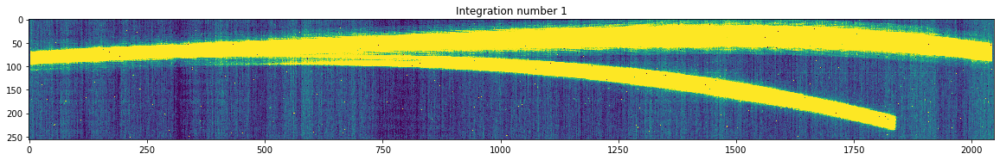

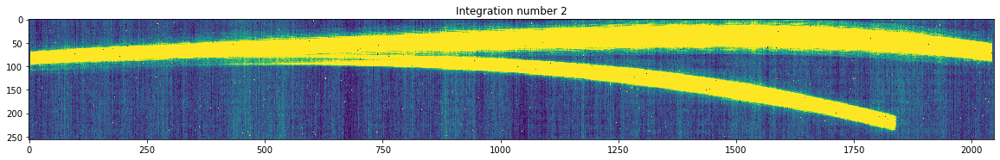

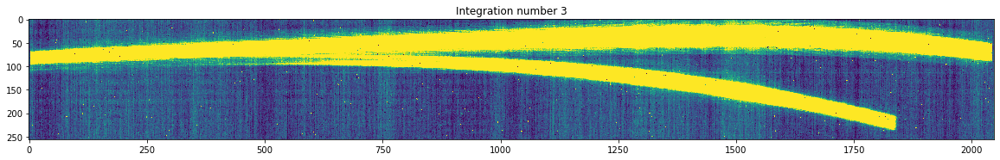

In [29]:
for i in range(3):
    plt.figure(figsize=(20,3))
    plt.title('Integration number ' + str(i+1))
    im = plt.imshow(hdul_rampstep['SCI'].data[i,:,:])
    im.set_clim(-1,3)

In [30]:
t1 = time.time()

All right! These look nice. As you see, there is some strips happening randomly on the columns of this image. This is the known 1/f noise component which occurs on the JWST detectors (and other IR detectors, of course!) --- which actually occurs at the group-level. We'll discuss later how to remove this. However --- this makes us happy because we now have a Stage 1 corrected product! Yay!

## 2. Spectroscopic processing: Stage 2 of the pipeline
---------------

We now jump to [Stage 2 --- the spectroscopic processing](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_spec2.html) of the data. For this excercise, we will skip most of the steps in Stage 2 as NIRISS/SOSS still does not have an extraction algorithm that can handle it's curved nature and the overlapping of the orders observed above. However, here we perform the the `assign_wcs` step, which will add a ton of metadata to our products, including the wavelength solution map:

In [31]:
for dataname in datanames:

    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
    input_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_rampfitstep.fits' 
    
    if not os.path.exists(output_filename):
        calwebb_spec2.assign_wcs_step.AssignWcsStep.call(input_filename, \
                                                         output_dir=output_folder, \
                                                         save_results=True)
    else:
        print('\t \t \t >> Assign WCS step outputs detected. Skipping...')

2021-05-02 13:31:10,162 - stpipe.AssignWcsStep - INFO - AssignWcsStep instance created.
2021-05-02 13:31:10,842 - stpipe.AssignWcsStep - INFO - Step AssignWcsStep running with args ('/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_CLEAR_mirage_consistent_superbiascorrected_1_rampfitstep.fits',).
2021-05-02 13:31:10,844 - stpipe.AssignWcsStep - INFO - Step AssignWcsStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': '/Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'slit_y_low': -0.55, 'slit_y_high': 0.55}
2021-05-02 13:31:13,295 - stpipe.AssignWcsStep - INFO - COMPLETED assign_wcs
2021-05-02 13:49:33,262 - stpipe.AssignWcsStep - INFO - Saved model in /Volumes/espinoza_backup/ERS-Simulations/pipeline_outputs/WASP43_NIS_SOSS-seg001_C

Now, with this product, let's extract the wavelength map directly and save it to a file:

In [32]:
for dataname in datanames:
    
    wav_map_fname = output_folder + dataname+'_wavmap.npy'
    wmaps = {}
    
    if not os.path.exists(wav_map_fname):
        
        output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
        hdul_wcs = fits.open(output_filename)
        exposure = datamodels.SpecModel(output_filename)
    
        rows, columns = hdul_wcs['SCI'].data[0,:,:].shape
        wavelength_maps = np.zeros([2,rows,columns])
        for order in [1,2]:
            for row in range(rows):
                for column in range(columns):
                    wavelength_maps[order-1,row,column] = exposure.meta.wcs(column, row, order)[-1]
        np.save(wav_map_fname, wavelength_maps)
        wmaps[dataname] = np.copy(wavelength_maps)
        
    else:
        
        wmaps[dataname] = np.load(wav_map_fname)

Let's plot it (again, only for the last segment of data --- both should have the exact same):

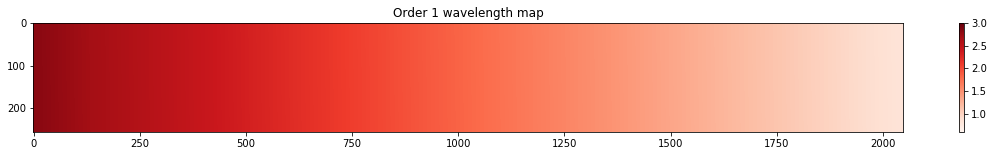

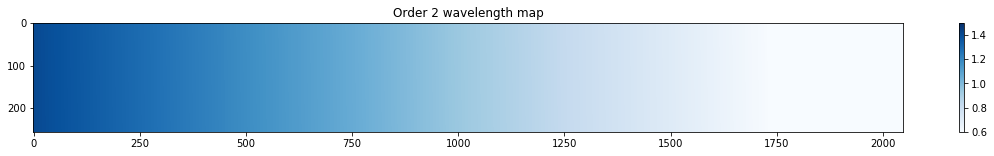

In [33]:
plt.figure(figsize=(20, 2))
plt.title('Order 1 wavelength map')
im1 = plt.imshow(wmaps[dataname][0,:,:])
im1.set_clim(0.6, 3.0)
im1.set_cmap('Reds')
cb1 = plt.colorbar()

plt.figure(figsize=(20, 2))
plt.title('Order 2 wavelength map')
im2 = plt.imshow(wmaps[dataname][1,:,:])
im2.set_clim(0.6, 1.5)
im2.set_cmap('Blues')
cb2 = plt.colorbar()

In [34]:
t2 = time.time()

## 3. Post-processing: from traces, to extracted spectra
-------

We now jump away from the JWST pipeline and work on our own, making our way towards an extracted spectrum. Here, we'll perform simple tracing and spectral extraction. 

### 3.1 Preamble 

Before jumping into our tracing and extraction, we create a dictionary in which we'll be saving all of our results:

In [35]:
data_dictionary = {}

The first thing we add to this dictionary are the times of our integrations. To this end, we extract them directly from our `assign_wcs` products. All the time-stamps are repeated on each of the segments, so we just use the first one to extract the times:

In [36]:
output_filename = output_folder+datanames[0]+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
hdul_wcs = fits.open(output_filename)
data_dictionary['times'] = hdul_wcs['INT_TIMES'].data['int_mid_BJD_TDB']

In [37]:
print(data_dictionary['times'].shape), print(data_dictionary['times'])

(420,)
[59818.53415495 59818.53460007 59818.53504519 59818.5354903
 59818.53593542 59818.53638053 59818.53682565 59818.53727076
 59818.53771588 59818.538161   59818.53860611 59818.53905123
 59818.53949634 59818.53994146 59818.54038657 59818.54083169
 59818.54127681 59818.54172192 59818.54216704 59818.54261215
 59818.54305727 59818.54350238 59818.5439475  59818.54439262
 59818.54483773 59818.54528285 59818.54572796 59818.54617308
 59818.54661819 59818.54706331 59818.54750843 59818.54795354
 59818.54839866 59818.54884377 59818.54928889 59818.549734
 59818.55017912 59818.55062424 59818.55106935 59818.55151447
 59818.55195958 59818.5524047  59818.55284981 59818.55329493
 59818.55374005 59818.55418516 59818.55463028 59818.55507539
 59818.55552051 59818.55596562 59818.55641074 59818.55685586
 59818.55730097 59818.55774609 59818.5581912  59818.55863632
 59818.55908144 59818.55952655 59818.55997167 59818.56041678
 59818.5608619  59818.56130701 59818.56175213 59818.56219725
 59818.56264236 5981

(None, None)

The times are, by default, on modified barycentric julian dates (i.e., minus `2400000.5`). Let's now move to tracing the spectra.

### 3.2 Tracing the spectra

#### 3.2.1 Initial data checks
To trace the spectrum we do simple centroiding. Below is a function that performs this simple centroiding by first applying a gaussian filter to the NIRISS/SOSS profile:

In [38]:
def trace_spectrum(image, dqflags, xstart, ystart, profile_radius=20, gauss_filter_width=10, xend=None):
    """
    Function that non-parametrically traces NIRISS/SOSS spectra. First, to get the centroid at xstart and 
    ystart, it convolves the spatial profile with a gaussian filter, finding its peak through usual flux-weighted 
    centroiding. Next, this centroid is used as a starting point to find the centroid of the left column through 
    the same algorithm. 
    
    Parameters
    ----------
    image: ndarray
        The image that wants to be traced.
    dqflags: ndarray
        The data quality flags for each pixel in the image. Only pixels with DQ flags of zero will be used 
        in the centroiding.
    xstart: float
        The x-position (column) on which the tracing algorithm will be started
    ystart: float
        The estimated y-position (row) of the center of the trace. An estimate within 10-20 pixels is enough.
    profile_radius: float
        Expected radius of the profile measured from its center. Only this region will be used to estimate 
        the centroids of the spectrum.
    gauss_filter_width: float
        Width of the gaussian filter used to perform the centroiding of the first column
    xend: int
        x-position at which tracing ends. If none, trace all the columns left to xstart.
    """
    
    # Define x-axis:
    if xend is not None:
        x = np.arange(xend, xstart + 1)
    else:
        x = np.arange(0, xstart + 1)
        
    # Define y-axis:
    y = np.arange(image.shape[0])
    
    # Define status of good/bad for each centroid:
    status = np.full(len(x), True, dtype=bool)
    
    # Define array that will save centroids at each x:
    ycentroids = np.zeros(len(x))
    
    for i in range(len(x))[::-1]:
        xcurrent = x[i]
        
        # Extract data-quality flags for current column; index good pixels:
        idx_good = np.where(dqflags[:,xcurrent] == 0)[0]        
        
        if len(idx_good) > 0:
            # Convolve column with a gaussian filter; remove median before convolving:
            filtered_column = gaussian_filter1d(image[idx_good,xcurrent] - \
                                                np.median(image[idx_good,xcurrent]), gauss_filter_width)
        
            # Find centroid within profile_radius pixels of the initial guess:
            idx = np.where(np.abs(y[idx_good]-ystart) < profile_radius)[0]
            ycentroids[i] = np.sum(y[idx_good][idx]*filtered_column[idx])/np.sum(filtered_column[idx])
            ystart = ycentroids[i]
        else:
            print(xcurrent,'is false')
            status[i] = False
    
    # Return only good centroids:
    idx_output = np.where(status)[0]
    return x[idx_output], ycentroids[idx_output]

Let's apply this to the first integration of the second segment, just to get used to the output. Let's trace Order 1 first, and start from column 2042. We start with column 2042, i.e., pixel 2043, because pixels 2045, 2046, 2047 and 2048 are reference pixels (i.e., not sensitive to light) and the edge pixels (like 2044) seem to behave a bit differently than the rest, so we ommit them. Let's plot the profile at that column to see, more or less, where the center of the profile actually is:

(0, 255)

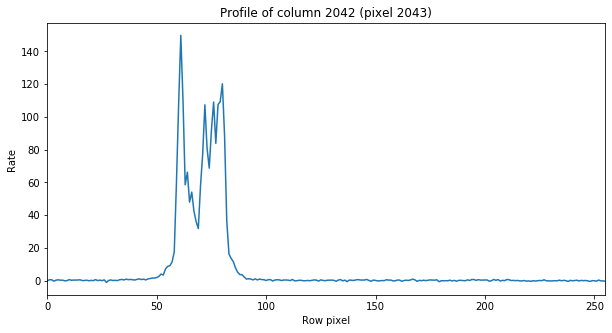

In [39]:
plt.figure(figsize=(10,5))
plt.title('Profile of column 2042 (pixel 2043)')
plt.plot(hdul_wcs['SCI'].data[0,:,2042])
plt.xlabel('Row pixel')
plt.ylabel('Rate')
plt.xlim(0,255)

It seems the profile centroid is around row 70. Let's use that to start the algorithm and trace this integration's profile. Note we trace the spectra down to column 5 --- i.e., we only trace down to the 6th pixel. This is because pixels 1 through 4 (i.e., python indexes 0 through 3) are the left-hand reference pixels, and similarly to the above points, pixel number 5 also behaves weirdly:

In [40]:
xcen, ycen = trace_spectrum(hdul_wcs['SCI'].data[0,:,:], hdul_wcs['DQ'].data[0,:,:], 2042, 70, xend = 5)

Let's plot this:

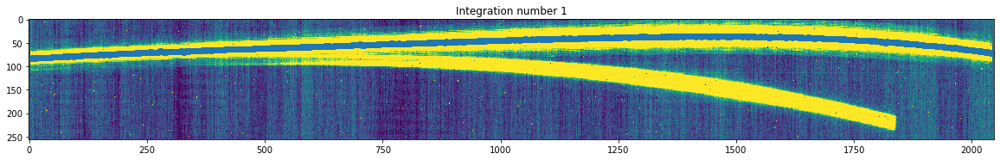

In [41]:
plt.figure(figsize=(20,3))
plt.title('Integration number 1')
im = plt.imshow(hdul_wcs['SCI'].data[0,:,:])
plt.plot(xcen,ycen,'o')
im.set_clim(-1,3)

That looks pretty good! Let's try the same thing for order 2 on the same integration. Let's first plot the profile to check our initial guess. We start our profiling in column 1840 (pixel 1841); in real data, the profile will not start here --- this is just a particularity of the simulations:

(0, 10)

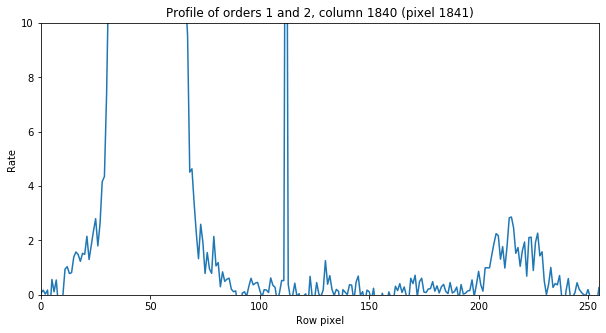

In [42]:
plt.figure(figsize=(10,5))
plt.title('Profile of orders 1 and 2, column 1840 (pixel 1841)')
plt.plot(hdul_wcs['SCI'].data[0,:,1840])
plt.xlabel('Row pixel')
plt.ylabel('Rate')
plt.xlim(0,255)
plt.ylim(0,10)

All right, it seems the profile peak is around row 220. Now, it is important to consider that because order 2 is mostly fainter than order 1, our algorithm is doomed to get confused with order 1 at columns lower than about 1000. Also, we should probably end the tracing for order 2 with our algorithm at least around column 500. Let's see how the profile looks like at that column, and compare it against, say, column 800:

(0, 255)

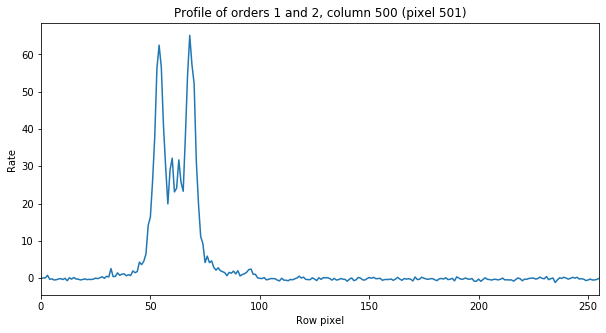

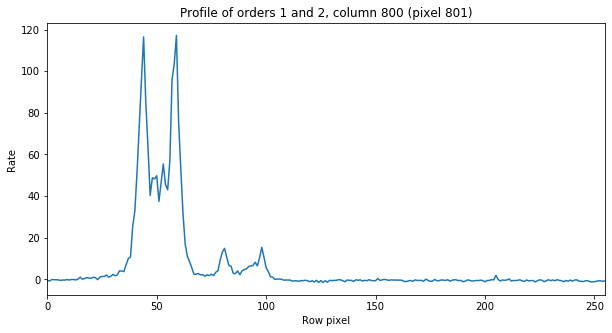

In [43]:
plt.figure(figsize=(10,5))
plt.title('Profile of orders 1 and 2, column 500 (pixel 501)')
plt.plot(hdul_wcs['SCI'].data[0,:,500])
plt.xlabel('Row pixel')
plt.ylabel('Rate')
plt.xlim(0,255)

plt.figure(figsize=(10,5))
plt.title('Profile of orders 1 and 2, column 800 (pixel 801)')
plt.plot(hdul_wcs['SCI'].data[0,:,800])
plt.xlabel('Row pixel')
plt.ylabel('Rate')
plt.xlim(0,255)

As can be seen, order 2 is almost indistinguishable at column 500 from order 1. To help our algorithm find the centers down to this column we will pass it a cutted integration from row 75 up to row 256. We pass then as the starting row, 220 minus 75. Let's see how we do with this:

In [44]:
# Perform centroiding on cutted image:
xcen2, ycen2 = trace_spectrum(hdul_wcs['SCI'].data[0,75:,:], hdul_wcs['DQ'].data[0,75:,:], 1840, 220-75, xend = 500)
# Fix centroid to match real, physical image:
ycen2 += 75

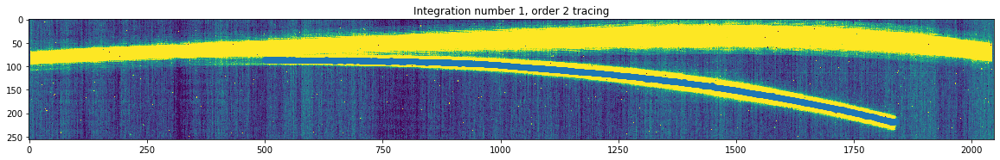

In [45]:
plt.figure(figsize=(20,3))
plt.title('Integration number 1, order 2 tracing')
im = plt.imshow(hdul_wcs['SCI'].data[0,:,:])
plt.plot(xcen2,ycen2,'o')
im.set_clim(-1,3)

Woah --- that's pretty good! Let's plot both traces only, without the image:

Text(0.5, 0, 'Column')

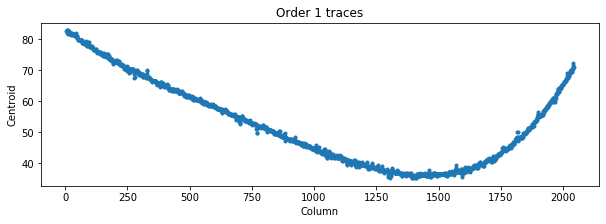

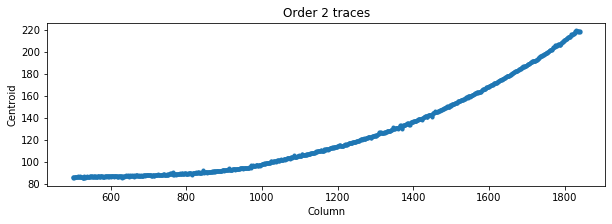

In [46]:
plt.figure(figsize=(10,3))
plt.title('Order 1 traces')
plt.plot(xcen,ycen,'.')
plt.ylabel('Centroid')
plt.xlabel('Column')

plt.figure(figsize=(10,3))
plt.title('Order 2 traces')
plt.plot(xcen2,ycen2,'.')

plt.ylabel('Centroid')
plt.xlabel('Column')

These traces look pretty nice and smooth. Let's fit them with a polynomial --- let's try several orders and find the best. We use a Chebyshev polynomial:

In [47]:
def select_cheby_order(x, y, min_order, max_order):
    """
    This function selects (and returns) the optimal order of a Chebyshev polynomial using the BIC.
    
    Parameters
    ----------
    x: ndarray
        Array with the regressors
    y: ndarray
        Array with the data
    min_order: int
        Minimum order to try
    max_order: int
        Maximum order to try
    """
    orders = np.arange(min_order, max_order)
    bics = np.zeros(len(orders))
    
    # Fit only non-nans:
    idx = np.where(~np.isnan(y))[0]
    n = len(idx)
    
    for i in range(len(orders)):
        order = orders[i]
        coeffs = chebyshev.chebfit(x[idx], y[idx], deg=order)
        RSS = np.sum((y - chebyshev.chebval(x[idx], coeffs))**2)
        bics[i] = n * np.log(RSS / n) + (order + 1) * np.log(n)
    idx = np.where(np.min(bics) == bics)[0]
    return orders[idx][0]

In [48]:
deg1 = select_cheby_order(xcen, ycen, 1, 30)
print('BIC-selected order for order 1:', deg1)
deg2 = select_cheby_order(xcen2, ycen2, 1, 30)
print('BIC-selected order for order 2:', deg2)

2021-05-02 15:00:09,044 - stpipe - WARNING - /Users/nespinoza/.local/lib/python3.7/site-packages/numpy/polynomial/chebyshev.py:1673: RankWarning: The fit may be poorly conditioned
  return pu._fit(chebvander, x, y, deg, rcond, full, w)



BIC-selected order for order 1: 8
BIC-selected order for order 2: 21


Let's plot these results:

2021-05-02 15:00:09,127 - stpipe - WARNING - /Users/nespinoza/.local/lib/python3.7/site-packages/numpy/polynomial/chebyshev.py:1673: RankWarning: The fit may be poorly conditioned
  return pu._fit(chebvander, x, y, deg, rcond, full, w)



Text(0.5, 0, 'Column')

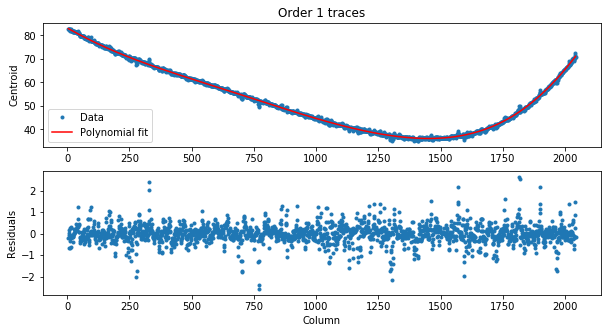

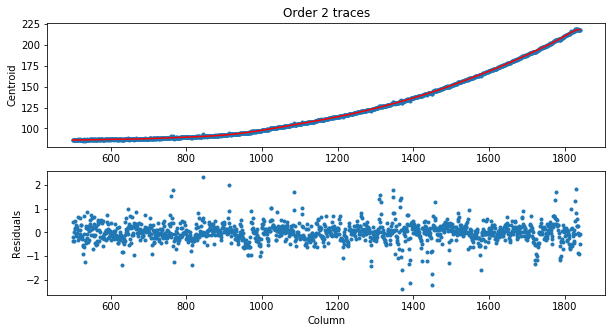

In [49]:
plt.figure(figsize=(10,5))

plt.subplot(211)
plt.title('Order 1 traces')
plt.plot(xcen,ycen,'.',label='Data')
coeffs1 = chebyshev.chebfit(xcen, ycen, deg1)
plt.plot(xcen,chebyshev.chebval(xcen, coeffs1),'r-',label='Polynomial fit')
plt.legend()
plt.ylabel('Centroid')

plt.subplot(212)
plt.plot(xcen,ycen - chebyshev.chebval(xcen, coeffs1),'.')
plt.ylabel('Residuals')
plt.xlabel('Column')

plt.figure(figsize=(10,5))
plt.subplot(211)
plt.title('Order 2 traces')
plt.plot(xcen2,ycen2,'.')
coeffs2 = chebyshev.chebfit(xcen2, ycen2, deg2)
plt.plot(xcen2,chebyshev.chebval(xcen2, coeffs2),'r-')
plt.ylabel('Centroid')

plt.subplot(212)
plt.plot(xcen2,ycen2 - chebyshev.chebval(xcen2, coeffs2),'.')
plt.ylabel('Residuals')
plt.xlabel('Column')

Those look pretty good! While the order 2 polynomial seems definitely too high (and perhaps a better choice would be a spline in a real dataset), we consider ourselves content with these orders for now and repeat this same procedure on all the integrations of all segments.

#### 3.2.2 Tracing all the integrations

We now apply the methos defined above on all the integrations, saving the results to our dictionary. Note that this takes a while (about three minutes in my Macbook Pro laptop):

In [50]:
# Set starting columns and rows for each order; set ending column:
xstart1, ystart1, xend1 = 2042, 70, 5
xstart2, ystart2, xend2 = 1840, 220, 500

# Define row to cut image for order 2 tracing (see section 3.2.1)
ycut = 75

# Iterate through our segments:
for dataname in datanames:
    
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
    hdul_wcs = fits.open(output_filename)
    
    # Iterate through all the integrations on the segment:
    for i in range(hdul_wcs['SCI'].data.shape[0]):
        
        # Extract science data, DQ flags for the current integration:
        image, dqflags = hdul_wcs['SCI'].data[i,:,:], hdul_wcs['DQ'].data[i,:,:]
        
        # Trace the spectra for order 1; fit polynomial to centroids:
        xcen1, ycen1 = trace_spectrum(image, dqflags, xstart1, ystart1, xend = xend1)
        coeffs1 = chebyshev.chebfit(xcen1, ycen1, deg1)
        
        # Repeat for order 2; note we cut-the image:
        xcen2, ycen2 = trace_spectrum(image[ycut:, :], dqflags[ycut:, :], xstart2, ystart2 - ycut, xend = xend2)
        ycen2 += ycut
        coeffs2 = chebyshev.chebfit(xcen2, ycen2, deg2)
        
        # Save to data_dictinoary. If `traces` key not in the dictionary, create it:
        if 'traces' not in data_dictionary.keys():
            data_dictionary['traces'] = {}
            
            # Create key that will save the actual centroids for order 1: 
            data_dictionary['traces']['x1'] = []
            data_dictionary['traces']['y1'] = []
            
            # Same for order 2:
            data_dictionary['traces']['x2'] = []
            data_dictionary['traces']['y2'] = []
            
            # Coefficients:
            data_dictionary['traces']['coeffs1'] = []
            data_dictionary['traces']['coeffs2'] = []
            
        # Append centroids for each order:
        data_dictionary['traces']['x1'].append(np.copy(xcen1))
        data_dictionary['traces']['y1'].append(np.copy(ycen1))
                                               
        data_dictionary['traces']['x2'].append(np.copy(xcen2))
        data_dictionary['traces']['y2'].append(np.copy(ycen2))
                                         
        # Append coefficients for each order:
        data_dictionary['traces']['coeffs1'].append(np.copy(coeffs1))
        data_dictionary['traces']['coeffs2'].append(np.copy(coeffs2))                                             

2021-05-02 15:00:10,594 - stpipe - WARNING - /Users/nespinoza/.local/lib/python3.7/site-packages/numpy/polynomial/chebyshev.py:1673: RankWarning: The fit may be poorly conditioned
  return pu._fit(chebvander, x, y, deg, rcond, full, w)



Let's plot all the fitted traces to see how they look like:

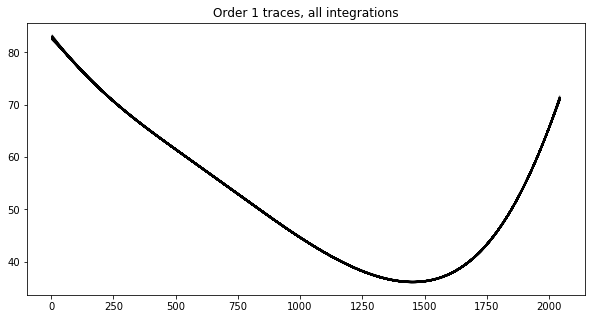

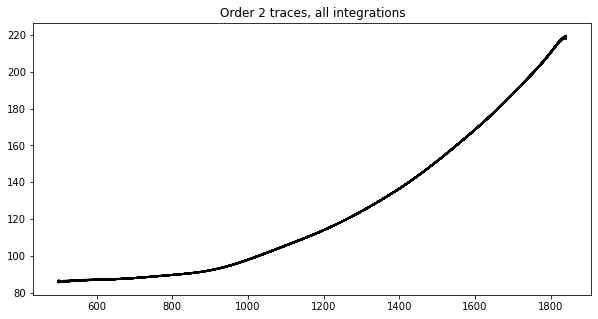

In [51]:
plt.figure(figsize=(10,5))
plt.title('Order 1 traces, all integrations')
for i in range(len(data_dictionary['traces']['coeffs1'])):
    x = data_dictionary['traces']['x1'][i]
    coeff = data_dictionary['traces']['coeffs1'][i]
    plt.plot(x, chebyshev.chebval(x, coeff), color = 'black', alpha = 0.5)
    
plt.figure(figsize=(10,5))
plt.title('Order 2 traces, all integrations')
for i in range(len(data_dictionary['traces']['coeffs2'])):
    x = data_dictionary['traces']['x2'][i]
    coeff = data_dictionary['traces']['coeffs2'][i]
    plt.plot(x, chebyshev.chebval(x, coeff), color = 'black', alpha = 0.5)

In [52]:
t3 = time.time()

That looks pretty nice! All right, let's now jump to spectral extraction. 

### 3.3 Spectral extraction

#### 3.3.1 Handling 1/f noise
Before jumping into the actual spectral extraction, we aim to remove part of the 1/f noise present on each of the integrations, as was shown at the end of Section 1. To attempt to remove this from the images, we use our traces to mask pixels containing the flux from our target, and remove the median of each column to the image. This reduces (but not completely removes) the 1/f noise from the images. 

Let's see how this simple procedure works on the first three integrations of the first segment of our data. Let's first show the uncorrected integrations:

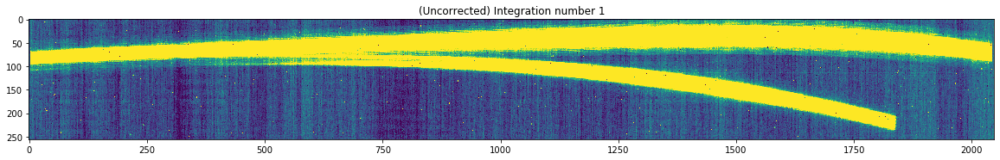

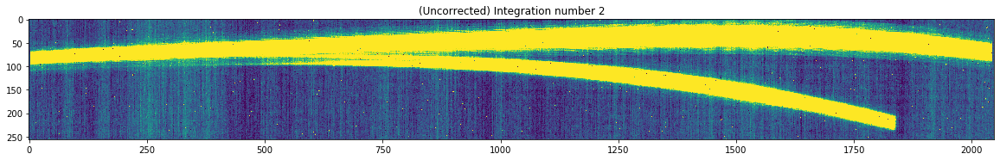

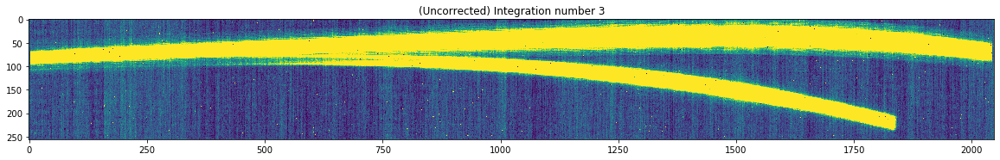

In [53]:
output_filename = output_folder+datanames[0]+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
hdul_wcs = fits.open(output_filename)

for i in range(3):
    plt.figure(figsize=(20,3))
    plt.title('(Uncorrected) Integration number ' + str(i+1))
    im = plt.imshow(hdul_wcs['SCI'].data[i,:,:])
    im.set_clim(-1,3)

Let's now correct them using the simple column-by-column substraction procedure, masking the flux from the target spectrum with a 30-pixel radius around the trace. First, let's write a function that performs this correction given the data and the coefficients of the traces:

In [54]:
def handle_1fnoise(image, coeff1, coeff2, radius = 30):
    
    corrected_image = np.copy(image)
    x = np.arange(image.shape[1])
    y = np.arange(image.shape[0])
    
    # Evaluate all centroids:
    ycentroids1 = chebyshev.chebval(x, coeff1)
    ycentroids2 = chebyshev.chebval(x, coeff2)
    
    # Iterate through columns; dont touch reference pixels, nor pixels adjacent to reference pixels:
    for i in range(5, image.shape[1]-5):
        
        # For columns larger than 500, use trace of order 2 as well --- up to column 1850
        if i > xend2 and i < xstart2:
            idx = np.where( (np.abs(y-ycentroids1[i]) > radius) & (np.abs(y-ycentroids2[i]) > radius))[0]
        else:
            idx = np.where( np.abs(y-ycentroids1[i]) > radius)[0]
            
        corrected_image[:, i] -= np.median(image[idx, i])
        
    return corrected_image

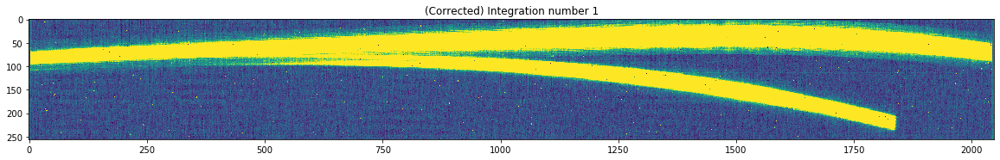

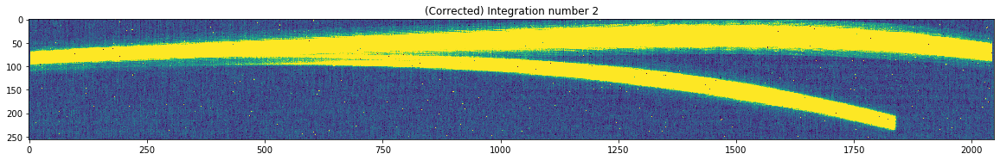

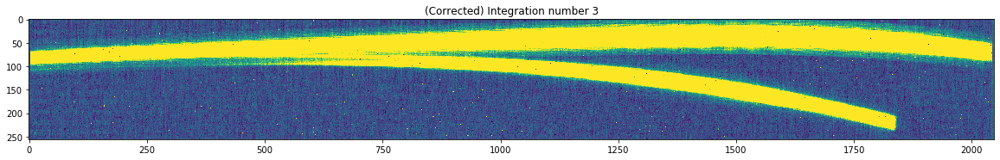

In [55]:
for i in range(3):
    plt.figure(figsize=(20,3))
    plt.title('(Corrected) Integration number ' + str(i+1))
    
    corrected_image = handle_1fnoise(hdul_wcs['SCI'].data[i,:,:], \
                                     data_dictionary['traces']['coeffs1'][i], \
                                     data_dictionary['traces']['coeffs2'][i])
    
    im = plt.imshow(corrected_image)
    im.set_clim(-1,3)

Much better. Let's use this handy function to correct the rest of the integrations and extract the spectra next.

#### 3.3.2 Extracting all the spectra

All right, now we are ready to extract the spectra. Below is a function to perfrom this extraction:

In [56]:
def aperture_extraction(image, x, y, aperture_radius, background_radius=50, error_image=None, correct_bkg=True):
    """
    This function takes as inputs two arrays (x,y) that follow the trace, 
    and returns the added flux over the defined aperture radius (and its error, if an error image 
    is given as well), substracting in the way any background between the aperture radius and the 
    background radius. The background is calculated by taking the median of the points between the 
    aperture_radius and the background_radius.
    Parameters
    ----------
    image: ndarray
        Image from which the spectrum wants to be extracted
    x: ndarray
        Array with the x-axis of the trace (i.e., the columns, wavelength direction)
    y: ndarray
        Array with the y-axis of the trace (i.e., rows, spatial direction)
    aperture_radius: float
        Distance from the center of the trace at which you want to add fluxes.
    background_radius: float
        Distance from the center of the trace from which you want to calculate the background. The 
        background region will be between this radius and the aperture_radius.
    error_image: ndarray
        Image with the errors of each pixel value on the image ndarray above
    correct_bkg: boolean
        If True, apply background correction. If false, ommit this.
    """
    # Create array that will save our fluxes:
    flux = np.zeros(len(x))
    if error_image is not None:
        flux_error = np.zeros(len(x))
    max_column = image.shape[0]
    for i in range(len(x)):
        # Cut the column with which we'll be working with:
        column = image[:,int(x[i])]
        if error_image is not None:
            variance_column = error_image[:,int(x[i])]**2
        # Define limits given by the aperture_radius and background_radius variables:
        if correct_bkg:
            left_side_bkg = np.max([y[i] - background_radius, 0])
            right_side_bkg = np.min([max_column, y[i] + background_radius])
        left_side_ap = np.max([y[i] - aperture_radius, 0])
        right_side_ap = np.min([max_column, y[i] + aperture_radius])
        # Extract background, being careful with edges:
        if correct_bkg:
            bkg_left = column[np.max([0, int(left_side_bkg)]) : np.max([0, int(left_side_ap)])]
            bkg_right = column[np.min([int(right_side_ap), max_column]) : np.max([int(right_side_bkg), max_column])]
            bkg = np.median(np.append(bkg_left, bkg_right))
        else:
            bkg = 0.
        # Substract it from the column:
        column -= bkg
        # Perform aperture extraction of the background-substracted column, being careful with pixelization 
        # at the edges. First, deal with left (up) side:
        l_decimal, l_integer = np.modf(left_side_ap)
        l_integer = int(l_integer)
        if l_decimal < 0.5:
            l_fraction = (0.5 - l_decimal) * column[l_integer]
            l_limit = l_integer + 1
            if error_image is not None:
                l_fraction_variance = ((0.5 - l_decimal)**2) * variance_column[l_integer]
        else:
            l_fraction = (1. - (l_decimal - 0.5)) * column[l_integer + 1]
            l_limit = l_integer + 2
            if error_image is not None:
                l_fraction_variance = ((1. - (l_decimal - 0.5))**2) * variance_column[l_integer + 1]
        # Now right (down) side:
        r_decimal, r_integer = np.modf(right_side_ap)
        r_integer = int(r_integer)
        if r_decimal < 0.5:
            r_fraction = (1. - (0.5 - r_decimal)) * column[r_integer]
            r_limit = r_integer
            if error_image is not None:
                r_fraction_variance = ((1. - (0.5 - r_decimal))**2) * variance_column[r_integer]
        else:
            r_fraction = (r_decimal - 0.5) * column[r_integer + 1]
            r_limit = r_integer + 1
            if error_image is not None:
                r_fraction_variance = ((r_decimal - 0.5)**2) * variance_column[r_integer + 1]
        # Save total flux in current column:
        flux[i] = l_fraction + r_fraction + np.sum(column[l_limit:r_limit])
        if error_image is not None:
            # Total error is the sum of the variances:
            flux_error[i] = np.sqrt(np.sum(variance_column[l_limit:r_limit]) + l_fraction_variance + \
                                    r_fraction_variance)
    if error_image is not None:
        return flux, flux_error
    else:
        return flux


And let's use this function together with the fitted traces to extract all the spectra! Note we also pass the error image below, to get errors on the spectra. Again, this also will take a while (about 3 minutes as well on my Macbook Pro laptop). Note we will be saving the 1/f-corrected images, the data-quality image and the error images in an array (you will see below why):

In [57]:
# Set the columns on which we will extract order 1 and 2 spectra:
x1 = np.arange(xend1, xstart1+1)
x2 = np.arange(xend2, xstart2+1)

# Define spectral extraction radius:
aperture_radius = 30

# Create array that will save the data cubes for the 1/f-"corrected" images, errors and data-quality flags:
nintegrations = len(data_dictionary['traces']['coeffs1'])
images = np.zeros([nintegrations, 256, 2048])
dq_images = np.zeros([nintegrations, 256, 2048])
error_images = np.zeros([nintegrations, 256, 2048])

# Define an integration counter --- useful to link the extractions to the traces:
icounter = 0

# Iterate through our segments:
for dataname in datanames:
    
    output_filename = output_folder+dataname+'_'+special_prefix+'superbiascorrected_1_assignwcsstep.fits'
    hdul_wcs = fits.open(output_filename)
    
    # Iterate through all the integrations on the segment:
    for i in range(hdul_wcs['SCI'].data.shape[0]):
        
        # Extract science data and error matrix:
        image, error_image, dq_image = hdul_wcs['SCI'].data[i,:,:], \
                                       hdul_wcs['ERR'].data[i,:,:], \
                                       hdul_wcs['DQ'].data[i,:,:]
        
        # Extract coefficients for order 1 and 2:
        coeff1, coeff2 = data_dictionary['traces']['coeffs1'][icounter], \
                         data_dictionary['traces']['coeffs2'][icounter]
        
        # Correct image from 1/f noise and save it along with DQ flags and error image:
        images[icounter, :, :] = handle_1fnoise(image, coeff1, coeff2)
        dq_images[icounter, :, :] = np.copy(dq_image)
        error_images[icounter, :, :] = np.copy(error_image)
        
        # Extract order 1 spectra:
        y1 = chebyshev.chebval(x1, coeff1)
        spectrum1 = aperture_extraction(images[icounter, :, :], x1, y1, aperture_radius, error_image=error_image)
        
        # Same for order 2:
        y2 = chebyshev.chebval(x2, coeff2)
        spectrum2 = aperture_extraction(images[icounter, :, :], x2, y2, aperture_radius, error_image=error_image)        
        
        # Save to data_dictinoary. If `spectra` key not in the dictionary, create it:
        if 'spectra' not in data_dictionary.keys():
            data_dictionary['spectra'] = {}
            
            # Create pixel arrays that apply to each extracted column:
            data_dictionary['spectra']['pixel1'] = x1 
            data_dictionary['spectra']['pixel2'] = x2
            
            # Create key that will save each order's spectra:
            data_dictionary['spectra']['order1'] = []
            data_dictionary['spectra']['order2'] = []
            
        # Append extracted spectra
        data_dictionary['spectra']['order1'].append(np.copy(spectrum1))
        data_dictionary['spectra']['order2'].append(np.copy(spectrum2))    
        
        icounter += 1

Let's check the spectra of the very first integration:

(0, 6000)

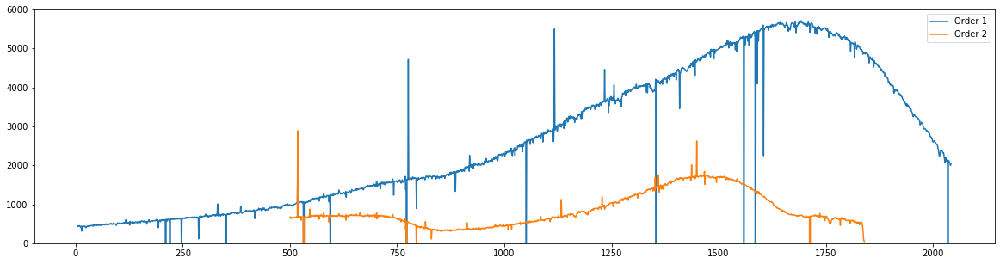

In [58]:
plt.figure(figsize=(20,5))

plt.plot(data_dictionary['spectra']['pixel1'], data_dictionary['spectra']['order1'][0][0], label = 'Order 1')
plt.plot(data_dictionary['spectra']['pixel2'], data_dictionary['spectra']['order2'][0][0], label = 'Order 2')
plt.legend()
plt.ylim(0,6000)

That looks pretty good except, of course, for some outlier pixels due to cosmic rays/bad pixels.

The JWST pipeline in theory has two "shields" against cosmic-rays. The first line of defense is the `jump` step, which we already encountered in Stage 1 (see Section 1 of this notebook). However, there we already left a large treshold to detect outliers because that step is overly agressive at the moment. In [Stage 3 of the TSO pipeline (which we didn't use in this Notebook)](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_tso3.html), there is a second line of defense with an outlier-detection algorithm that takes advantage of the time-series nature of the observations. These at the time of writing of this notebook, however, are not implemented yet. Here, thus, we implement our own outlier-detection algorithm to take care of cosmic rays.

#### 3.3.3 Cosmic-ray identification and correction

The algorithm we implement here is a modified (a.k.a., "simpler") version of the cosmic-ray rejection algorithm of [Nikolov et al. 2014](https://ui.adsabs.harvard.edu/abs/2014MNRAS.437...46N/abstract) used to identify and correct cosmic-rays in Hubble Space Telescope time-series observations in various studies.

To _identify_ cosmic-rays, we take advantage of the fact that the time series of every pixel is more or less flat. Let's take, for instance, a random pixel --- say pixel (42,42), and plot it's time series:

Text(0.5, 0, 'Time since first observation (hours)')

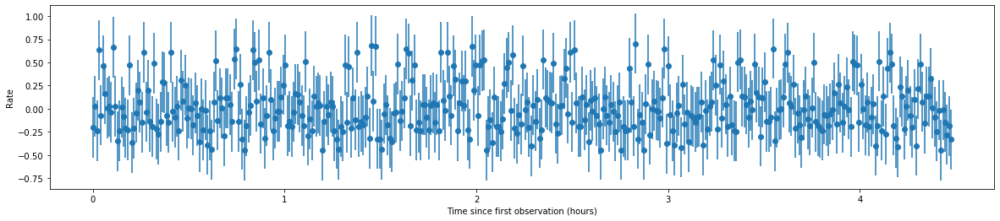

In [59]:
plt.figure(figsize=(20,4))

plt.errorbar((data_dictionary['times'] - data_dictionary['times'][0])*24, \
             images[:, 42, 42], \
             error_images[:, 42, 42], \
             fmt = 'o')

plt.ylabel('Rate')
plt.xlabel('Time since first observation (hours)')

What about a more interesting pixel --- say one that has flux? Let's try pixel (42, 1500) for instance:

Text(0.5, 0, 'Time since first observation (hours)')

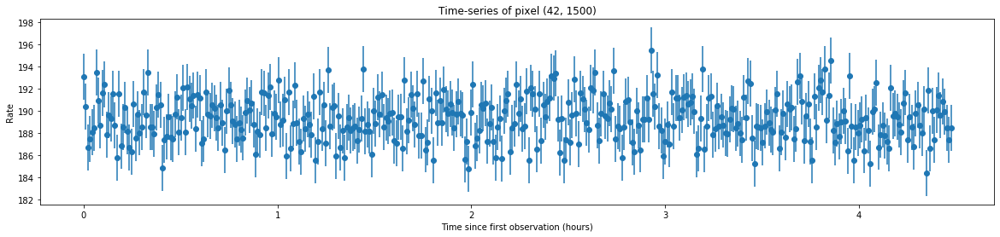

In [60]:
plt.figure(figsize=(20,4))

plt.title('Time-series of pixel (42, 1500)')
plt.errorbar((data_dictionary['times'] - data_dictionary['times'][0])*24, \
             images[:, 42, 1500], \
             error_images[:, 42, 1500], \
             fmt = 'o')

plt.ylabel('Rate')
plt.xlabel('Time since first observation (hours)')

Flat as the plains of Kansas! This observation allows us to come-up with a simple, yet effective algorithm: simply look at the time-series of each of the pixels in the image, and look for pixels that are $n-$sigma away from the average pixel. This way, we can form a cosmic-ray mask. 

Let's generate this cosmic-ray mask below; we use an $n=5$:

In [61]:
cr_pixel_mask = np.zeros([nintegrations, 256, 2048])
nsigma_cr = 5

for row in range(images.shape[1]):
    for column in range(images.shape[2]):
        
        # Calculate the median flux of all pixels:
        median_flux = np.median(images[:, row, column])
        
        # Use the median-absolute deviation to identify outliers as the measure of per-point error:
        mad_sigma = 1.4826 * np.median(np.abs(images[:, row, column] - np.median(images[:, row, column])))
            
        # Identify where there are pixels n-sigma away from these:
        idx = np.where(np.abs(median_flux - images[:, row, column])/mad_sigma > nsigma_cr)[0]
        
        # If outliers, save them to the bad-pixel mask:
        for i in idx:
            cr_pixel_mask[i, row, column] = 1

Let's plot this mask for the first three integrations:

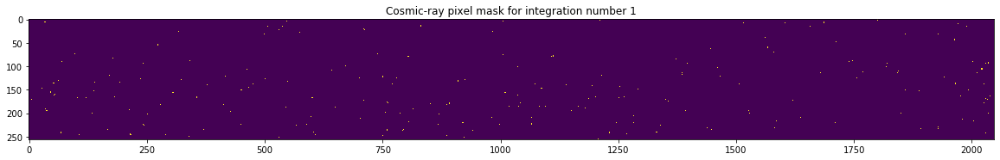

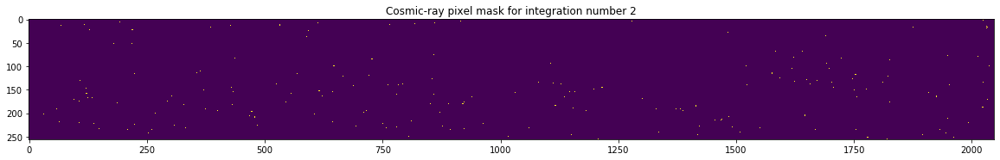

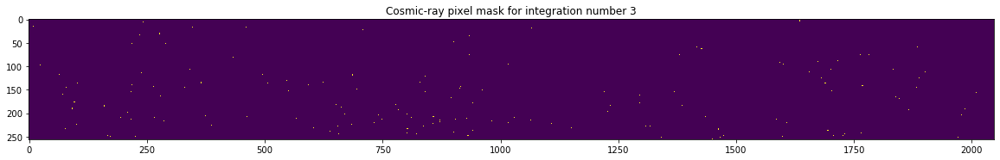

In [62]:
for i in range(3):
    plt.figure(figsize=(20,3))
    plt.title('Cosmic-ray pixel mask for integration number ' + str(i+1))
    
    im = plt.imshow(cr_pixel_mask[i, :, :])
    im.set_clim(0,1)

All right, that looks promising. Let's check some of the first integration:

In [63]:
idxs = np.where(cr_pixel_mask[0, :, :] == 1)
for i in range(len(idxs[0])):
    print(idxs[0][i], idxs[1][i])

0 998
1 129
1 997
1 999
2 130
2 998
2 1212
2 1801
2 1802
3 422
3 604
3 1087
3 1803
4 547
4 1006
4 1088
4 1521
4 1523
5 34
5 733
5 1522
5 1884
5 2029
6 33
6 35
6 1687
7 34
7 1569
7 1688
7 1864
8 1516
8 1604
8 1687
9 910
10 1183
10 1971
12 318
12 755
12 1164
12 1933
13 832
13 1163
14 831
14 833
14 1164
15 507
15 538
15 832
15 1658
15 1990
16 569
16 1490
16 1595
16 1663
18 35
20 47
20 568
20 712
20 1183
21 711
21 713
22 313
22 531
22 712
23 1891
24 1607
25 197
25 317
26 27
26 318
26 984
27 1047
28 575
29 30
29 1047
30 776
32 500
32 1859
32 1929
33 1018
36 384
38 416
38 594
38 1181
38 1211
39 1562
40 88
41 596
42 552
42 1964
43 553
43 1963
43 1965
44 1964
45 1298
45 1844
47 1385
48 761
48 1713
49 806
51 1354
53 274
54 275
54 1222
54 1243
55 274
56 1582
57 594
58 826
58 1380
58 1460
59 330
59 1568
60 479
60 579
60 702
60 770
61 1568
62 1136
62 1988
63 458
63 1446
65 769
65 1837
68 1016
70 1580
71 1530
71 1588
71 1599
71 1919
72 95
72 1526
72 1528
73 79
73 739
74 98
74 740
74 1005
74 1603
75

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



All right, so in row 56, column 1582 there seems to be one in the first integration. Let's plot the time-series of that pixel:

Text(0.5, 0, 'Time since first observation (hours)')

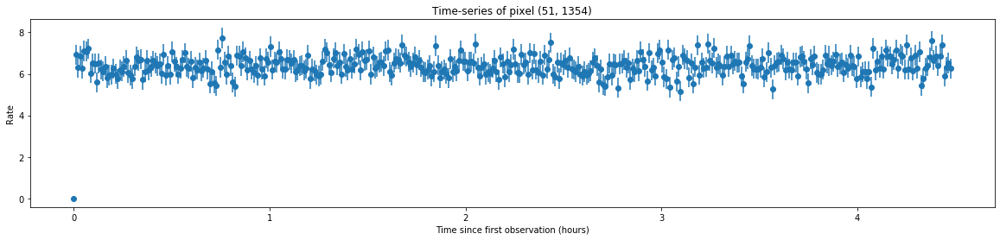

In [64]:
plt.figure(figsize=(20,4))

plt.title('Time-series of pixel (51, 1354)')
plt.errorbar((data_dictionary['times'] - data_dictionary['times'][0])*24, \
             images[:, 56, 1582], \
             error_images[:, 56, 1582], \
             fmt = 'o')


plt.ylabel('Rate')
plt.xlabel('Time since first observation (hours)')

Bingo! From this first pass, it seems this cosmic-ray identification works decently well then. 

Before moving on, it is important to also deal with the data-quality flags. [The values for each data-quality flux represents a particular behavior of a given pixel](https://jwst-pipeline.readthedocs.io/en/latest/jwst/references_general/references_general.html#data-quality-flags). In particular, DQ values of 4 represent outliers detected using the `jump` step, for instance. Of interest as well to our application are bad pixels, which have a value of 1, saturated pixels, which have a value of 2, and all pixels with values larger or equal than 32 --- which are essentially bad pixels as well. We'll deal with these later. We first handle the outliers/cosmic-rays.

Here, we will add all DQ flags of 4 to our cosmic-ray pixel mask (in fact, some of them might be the same):

In [65]:
for row in range(images.shape[1]):
    for column in range(images.shape[2]):
        idx = np.where(dq_images[:, row, column] == 4)[0]
        if len(idx) > 0:
            cr_pixel_mask[idx, row, column] = 1

Let's see how this changes the cosmic-ray pixel masks plotted above:

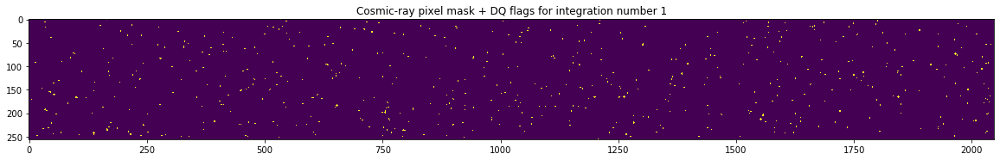

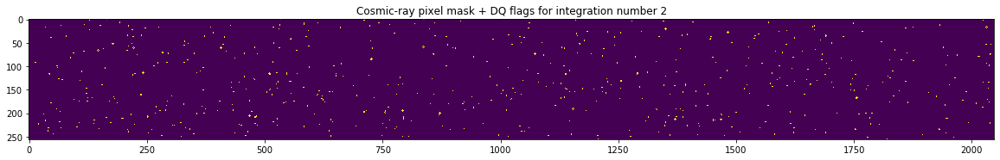

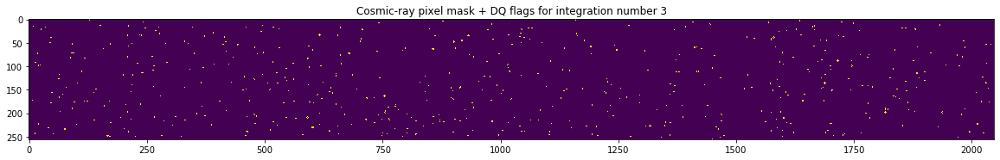

In [66]:
for i in range(3):
    plt.figure(figsize=(20,3))
    plt.title('Cosmic-ray pixel mask + DQ flags for integration number ' + str(i+1))
    
    im = plt.imshow(cr_pixel_mask[i, :, :])
    im.set_clim(0,1)

Significantly more pixels! They are all mostly in random locations as well.

Now, how do we correct these fluxes? Here we use a very simple version of the algorithm proposed in [Nikolov et al. 2014](https://ui.adsabs.harvard.edu/abs/2014MNRAS.437...46N/abstract). We simply use the integration inmediatly before the current one to correct the pixel. To this end, we use the three columns to the right and three to the left, calculate the scaling of the flux between the exposures, and scale the pixel flux to the cosmic-ray hit integration to correct the flux. Note this procedure will leave bad pixels with the same values. For differential spectrophotometry, this is OK.

A handful of lines of code are better than a thousand words:

In [67]:
corrected_images = np.copy(images)
corrected_images_err = np.copy(error_images)

for i in range(cr_pixel_mask.shape[0]):
    
    # For each integration, get all the cosmic-ray pixels:
    idxs = np.where(cr_pixel_mask[i, :, :] == 1)
    
    # Iterate through each of the cosmic-ray pixels:
    for j in range(len(idxs[0])):
        
        # Get row and column of bad pixel to treat:
        row, column = idxs[0][j], idxs[1][j]
        
        # Don't mind pixels at the edges/close or at the reference pixel positions:
        if column > 5 and column < 2043:
            
            # Extract the spectra to be used to treat the current integration (the one before if not the 
            # first integration --- the one after if the first integration):
            if i != 0:
                c_spec = images[i-1, :, :]
                c_spec_err = error_images[i-1, :, :]
            else:
                c_spec = images[i+1, :, :]
                c_spec_err = error_images[i+1, :, :] 
            
            # Estimate ratio of fluxes around the impacted column. Be careful if close to edges as to not touch the 
            # reference pixels:
            if column > 8 and column < 2040:
                frac = np.median(images[i, row, column - 3:column + 3]) / np.median(c_spec[row, column - 3:column + 3])
            elif column <= 8:
                frac = np.median(images[i, row, column:column + 6]) / np.median(c_spec[row, column:column + 6])
            elif column >= 2040:
                frac = np.median(images[i, row, column - 6:column]) / np.median(c_spec[row, column - 6:column])
                
            # Correct data:
            corrected_images[i, row, column] = frac * c_spec[row, column]
            corrected_images_err[i, row, column] = c_spec_err[row, column]

2021-05-02 15:10:55,789 - stpipe - WARNING - /Users/nespinoza/anaconda3/envs/exoctk-3.7/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in double_scalars

2021-05-02 15:11:02,873 - stpipe - WARNING - /Users/nespinoza/anaconda3/envs/exoctk-3.7/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: invalid value encountered in double_scalars



OK. Let's see how we did. Let's take the same example as before:

Text(0.5, 0, 'Time since first observation (hours)')

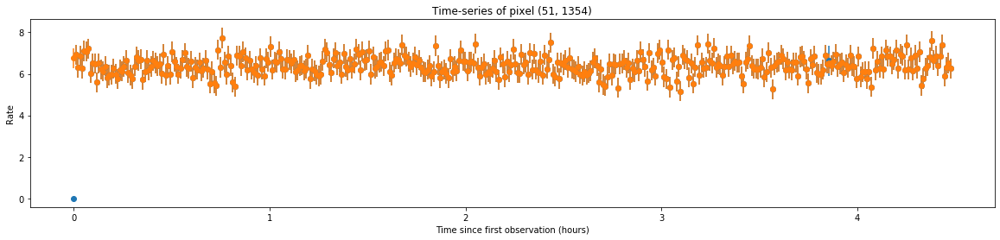

In [68]:
plt.figure(figsize=(20,4))

plt.title('Time-series of pixel (51, 1354)')
plt.errorbar((data_dictionary['times'] - data_dictionary['times'][0])*24, \
             images[:, 56, 1582], \
             error_images[:, 56, 1582], \
             fmt = 'o', label = 'Original')

plt.errorbar((data_dictionary['times'] - data_dictionary['times'][0])*24, \
             corrected_images[:, 56, 1582], \
             corrected_images_err[:, 56, 1582], \
             fmt = 'o', label = 'Corrected')

plt.ylabel('Rate')
plt.xlabel('Time since first observation (hours)')

It seemed to have worked!

Now, what do we do with the _**real**_ bad pixels in the DQ flags (i.e., those with data quality values larger or equal than 32)? Here, I opt not for correcting them, but for setting the values of all of those pixels to a constant in all integrations. The constant we take is just the median of all the pixels around the same columns as we used to correct the outliers above. We use DQ flags larger or equal than 32 to identify those bad pixels; we use only the DQ flags from the first integration to identify those really bad pixels:

In [69]:
for row in range(images.shape[1]):
    for column in range(images.shape[2]):
            
        # Don't mind pixels at the edges/close or at the reference pixel positions:
        if column > 5 and column < 2043:
            
            if dq_images[0, row, column] >= 32:
                
                # Estimate ratio of fluxes around the impacted column. Be careful if close to edges as to not touch the 
                # reference pixels:
                if column > 8 and column < 2040:
                    corrected_images[:, row, column] = np.median(corrected_images[:, row, column - 3:column + 3])
                    corrected_images_err[:, row, column] = np.median(corrected_images_err[:, row, column - 3:column + 3])
                    
                elif column <= 8:
                    corrected_images[:, row, column] = np.median(corrected_images[:, row, column:column + 6])
                    corrected_images_err[:, row, column] = np.median(corrected_images_err[:, row, column:column + 6])
                    
                elif column >= 2040:
                    corrected_images[:, row, column] = np.median(corrected_images[i, row, column - 6:column])
                    corrected_images_err[:, row, column] = np.median(corrected_images_err[i, row, column - 6:column])

The above presented procedure is simply a "patch" to those "really" bad pixels. It will of course impact the absolute flux, but it will not impact the relative fluxes, which are what we are interested in in our particular application here.

#### 3.3.4 Spectral extraction on cosmic-ray corrected images

Let's now perform spectral extraction on our cosmic-ray corrected images:

In [70]:
# Iterate through all integrations
for icounter in range(nintegrations):
    
    # Extract coefficients for order 1 and 2:
    coeff1, coeff2 = data_dictionary['traces']['coeffs1'][icounter], \
                     data_dictionary['traces']['coeffs2'][icounter]
    
    # Extract order 1 spectra:
    y1 = chebyshev.chebval(x1, coeff1)
    spectrum1 = aperture_extraction(corrected_images[icounter, :, :], \
                                    x1, y1, aperture_radius, \
                                    error_image=corrected_images_err[icounter, :, :])
        
    # Same for order 2:
    y2 = chebyshev.chebval(x2, coeff2)
    spectrum2 = aperture_extraction(corrected_images[icounter, :, :], \
                                    x2, y2, aperture_radius, \
                                    error_image=corrected_images_err[icounter, :, :])        
        
    # Save to data_dictinoary. If `order1_corrected` key not in the 'spectra' key, create it:
    if 'order1_corrected' not in data_dictionary['spectra'].keys():

        data_dictionary['spectra']['order1_corrected'] = []
        data_dictionary['spectra']['order2_corrected'] = []
            
    # Append extracted spectra
    data_dictionary['spectra']['order1_corrected'].append(np.copy(spectrum1))
    data_dictionary['spectra']['order2_corrected'].append(np.copy(spectrum2))    

All right, let's check the spectra on the first integration once again:

(0, 6000)

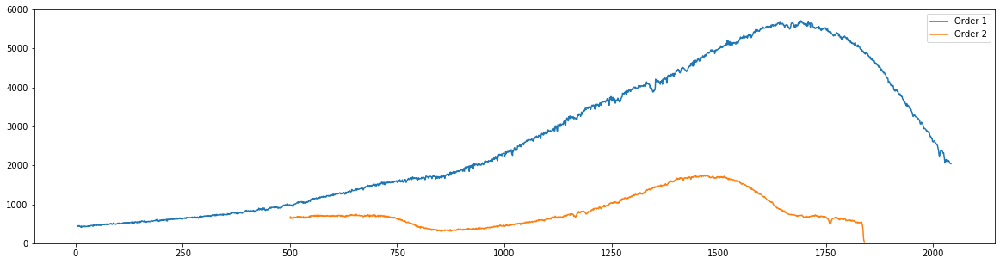

In [71]:
plt.figure(figsize=(20,5))
integration = 0
plt.plot(data_dictionary['spectra']['pixel1'], data_dictionary['spectra']['order1_corrected'][integration][0], label = 'Order 1')
plt.plot(data_dictionary['spectra']['pixel2'], data_dictionary['spectra']['order2_corrected'][integration][0], label = 'Order 2')
plt.legend()
plt.ylim(0,6000)

In [72]:
t4 = time.time()

Wow. That looks _much_ better! Let's try to get some lightcurve out of it?

In [73]:
s = np.array([])
s1 = np.array([])
for i in range(nintegrations):
    s = np.append(s, np.nansum(data_dictionary['spectra']['order1_corrected'][i][0]))
    s1 = np.append(s1, np.nansum(data_dictionary['spectra']['order1'][i][0]))

1655.3189975171656


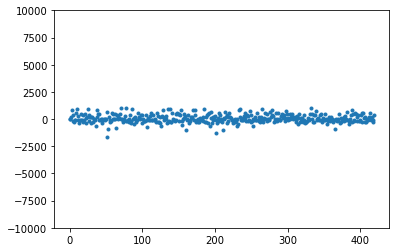

In [74]:
plt.plot((s/np.median(s) - 1.)*1e6,'.')
plt.ylim(-10000,10000)
mad_sigma = 1.4826 * np.median(np.abs(s - np.median(s)))
print(mad_sigma)

(-10000, 10000)

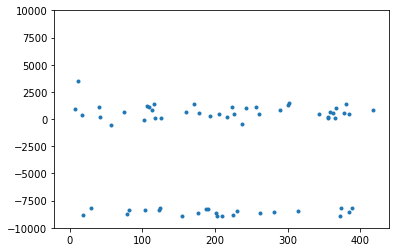

In [75]:
plt.plot((s1/np.median(s1) - 1.)*1e6,'.')
plt.ylim(-10000,10000)

In [76]:
print('Total, took:',t4-t0,'seconds')
print('Stage 1 took:',t1-t0,'seconds')
print('Stage 1, JUMP took:',tjump1-tjump0,'seconds')
print('Stage 1, RAMP took:',tramp1-tramp0,'seconds')
print('Stage 2 took:',t2-t1,'seconds')
print('Tracing took:',t3-t2,'seconds')
print('Extraction took:',t4-t3,'seconds')

Total, took: 19954.519416809082 seconds
Stage 1 took: 13452.756177902222 seconds
Stage 1, JUMP took: 1429.011647939682 seconds
Stage 1, RAMP took: 1936.0685312747955 seconds
Stage 2 took: 5464.177899122238 seconds
Tracing took: 239.31849694252014 seconds
Extraction took: 798.266842842102 seconds
